In [2]:
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import AxesGrid
import xarray as xr
import os
import numpy as np
import logging
import cmocean
import copy
pp_root_6_wave="/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave"
pp_root_uncou = "/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/"
ocean_daily_wave_1= xr.open_dataset(pp_root_uncou+"/19930101_results/19930101.ocean_daily.nc")
ocean_daily_wave_1

/vftmp/Qian.Xiao/pid2005190/ipykernel_2159655/2316831105.py:11: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ocean_daily_wave_1= xr.open_dataset(pp_root_uncou+"/19930101_results/19930101.ocean_daily.nc")


<xarray.Dataset> Size: 119GB
Dimensions:           (xh: 775, yh: 845, zl: 75, time: 181, nv: 2, xq: 776,
                       yq: 846)
Coordinates:
  * xh                (xh) float64 6kB -98.0 -97.92 -97.84 ... -36.16 -36.08
  * yh                (yh) float64 7kB 5.273 5.352 5.432 ... 51.9 51.91 51.93
  * zl                (zl) float64 600B 1.0 3.0 5.0 ... 6.125e+03 6.375e+03
  * time              (time) datetime64[ns] 1kB 1993-01-01T12:00:00 ... 1993-...
  * nv                (nv) float64 16B 1.0 2.0
  * xq                (xq) float64 6kB -98.04 -97.96 -97.88 ... -36.12 -36.04
  * yq                (yq) float64 7kB 5.233 5.312 5.392 ... 51.9 51.92 51.94
Data variables: (12/33)
    volcello          (time, zl, yh, xh) float32 36GB ...
    ssh               (time, yh, xh) float32 474MB ...
    sshmin            (time, yh, xh) float32 474MB ...
    sshmax            (time, yh, xh) float32 474MB ...
    tos               (time, yh, xh) float32 474MB ...
    tosmin            (time, yh, xh) float32 474MB ...
    ...                ...
    SW                (time, yh, xh) float32 474MB ...
    LW                (time, yh, xh) float32 474MB ...
    average_T1        (time) datetime64[ns] 1kB ...
    average_T2        (time) datetime64[ns] 1kB ...
    average_DT        (time) timedelta64[ns] 1kB ...
    time_bnds         (time, nv) datetime64[ns] 3kB ...
Attributes:
    NumFilesInSet:     1
    title:             CEFI_NWA12_COBALT_V1
    associated_files:  areacello: 19930101.ocean_static.nc
    grid_type:         regular
    grid_tile:         N/A

In [9]:
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import AxesGrid
import xarray as xr
import os
import numpy as np
import logging
import cmocean
import copy

cmocean.cm.balance
cmap = copy.copy(cmocean.cm.balance)
cmap.set_bad('gray')   
###first verage every year and then concate

pp_root_uncou = "/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/"
pp_root_uncou_LAfalse="/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou_LALTFalse/"
pp_root_12_all="/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_wave_all/"
pp_root_12_wave="/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_wave/"
pp_root_6_all="/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/"
pp_root_6_wave="/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/"
def read_and_extract_data(pp_root, data_list, variables):
    combined_data = {}
    summer_data = {}
    winter_data = {}

    for var_name in variables:
        datasets = []
        summer_data_list = []
        winter_data_list = []

        for file_path in data_list:
            file_path = os.path.join(pp_root, file_path)
            if os.path.exists(file_path):
                try:
                    ds = xr.open_dataset(file_path)
                    if var_name in ds:
                        yearly_mean=ds[var_name].mean(dim='time', skipna=True)
                        datasets.append(yearly_mean)

                        # Summer: June, July, August (JJA)
                        summer = ds.sel(time=ds['time'].dt.month.isin([6, 7, 8]))
                        if not summer[var_name].isnull().all():
                            summer_mean=summer[var_name].mean(dim='time', skipna=True)
                            summer_data_list.append(summer_mean)

                        # Winter: December, January, February (DJF)
                        winter = ds.sel(time=ds['time'].dt.month.isin([12, 1, 2]))
                        if not winter[var_name].isnull().all():
                            winter_mean=winter[var_name].mean(dim='time', skipna=True)
                            winter_data_list.append(winter_mean)

                    else:
                        print(f"Variable {var_name} not found in {file_path}")
                    ds.close()

                except Exception as e:
                    print(f"Error reading {file_path}: {e}")
            else:
                print(f"File not found: {file_path}")

        # Combine along time dimension after the loop finishes
        combined_data[var_name] = xr.concat(datasets, dim='time') if datasets else None
        summer_data[var_name] = xr.concat(summer_data_list, dim='time') if summer_data_list else None
        winter_data[var_name] = xr.concat(winter_data_list, dim='time') if winter_data_list else None

    return combined_data, summer_data, winter_data

def read_and_extract_data_weightedmean(pp_root, data_list, variables):
    combined_data = {}
    summer_data = {}
    winter_data = {}

    for var_name in variables:
        mean_sum = None
        count_sum = None
        summer_mean_sum = None
        summer_count_sum = None
        winter_mean_sum = None
        winter_count_sum = None

        for file_path in data_list:
            file_path = os.path.join(pp_root, file_path)
            if os.path.exists(file_path):
                try:
                    ds = xr.open_dataset(file_path)
                    if var_name in ds:
                        # Compute valid count (to weight the mean correctly)
                        count_valid = ds[var_name].notnull().sum(dim='time')
                        
                        if count_valid.sum() > 0:
                            yearly_mean = ds[var_name].sum(dim='time', skipna=True)
                            
                            if mean_sum is None:
                                mean_sum = yearly_mean
                                count_sum = count_valid
                            else:
                                mean_sum += yearly_mean
                                count_sum += count_valid

                        # Summer (JJA): June, July, August
                        summer = ds.sel(time=ds['time'].dt.month.isin([6, 7, 8]))
                        summer_count_valid = summer[var_name].notnull().sum(dim='time')
                        
                        if summer_count_valid.sum() > 0:
                            summer_mean = summer[var_name].sum(dim='time', skipna=True)
                            
                            if summer_mean_sum is None:
                                summer_mean_sum = summer_mean
                                summer_count_sum = summer_count_valid
                            else:
                                summer_mean_sum += summer_mean
                                summer_count_sum += summer_count_valid

                        # Winter (DJF): December, January, February
                        winter = ds.sel(time=ds['time'].dt.month.isin([12, 1, 2]))
                        winter_count_valid = winter[var_name].notnull().sum(dim='time')
                        
                        if winter_count_valid.sum() > 0:
                            winter_mean = winter[var_name].sum(dim='time', skipna=True)
                            
                            if winter_mean_sum is None:
                                winter_mean_sum = winter_mean
                                winter_count_sum = winter_count_valid
                            else:
                                winter_mean_sum += winter_mean
                                winter_count_sum += winter_count_valid

                    else:
                        print(f"Variable {var_name} not found in {file_path}")
                    
                    ds.close()

                except Exception as e:
                    print(f"Error reading {file_path}: {e}")
            else:
                print(f"File not found: {file_path}")

        # Compute final means
        combined_data[var_name] = mean_sum / count_sum if count_sum is not None else None
        summer_data[var_name] = summer_mean_sum / summer_count_sum if summer_count_sum is not None else None
        winter_data[var_name] = winter_mean_sum / winter_count_sum if winter_count_sum is not None else None

    return combined_data, summer_data, winter_data
One_D_list=[
    '19930101_results/19930101.ocean_daily.nc',
    '19940101_results/19940101.ocean_daily.nc',
    '19950101_results/19950101.ocean_daily.nc',
    '19960101_results/19960101.ocean_daily.nc',
    '19970101_results/19970101.ocean_daily.nc',
    '19980101_results/19980101.ocean_daily.nc',
    '19990101_results/19990101.ocean_daily.nc',
    '20000101_results/20000101.ocean_daily.nc',
    '20010101_results/20010101.ocean_daily.nc',
    '20020101_results/20020101.ocean_daily.nc',
    '20030101_results/20030101.ocean_daily.nc',
    '20040101_results/20040101.ocean_daily.nc',
    '20050101_results/20050101.ocean_daily.nc',
    '20060101_results/20060101.ocean_daily.nc',
    '20070101_results/20070101.ocean_daily.nc',
    '20080101_results/20080101.ocean_daily.nc',
    '20080701_results/20080701.ocean_daily.nc',    
    '20090101_results/20090101.ocean_daily.nc',
    '20090701_results/20090701.ocean_daily.nc',    
    '20100101_results/20100101.ocean_daily.nc',
    '20100701_results/20100701.ocean_daily.nc',
    '20110101_results/20110101.ocean_daily.nc',
    '20110701_results/20110701.ocean_daily.nc',
    '20120101_results/20120101.ocean_daily.nc',
    '20120701_results/20120701.ocean_daily.nc',
    '20130101_results/20130101.ocean_daily.nc',
    '20130701_results/20130701.ocean_daily.nc',
    '20140101_results/20140101.ocean_daily.nc',
    '20140701_results/20140701.ocean_daily.nc',
    '20150101_results/20150101.ocean_daily.nc',
    '20150701_results/20150701.ocean_daily.nc',
    '20160101_results/20160101.ocean_daily.nc',
    '20160701_results/20160701.ocean_daily.nc',
    '20170101_results/20170101.ocean_daily.nc',
    '20170701_results/20170701.ocean_daily.nc'
]
One_D_all_list=[
    '19930101_results/19930101.ocean_daily.nc',
    '19940101_results/19940101.ocean_daily.nc',
    '19950101_results/19950101.ocean_daily.nc',
    '19960101_results/19960101.ocean_daily.nc',
    '19970101_results/19970101.ocean_daily.nc',
    '19980101_results/19980101.ocean_daily.nc',
    '19990101_results/19990101.ocean_daily.nc',
    '20000101_results/20000101.ocean_daily.nc',
    '20010101_results/20010101.ocean_daily.nc',
    '20020101_results/20020101.ocean_daily.nc',
    '20030101_results/20030101.ocean_daily.nc',
    '20040101_results/20040101.ocean_daily.nc',
    '20050101_results/20050101.ocean_daily.nc',
    '20050701_results/20050701.ocean_daily.nc',
    '20060101_results/20060101.ocean_daily.nc',
    '20060701_results/20060701.ocean_daily.nc',
    '20070101_results/20070101.ocean_daily.nc',
    '20070701_results/20070701.ocean_daily.nc',
    '20080101_results/20080101.ocean_daily.nc',
    '20080701_results/20080701.ocean_daily.nc',    
    '20090101_results/20090101.ocean_daily.nc',
    '20090701_results/20090701.ocean_daily.nc',    
    '20100101_results/20100101.ocean_daily.nc',
    '20100701_results/20100701.ocean_daily.nc',
    '20110101_results/20110101.ocean_daily.nc',
    '20110701_results/20110701.ocean_daily.nc',
    '20120101_results/20120101.ocean_daily.nc',
    '20120701_results/20120701.ocean_daily.nc',
    '20130101_results/20130101.ocean_daily.nc',
    '20130701_results/20130701.ocean_daily.nc',
    '20140101_results/20140101.ocean_daily.nc',
    '20140701_results/20140701.ocean_daily.nc',
    '20150101_results/20150101.ocean_daily.nc',
    '20150701_results/20150701.ocean_daily.nc',
    '20160101_results/20160101.ocean_daily.nc',
    '20160701_results/20160701.ocean_daily.nc',
    '20170101_results/20170101.ocean_daily.nc',
    '20170701_results/20170701.ocean_daily.nc'
]
One_M_list=[
    '19930101_results/19930101.ocean_month.nc',
    '19940101_results/19940101.ocean_month.nc',
    '19950101_results/19950101.ocean_month.nc',
    '19960101_results/19960101.ocean_month.nc',
    '19970101_results/19970101.ocean_month.nc',
    '19980101_results/19980101.ocean_month.nc',
    '19990101_results/19990101.ocean_month.nc',
    '20000101_results/20000101.ocean_month.nc',
    '20010101_results/20010101.ocean_month.nc',
    '20020101_results/20020101.ocean_month.nc',
    '20030101_results/20030101.ocean_month.nc',
    '20040101_results/20040101.ocean_month.nc',
    '20050101_results/20050101.ocean_month.nc',
    '20060101_results/20060101.ocean_month.nc',
    '20070101_results/20070101.ocean_month.nc',
    '20080101_results/20080101.ocean_month.nc',
    '20080701_results/20080701.ocean_month.nc',    
    '20090101_results/20090101.ocean_month.nc',
    '20090701_results/20090701.ocean_month.nc',    
    '20100101_results/20100101.ocean_month.nc',
    '20100701_results/20100701.ocean_month.nc',
    '20110101_results/20110101.ocean_month.nc',
    '20110701_results/20110701.ocean_month.nc',
    '20120101_results/20120101.ocean_month.nc',
    '20120701_results/20120701.ocean_month.nc',
    '20130101_results/20130101.ocean_month.nc',
    '20130701_results/20130701.ocean_month.nc',
    '20140101_results/20140101.ocean_month.nc',
    '20140701_results/20140701.ocean_month.nc',
    '20150101_results/20150101.ocean_month.nc',
    '20150701_results/20150701.ocean_month.nc',
    '20160101_results/20160101.ocean_month.nc',
    '20160701_results/20160701.ocean_month.nc',
    '20170101_results/20170101.ocean_month.nc',
    '20170701_results/20170701.ocean_month.nc', 
]
One_M_all_list=[
    '19930101_results/19930101.ocean_month.nc',
    '19940101_results/19940101.ocean_month.nc',
    '19950101_results/19950101.ocean_month.nc',
    '19960101_results/19960101.ocean_month.nc',
    '19970101_results/19970101.ocean_month.nc',
    '19980101_results/19980101.ocean_month.nc',
    '19990101_results/19990101.ocean_month.nc',
    '20000101_results/20000101.ocean_month.nc',
    '20010101_results/20010101.ocean_month.nc',
    '20020101_results/20020101.ocean_month.nc',
    '20030101_results/20030101.ocean_month.nc',
    '20040101_results/20040101.ocean_month.nc',
    '20050101_results/20050101.ocean_month.nc',
    '20050701_results/20050701.ocean_month.nc',
    '20060101_results/20060101.ocean_month.nc',
    '20060701_results/20060701.ocean_month.nc',
    '20070101_results/20070101.ocean_month.nc',
    '20070701_results/20070701.ocean_month.nc',
    '20080101_results/20080101.ocean_month.nc',
    '20080701_results/20080701.ocean_month.nc',    
    '20090101_results/20090101.ocean_month.nc',
    '20090701_results/20090701.ocean_month.nc',    
    '20100101_results/20100101.ocean_month.nc',
    '20100701_results/20100701.ocean_month.nc',
    '20110101_results/20110101.ocean_month.nc',
    '20110701_results/20110701.ocean_month.nc',
    '20120101_results/20120101.ocean_month.nc',
    '20120701_results/20120701.ocean_month.nc',
    '20130101_results/20130101.ocean_month.nc',
    '20130701_results/20130701.ocean_month.nc',
    '20140101_results/20140101.ocean_month.nc',
    '20140701_results/20140701.ocean_month.nc',
    '20150101_results/20150101.ocean_month.nc',
    '20150701_results/20150701.ocean_month.nc',
    '20160101_results/20160101.ocean_month.nc',
    '20160701_results/20160701.ocean_month.nc',
    '20170101_results/20170101.ocean_month.nc',
    '20170701_results/20170701.ocean_month.nc'
]


Ddata_list = [
    '19930101_results/19930101.ocean_daily.nc',
    '19930701_results/19930701.ocean_daily.nc',
    '19940101_results/19940101.ocean_daily.nc',
    '19940701_results/19940701.ocean_daily.nc',
    '19950101_results/19950101.ocean_daily.nc',
    '19950701_results/19950701.ocean_daily.nc',
    '19960101_results/19960101.ocean_daily.nc',
    '19970101_results/19970101.ocean_daily.nc',
    '19980101_results/19980101.ocean_daily.nc',
    '19990101_results/19990101.ocean_daily.nc',
    '20000101_results/20000101.ocean_daily.nc',
    '20010101_results/20010101.ocean_daily.nc',
    '20020101_results/20020101.ocean_daily.nc',
    '20030101_results/20030101.ocean_daily.nc',
    '20040101_results/20040101.ocean_daily.nc',
    '20050101_results/20050101.ocean_daily.nc',
    '20060101_results/20060101.ocean_daily.nc',
    '20070101_results/20070101.ocean_daily.nc',
    '20080101_results/20080101.ocean_daily.nc',
    '20090101_results/20090101.ocean_daily.nc',
    '20100101_results/20100101.ocean_daily.nc',
    '20110101_results/20110101.ocean_daily.nc',
    '20120101_results/20120101.ocean_daily.nc',
    '20130101_results/20130101.ocean_daily.nc',
    '20140101_results/20140101.ocean_daily.nc',
    '20150101_results/20150101.ocean_daily.nc',
    '20160101_results/20160101.ocean_daily.nc',
    '20170101_results/20170101.ocean_daily.nc',
    '20180101_results/20180101.ocean_daily.nc',
    '20190101_results/20190101.ocean_daily.nc',
    '20200101_results/20200101.ocean_daily.nc',
    '20210101_results/20210101.ocean_daily.nc',
    '20220101_results/20220101.ocean_daily.nc',

]

Mdata_list = [
    '19930101_results/19930101.ocean_month.nc',
    '19930701_results/19930701.ocean_month.nc',
    '19940101_results/19940101.ocean_month.nc',
    '19940701_results/19940701.ocean_month.nc',
    '19950101_results/19950101.ocean_month.nc',
    '19950701_results/19950701.ocean_month.nc',
    '19960101_results/19960101.ocean_month.nc',
    '19970101_results/19970101.ocean_month.nc',
    '19980101_results/19980101.ocean_month.nc',
    '19990101_results/19990101.ocean_month.nc',
    '20000101_results/20000101.ocean_month.nc',
    '20010101_results/20010101.ocean_month.nc',
    '20020101_results/20020101.ocean_month.nc',
    '20030101_results/20030101.ocean_month.nc',
    '20040101_results/20040101.ocean_month.nc',
    '20050101_results/20050101.ocean_month.nc',
    '20060101_results/20060101.ocean_month.nc',
    '20070101_results/20070101.ocean_month.nc',
    '20080101_results/20080101.ocean_month.nc',
    '20090101_results/20090101.ocean_month.nc',
    '20100101_results/20100101.ocean_month.nc',
    '20110101_results/20110101.ocean_month.nc',
    '20120101_results/20120101.ocean_month.nc',
    '20130101_results/20130101.ocean_month.nc',
    '20140101_results/20140101.ocean_month.nc',
    '20150101_results/20150101.ocean_month.nc',
    '20160101_results/20160101.ocean_month.nc',
    '20170101_results/20170101.ocean_month.nc',
    '20180101_results/20180101.ocean_month.nc',
    '20190101_results/20190101.ocean_month.nc',
    '20200101_results/20200101.ocean_month.nc',
    '20210101_results/20210101.ocean_month.nc',
    '20220101_results/20220101.ocean_month.nc',

]
WMdata_list = [
    '19930101_results/19930101.ocean_month.nc',
    '19930701_results/19930701.ocean_month.nc',
    '19940101_results/19940101.ocean_month.nc',
    '19940701_results/19940701.ocean_month.nc',
    '19950101_results/19950101.ocean_month.nc',
    '19950701_results/19950701.ocean_month.nc',
    '19960101_results/19960101.ocean_month.nc',
    '19960701_results/19960701.ocean_month.nc',
    '19970101_results/19970101.ocean_month.nc',
    '19970701_results/19970701.ocean_month.nc',
    '19980101_results/19980101.ocean_month.nc',
    '19980701_results/19980701.ocean_month.nc',
    '19990101_results/19990101.ocean_month.nc',
    '19990701_results/19990701.ocean_month.nc',
    '20000101_results/20000101.ocean_month.nc',
    '20000701_results/20000701.ocean_month.nc',
    '20010101_results/20010101.ocean_month.nc',
    '20010701_results/20010701.ocean_month.nc',
    '20020101_results/20020101.ocean_month.nc',
    '20020701_results/20020701.ocean_month.nc',
    '20030101_results/20030101.ocean_month.nc',
    '20030701_results/20030701.ocean_month.nc',
    '20040101_results/20040101.ocean_month.nc',
    '20040701_results/20040701.ocean_month.nc',
    '20050101_results/20050101.ocean_month.nc',
    '20050701_results/20050701.ocean_month.nc',
    '20060101_results/20060101.ocean_month.nc',
    '20060701_results/20060701.ocean_month.nc',
    '20070101_results/20070101.ocean_month.nc',
    '20070701_results/20070701.ocean_month.nc',
    '20080101_results/20080101.ocean_month.nc',
    '20080701_results/20080701.ocean_month.nc',
    '20090101_results/20090101.ocean_month.nc',
    '20090701_results/20090701.ocean_month.nc',
    '20100101_results/20100101.ocean_month.nc',
    '20100701_results/20100701.ocean_month.nc',
    '20110101_results/20110101.ocean_month.nc',
    '20110701_results/20110701.ocean_month.nc',
    '20120101_results/20120101.ocean_month.nc',
    '20120701_results/20120701.ocean_month.nc',
    '20130101_results/20130101.ocean_month.nc',
    '20130701_results/20130701.ocean_month.nc',
    '20140101_results/20140101.ocean_month.nc',
    '20140701_results/20140701.ocean_month.nc',
    '20150101_results/20150101.ocean_month.nc',
    '20150701_results/20150701.ocean_month.nc',
    '20160101_results/20160101.ocean_month.nc',
    '20160701_results/20160701.ocean_month.nc',
    '20170101_results/20170101.ocean_month.nc',
    '20170701_results/20170701.ocean_month.nc',
    '20180101_results/20180101.ocean_month.nc',
    '20180701_results/20180701.ocean_month.nc',
    '20190101_results/20190101.ocean_month.nc',
    '20190701_results/20190701.ocean_month.nc',
    '20200101_results/20200101.ocean_month.nc',
    '20200701_results/20200701.ocean_month.nc',
    '20210101_results/20210101.ocean_month.nc',
    '20210701_results/20210701.ocean_month.nc',
    '20220101_results/20220101.ocean_month.nc',
    '20220701_results/20220701.ocean_month.nc',
]

WDdata_list = [
    '19930101_results/19930101.ocean_daily.nc',
    '19930701_results/19930701.ocean_daily.nc',
    '19940101_results/19940101.ocean_daily.nc',
    '19940701_results/19940701.ocean_daily.nc',
    '19950101_results/19950101.ocean_daily.nc',
    '19950701_results/19950701.ocean_daily.nc',
    '19960101_results/19960101.ocean_daily.nc',
    '19960701_results/19960701.ocean_daily.nc',
    '19970101_results/19970101.ocean_daily.nc',
    '19970701_results/19970701.ocean_daily.nc',
    '19980101_results/19980101.ocean_daily.nc',
    '19980701_results/19980701.ocean_daily.nc',
    '19990101_results/19990101.ocean_daily.nc',
    '19990701_results/19990701.ocean_daily.nc',
    '20000101_results/20000101.ocean_daily.nc',
    '20000701_results/20000701.ocean_daily.nc',
    '20010101_results/20010101.ocean_daily.nc',
    '20010701_results/20010701.ocean_daily.nc',
    '20020101_results/20020101.ocean_daily.nc',
    '20020701_results/20020701.ocean_daily.nc',
    '20030101_results/20030101.ocean_daily.nc',
    '20030701_results/20030701.ocean_daily.nc',
    '20040101_results/20040101.ocean_daily.nc',
    '20040701_results/20040701.ocean_daily.nc',
    '20050101_results/20050101.ocean_daily.nc',
    '20050701_results/20050701.ocean_daily.nc',
    '20060101_results/20060101.ocean_daily.nc',
    '20060701_results/20060701.ocean_daily.nc',
    '20070101_results/20070101.ocean_daily.nc',
    '20070701_results/20070701.ocean_daily.nc',
    '20080101_results/20080101.ocean_daily.nc',
    '20080701_results/20080701.ocean_daily.nc',
    '20090101_results/20090101.ocean_daily.nc',
    '20090701_results/20090701.ocean_daily.nc',
    '20100101_results/20100101.ocean_daily.nc',
    '20100701_results/20100701.ocean_daily.nc',
    '20110101_results/20110101.ocean_daily.nc',
    '20110701_results/20110701.ocean_daily.nc',
    '20120101_results/20120101.ocean_daily.nc',
    '20120701_results/20120701.ocean_daily.nc',
    '20130101_results/20130101.ocean_daily.nc',
    '20130701_results/20130701.ocean_daily.nc',
    '20140101_results/20140101.ocean_daily.nc',
    '20140701_results/20140701.ocean_daily.nc',
    '20150101_results/20150101.ocean_daily.nc',
    '20150701_results/20150701.ocean_daily.nc',
    '20160101_results/20160101.ocean_daily.nc',
    '20160701_results/20160701.ocean_daily.nc',
    '20170101_results/20170101.ocean_daily.nc',
    '20170701_results/20170701.ocean_daily.nc',
    '20180101_results/20180101.ocean_daily.nc',
    '20180701_results/20180701.ocean_daily.nc',
    '20190101_results/20190101.ocean_daily.nc',
    '20190701_results/20190701.ocean_daily.nc',
    '20200101_results/20200101.ocean_daily.nc',
    '20200701_results/20200701.ocean_daily.nc',
    '20210101_results/20210101.ocean_daily.nc',
    '20210701_results/20210701.ocean_daily.nc',
    '20220101_results/20220101.ocean_daily.nc',
    '20220701_results/20220701.ocean_daily.nc',
]

variables_month = ['ssh','speed','MLD_EN1','LA','LA_MOD','MSTAR_LT','La_turbulent','surface_stokes_x','surface_stokes_y']
# variables_month = ['MSTAR_LT']
variables_daily = ['SST']

Dcombined_data_uncou, Dsummer_data_uncou, Dwinter_data_uncou = read_and_extract_data_weightedmean(pp_root_uncou, Ddata_list, variables_daily)
Mcombined_data_uncou, Msummer_data_uncou, Mwinter_data_uncou = read_and_extract_data_weightedmean(pp_root_uncou, Mdata_list, variables_month)

Dcombined_data_6_wave, Dsummer_data_6_wave, Dwinter_data_6_wave = read_and_extract_data_weightedmean(pp_root_6_wave, WDdata_list, variables_daily)
combined_data_6_wave, summer_data_6_wave, winter_data_6_wave = read_and_extract_data_weightedmean(pp_root_6_wave, WMdata_list, variables_month)

Dcombined_data_6_all, Dsummer_data_6_all, Dwinter_data_6_all = read_and_extract_data(pp_root_6_all, WDdata_list, variables_daily)
combined_data_6_all, summer_data_6_all, winter_data_6_all = read_and_extract_data_weightedmean(pp_root_6_all, WMdata_list, variables_month)


ocean_daily_uncou_1= xr.open_dataset(pp_root_uncou+"/19930101_results/19930101.ocean_daily.nc")
model_grid_x = ocean_daily_uncou_1.variables['xh']
model_grid_y = ocean_daily_uncou_1.variables['yh']



/vftmp/Qian.Xiao/pid1887975/ipykernel_1890312/2679567204.py:85: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)
/vftmp/Qian.Xiao/pid1887975/ipykernel_1890312/2679567204.py:85: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)
/vftmp/Qian.Xiao/pid1887975/ipykernel_1890312/2679567204.py:85: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)
/vftmp/Qian.Xiao/pid1887975/ipykernel_1890312/2679567204.py:85: FutureWarning: In a future version of xarray dec

Variable LA not found in /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/19930101_results/19930101.ocean_month.nc


/vftmp/Qian.Xiao/pid1887975/ipykernel_1890312/2679567204.py:85: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)
/vftmp/Qian.Xiao/pid1887975/ipykernel_1890312/2679567204.py:85: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)
/vftmp/Qian.Xiao/pid1887975/ipykernel_1890312/2679567204.py:85: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)
/vftmp/Qian.Xiao/pid1887975/ipykernel_1890312/2679567204.py:85: FutureWarning: In a future version of xarray dec

Variable LA not found in /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/19930701_results/19930701.ocean_month.nc
Variable LA not found in /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/19940101_results/19940101.ocean_month.nc
Variable LA not found in /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/19940701_results/19940701.ocean_month.nc
Variable LA not found in /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/19950101_results/19950101.ocean_month.nc
Variable LA not found in /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/19950701_results/19950701.ocean_month.nc
Variable LA not found in /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/19960101_results/19960101.ocean_month.nc
Variable LA not found in /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTunco

/vftmp/Qian.Xiao/pid1887975/ipykernel_1890312/2679567204.py:85: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)
/vftmp/Qian.Xiao/pid1887975/ipykernel_1890312/2679567204.py:85: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)
/vftmp/Qian.Xiao/pid1887975/ipykernel_1890312/2679567204.py:85: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)
/vftmp/Qian.Xiao/pid1887975/ipykernel_1890312/2679567204.py:85: FutureWarning: In a future version of xarray dec

Variable LA_MOD not found in /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/19930101_results/19930101.ocean_month.nc
Variable LA_MOD not found in /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/19930701_results/19930701.ocean_month.nc
Variable LA_MOD not found in /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/19940101_results/19940101.ocean_month.nc
Variable LA_MOD not found in /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/19940701_results/19940701.ocean_month.nc
Variable LA_MOD not found in /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/19950101_results/19950101.ocean_month.nc
Variable LA_MOD not found in /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/19950701_results/19950701.ocean_month.nc
Variable LA_MOD not found in /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/pos

/vftmp/Qian.Xiao/pid1887975/ipykernel_1890312/2679567204.py:85: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)
/vftmp/Qian.Xiao/pid1887975/ipykernel_1890312/2679567204.py:85: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Variable LA_MOD not found in /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/20030101_results/20030101.ocean_month.nc


/vftmp/Qian.Xiao/pid1887975/ipykernel_1890312/2679567204.py:85: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)
/vftmp/Qian.Xiao/pid1887975/ipykernel_1890312/2679567204.py:85: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)
/vftmp/Qian.Xiao/pid1887975/ipykernel_1890312/2679567204.py:85: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)
/vftmp/Qian.Xiao/pid1887975/ipykernel_1890312/2679567204.py:85: FutureWarning: In a future version of xarray dec

Variable MSTAR_LT not found in /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/19930101_results/19930101.ocean_month.nc
Variable MSTAR_LT not found in /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/19930701_results/19930701.ocean_month.nc
Variable MSTAR_LT not found in /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/19940101_results/19940101.ocean_month.nc
Variable MSTAR_LT not found in /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/19940701_results/19940701.ocean_month.nc
Variable MSTAR_LT not found in /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/19950101_results/19950101.ocean_month.nc
Variable MSTAR_LT not found in /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/19950701_results/19950701.ocean_month.nc
Variable MSTAR_LT not found in /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_C

/vftmp/Qian.Xiao/pid1887975/ipykernel_1890312/2679567204.py:85: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)
/vftmp/Qian.Xiao/pid1887975/ipykernel_1890312/2679567204.py:85: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)
/vftmp/Qian.Xiao/pid1887975/ipykernel_1890312/2679567204.py:85: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)
/vftmp/Qian.Xiao/pid1887975/ipykernel_1890312/2679567204.py:85: FutureWarning: In a future version of xarray dec

Variable MSTAR_LT not found in /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/20020101_results/20020101.ocean_month.nc
Variable MSTAR_LT not found in /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/20030101_results/20030101.ocean_month.nc


/vftmp/Qian.Xiao/pid1887975/ipykernel_1890312/2679567204.py:85: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)
/vftmp/Qian.Xiao/pid1887975/ipykernel_1890312/2679567204.py:85: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)
/vftmp/Qian.Xiao/pid1887975/ipykernel_1890312/2679567204.py:85: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)
/vftmp/Qian.Xiao/pid1887975/ipykernel_1890312/2679567204.py:85: FutureWarning: In a future version of xarray dec

Variable La_turbulent not found in /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/19930101_results/19930101.ocean_month.nc
Variable La_turbulent not found in /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/19930701_results/19930701.ocean_month.nc
Variable La_turbulent not found in /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/19940101_results/19940101.ocean_month.nc
Variable La_turbulent not found in /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/19940701_results/19940701.ocean_month.nc
Variable La_turbulent not found in /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/19950101_results/19950101.ocean_month.nc
Variable La_turbulent not found in /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/19950701_results/19950701.ocean_month.nc
Variable La_turbulent not found in /archive/Qi

/vftmp/Qian.Xiao/pid1887975/ipykernel_1890312/2679567204.py:85: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)
/vftmp/Qian.Xiao/pid1887975/ipykernel_1890312/2679567204.py:85: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)
/vftmp/Qian.Xiao/pid1887975/ipykernel_1890312/2679567204.py:85: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)
/vftmp/Qian.Xiao/pid1887975/ipykernel_1890312/2679567204.py:85: FutureWarning: In a future version of xarray dec

Variable La_turbulent not found in /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/20030101_results/20030101.ocean_month.nc
Variable La_turbulent not found in /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/20040101_results/20040101.ocean_month.nc
Variable La_turbulent not found in /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/20050101_results/20050101.ocean_month.nc
Variable La_turbulent not found in /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/20060101_results/20060101.ocean_month.nc
Variable La_turbulent not found in /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/20070101_results/20070101.ocean_month.nc
Variable La_turbulent not found in /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/20080101_results/20080101.ocean_month.nc
Variable La_turbulent not found in /archive/Qi

/vftmp/Qian.Xiao/pid1887975/ipykernel_1890312/2679567204.py:85: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)
/vftmp/Qian.Xiao/pid1887975/ipykernel_1890312/2679567204.py:85: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)
/vftmp/Qian.Xiao/pid1887975/ipykernel_1890312/2679567204.py:85: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)
/vftmp/Qian.Xiao/pid1887975/ipykernel_1890312/2679567204.py:85: FutureWarning: In a future version of xarray dec

Variable La_turbulent not found in /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/20150101_results/20150101.ocean_month.nc
Variable La_turbulent not found in /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/20160101_results/20160101.ocean_month.nc
Variable La_turbulent not found in /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/20170101_results/20170101.ocean_month.nc
Variable La_turbulent not found in /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/20180101_results/20180101.ocean_month.nc
Variable La_turbulent not found in /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/20190101_results/20190101.ocean_month.nc
Variable La_turbulent not found in /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/20200101_results/20200101.ocean_month.nc
Variable La_turbulent not found in /archive/Qi

/vftmp/Qian.Xiao/pid1887975/ipykernel_1890312/2679567204.py:85: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)
/vftmp/Qian.Xiao/pid1887975/ipykernel_1890312/2679567204.py:85: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)
/vftmp/Qian.Xiao/pid1887975/ipykernel_1890312/2679567204.py:85: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)
/vftmp/Qian.Xiao/pid1887975/ipykernel_1890312/2679567204.py:85: FutureWarning: In a future version of xarray dec

Variable surface_stokes_x not found in /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/19950101_results/19950101.ocean_month.nc
Variable surface_stokes_x not found in /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/19950701_results/19950701.ocean_month.nc
Variable surface_stokes_x not found in /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/19960101_results/19960101.ocean_month.nc
Variable surface_stokes_x not found in /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/19970101_results/19970101.ocean_month.nc
Variable surface_stokes_x not found in /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/19980101_results/19980101.ocean_month.nc
Variable surface_stokes_x not found in /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/19990101_results/19990101.ocean_month.nc
Variable surface_stoke

/vftmp/Qian.Xiao/pid1887975/ipykernel_1890312/2679567204.py:85: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)
/vftmp/Qian.Xiao/pid1887975/ipykernel_1890312/2679567204.py:85: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)
/vftmp/Qian.Xiao/pid1887975/ipykernel_1890312/2679567204.py:85: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)
/vftmp/Qian.Xiao/pid1887975/ipykernel_1890312/2679567204.py:85: FutureWarning: In a future version of xarray dec

Variable surface_stokes_x not found in /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/20070101_results/20070101.ocean_month.nc
Variable surface_stokes_x not found in /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/20080101_results/20080101.ocean_month.nc
Variable surface_stokes_x not found in /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/20090101_results/20090101.ocean_month.nc
Variable surface_stokes_x not found in /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/20100101_results/20100101.ocean_month.nc
Variable surface_stokes_x not found in /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/20110101_results/20110101.ocean_month.nc
Variable surface_stokes_x not found in /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/20120101_results/20120101.ocean_month.nc
Variable surface_stoke

/vftmp/Qian.Xiao/pid1887975/ipykernel_1890312/2679567204.py:85: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)
/vftmp/Qian.Xiao/pid1887975/ipykernel_1890312/2679567204.py:85: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)
/vftmp/Qian.Xiao/pid1887975/ipykernel_1890312/2679567204.py:85: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)
/vftmp/Qian.Xiao/pid1887975/ipykernel_1890312/2679567204.py:85: FutureWarning: In a future version of xarray dec

Variable surface_stokes_x not found in /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/20190101_results/20190101.ocean_month.nc
Variable surface_stokes_x not found in /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/20200101_results/20200101.ocean_month.nc
Variable surface_stokes_x not found in /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/20210101_results/20210101.ocean_month.nc
Variable surface_stokes_x not found in /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/20220101_results/20220101.ocean_month.nc
Variable surface_stokes_y not found in /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/19930101_results/19930101.ocean_month.nc
Variable surface_stokes_y not found in /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/19930701_results/19930701.ocean_month.nc
Variable surface_stoke

/vftmp/Qian.Xiao/pid1887975/ipykernel_1890312/2679567204.py:85: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)
/vftmp/Qian.Xiao/pid1887975/ipykernel_1890312/2679567204.py:85: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)
/vftmp/Qian.Xiao/pid1887975/ipykernel_1890312/2679567204.py:85: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)
/vftmp/Qian.Xiao/pid1887975/ipykernel_1890312/2679567204.py:85: FutureWarning: In a future version of xarray dec

Variable surface_stokes_y not found in /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/19990101_results/19990101.ocean_month.nc
Variable surface_stokes_y not found in /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/20000101_results/20000101.ocean_month.nc
Variable surface_stokes_y not found in /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/20010101_results/20010101.ocean_month.nc
Variable surface_stokes_y not found in /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/20020101_results/20020101.ocean_month.nc
Variable surface_stokes_y not found in /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/20030101_results/20030101.ocean_month.nc
Variable surface_stokes_y not found in /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/20040101_results/20040101.ocean_month.nc
Variable surface_stoke

/vftmp/Qian.Xiao/pid1887975/ipykernel_1890312/2679567204.py:85: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)
/vftmp/Qian.Xiao/pid1887975/ipykernel_1890312/2679567204.py:85: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)
/vftmp/Qian.Xiao/pid1887975/ipykernel_1890312/2679567204.py:85: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)
/vftmp/Qian.Xiao/pid1887975/ipykernel_1890312/2679567204.py:85: FutureWarning: In a future version of xarray dec

Variable surface_stokes_y not found in /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/20110101_results/20110101.ocean_month.nc
Variable surface_stokes_y not found in /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/20120101_results/20120101.ocean_month.nc
Variable surface_stokes_y not found in /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/20130101_results/20130101.ocean_month.nc
Variable surface_stokes_y not found in /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/20140101_results/20140101.ocean_month.nc
Variable surface_stokes_y not found in /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/20150101_results/20150101.ocean_month.nc
Variable surface_stokes_y not found in /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/20160101_results/20160101.ocean_month.nc
Variable surface_stoke

/vftmp/Qian.Xiao/pid1887975/ipykernel_1890312/2679567204.py:85: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)
/vftmp/Qian.Xiao/pid1887975/ipykernel_1890312/2679567204.py:85: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)
/vftmp/Qian.Xiao/pid1887975/ipykernel_1890312/2679567204.py:85: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)
/vftmp/Qian.Xiao/pid1887975/ipykernel_1890312/2679567204.py:85: FutureWarning: In a future version of xarray dec

In [ ]:
variables_LA = ['LA','LA_MOD','La_turbulent','MSTAR_LT']
LA_data_uncou, LA_summer_uncou, LA_winter_uncou = read_and_extract_data(pp_root_uncou, Mdata_list, variables_LA)
# LA_data_uncou_LAfalse, LA_summer_uncou_LAfalse, LA_winter_uncou_LAfalse = read_and_extract_data(pp_root_uncou_LAfalse, data_list, variables_LA)


In [ ]:
def save_combined_data(variables, combined_data_dict, summer_combined_dict, winter_combined_dict,root):
    for var_name in variables:
        try:
            # Access the combined data for this variable
            combined = combined_data_dict.get(var_name)
            summer_combined = summer_combined_dict.get(var_name)
            winter_combined = winter_combined_dict.get(var_name)
            

            # Save compressed files
            if combined is not None:
                
                output_path = os.path.join(output_dir, f'combined_data_{var_name}_{root}.nc')
                combined.to_netcdf(output_path, encoding={var_name: {'zlib': True, 'complevel': 5}})
                print(f"Saved combined data for {var_name}_{root} to {output_path}")
               
                

            if summer_combined is not None:
                output_path = os.path.join(output_dir, f'summer_data_{var_name}_{root}.nc')
                summer_combined.to_netcdf(output_path, encoding={var_name: {'zlib': True, 'complevel': 5}})
                print(f"Saved summer combined data for {var_name}_{root} to {output_path}")

            if winter_combined is not None:
                output_path = os.path.join(output_dir, f'winter_data_{var_name}_{root}.nc')
                winter_combined.to_netcdf(output_path, encoding={var_name: {'zlib': True, 'complevel': 5}})
                print(f"Saved winter combined data for {var_name}_{root} to {output_path}")

        except Exception as e:
            print(f"Error saving data for {var_name}_{root} to {output_path}: {e}")

# Example usage
save_combined_data(variables, combined_data_uncou, summer_data_uncou, winter_data_uncou,'uncou_ave',pp_root_uncou)
save_combined_data(variables, combined_data_uncou_LAfalse, summer_data_uncou_LAfalse, winter_data_uncou_LAfalse,'uncou_LAfalse_ave',pp_root_uncou_LAfalse)






In [ ]:
variables_LA = ['time','LA','LA_MOD','La_turbulent','MSTAR_LT']
LA_data_uncou, LA_summer_uncou, LA_winter_uncou = read_and_extract_data(pp_root_uncou, data_list, variables_LA)
LA_data_uncou_LAfalse, LA_summer_uncou_LAfalse, LA_winter_uncou_LAfalse = read_and_extract_data(pp_root_uncou_LAfalse, data_list, variables_LA)


In [11]:
Dcombined_data_6_all

{'SST': <xarray.DataArray 'SST' (time: 60, yh: 845, xh: 775)> Size: 157MB
 array([[[       nan,        nan,        nan, ..., 27.069878 ,
          27.077566 , 27.088022 ],
         [       nan,        nan,        nan, ..., 27.060184 ,
          27.067371 , 27.076105 ],
         [       nan,        nan,        nan, ..., 27.046642 ,
          27.05345  , 27.060955 ],
         ...,
         [       nan,        nan,        nan, ...,  4.187763 ,
           4.1956067,  4.189686 ],
         [       nan,        nan,        nan, ...,  4.1748443,
           4.1924806,  4.19533  ],
         [       nan,        nan,        nan, ...,  4.1583705,
           4.1793704,  4.184391 ]],
 
        [[       nan,        nan,        nan, ..., 27.943121 ,
          27.931704 , 27.917332 ],
         [       nan,        nan,        nan, ..., 27.965612 ,
          27.953442 , 27.9349   ],
         [       nan,        nan,        nan, ..., 27.978674 ,
          27.964634 , 27.9466   ],
 ...
         [       nan, 

In [6]:
# Example usage


SST_uncou_ave= Dcombined_data_uncou['SST'].mean(dim='time', skipna=True)
SST_summer_uncou_ave= Dsummer_data_uncou['SST'].mean(dim='time', skipna=True)
SST_winter_uncou_ave= Dwinter_data_uncou['SST'].mean(dim='time', skipna=True)

SST_6_all_ave= Dcombined_data_6_all['SST'].mean(dim='time', skipna=True)
SST_summer_6_all_ave= Dsummer_data_6_all['SST'].mean(dim='time', skipna=True)
SST_winter_6_all_ave= Dwinter_data_6_all['SST'].mean(dim='time', skipna=True)

SST_6_wave_ave= Dcombined_data_6_wave['SST'].mean(dim='time', skipna=True)
SST_summer_6_wave_ave= Dsummer_data_6_wave['SST'].mean(dim='time', skipna=True)
SST_winter_6_wave_ave= Dwinter_data_6_wave['SST'].mean(dim='time', skipna=True)

diff_SST_uncou_ave=SST_6_wave_ave - SST_uncou_ave
diff_SST_all_ave=SST_6_all_ave-SST_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, SST_6_all_ave , cmap=cmap, shading='auto')
axes[0].set_title('30 years SST CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, SST_6_wave_ave, cmap=cmap, shading='auto')
axes[1].set_title('SST LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, SST_uncou_ave, cmap=cmap, shading='auto')
axes[2].set_title('SST LT uncou')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
axes[0].axvline(x=-68, color='red', linestyle='--')  # Vertical line
axes[0].axhline(y=38.5, color='blue', linestyle='--')  # Horizontal line

axes[1].axvline(x=-68, color='red', linestyle='--')
axes[1].axhline(y=38.5, color='blue', linestyle='--')

axes[2].axvline(x=-68, color='red', linestyle='--')
axes[2].axhline(y=38.5, color='blue', linestyle='--')
# Show the plot
points = [(-45, 10), (-52, 26), (-53, 35), (-55,41)]  # Example points

for ax in axes:  # Loop over each subplot
    for lon, lat in points:
        ax.scatter(lon, lat, color='red', marker='o', s=100)  # Plot the point
        ax.text(lon + 0.5, lat, f'({lon}, {lat})', fontsize=10, color='black')  # Add label
# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_SST_all_ave , cmap=cmap, shading='auto',vmin=-1,vmax=1)
axes[0].set_title('30 years SST CL+LT - LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_SST_uncou_ave, cmap=cmap, shading='auto',vmin=-1,vmax=1)
axes[1].set_title('SST LT wave - LT uncou')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
axes[0].axvline(x=-68, color='red', linestyle='--')  # Vertical line
axes[0].axhline(y=38.5, color='blue', linestyle='--')  # Horizontal line

axes[1].axvline(x=-68, color='red', linestyle='--')
axes[1].axhline(y=38.5, color='blue', linestyle='--')
points = [(-45, 10), (-52, 26), (-53, 35), (-55,41)]  # Example points

for ax in axes:  # Loop over each subplot
    for lon, lat in points:
        ax.scatter(lon, lat, color='red', marker='o', s=100)  # Plot the point
        ax.text(lon + 0.5, lat, f'({lon}, {lat})', fontsize=10, color='black')  # Add label
# Show the plot
plt.show()


diff_SST_summer_uncou_ave=SST_summer_6_wave_ave-SST_summer_uncou_ave
diff_SST_summer_all_ave=SST_summer_6_all_ave-SST_summer_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, SST_summer_6_all_ave , cmap=cmap, shading='auto')
axes[0].set_title('30 years SST_summer CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, SST_summer_6_wave_ave, cmap=cmap, shading='auto')
axes[1].set_title('SST_summer LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, SST_summer_uncou_ave, cmap=cmap, shading='auto')
axes[2].set_title('SST_summer LT uncou')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
axes[0].axvline(x=-68, color='red', linestyle='--')  # Vertical line
axes[0].axhline(y=38.5, color='blue', linestyle='--')  # Horizontal line

axes[1].axvline(x=-68, color='red', linestyle='--')
axes[1].axhline(y=38.5, color='blue', linestyle='--')
axes[2].axvline(x=-68, color='red', linestyle='--')
axes[2].axhline(y=38.5, color='blue', linestyle='--')
points = [(-45, 10), (-52, 26), (-53, 35), (-55,41)]  # Example points

for ax in axes:  # Loop over each subplot
    for lon, lat in points:
        ax.scatter(lon, lat, color='red', marker='o', s=100)  # Plot the point
        ax.text(lon + 0.5, lat, f'({lon}, {lat})', fontsize=10, color='black')  # Add label
# Show the plot
# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_SST_summer_all_ave , cmap=cmap, shading='auto',vmin=-1,vmax=1)
axes[0].set_title('30 years SST_summer CL+LT - LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_SST_summer_uncou_ave, cmap=cmap, shading='auto',vmin=-1,vmax=1)
axes[1].set_title('SST_summer LT wave - LT uncou')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
axes[0].axvline(x=-68, color='red', linestyle='--')  # Vertical line
axes[0].axhline(y=38.5, color='blue', linestyle='--')  # Horizontal line

axes[1].axvline(x=-68, color='red', linestyle='--')
axes[1].axhline(y=38.5, color='blue', linestyle='--')
points = [(-45, 10), (-52, 26), (-53, 35), (-55,41)]  # Example points

for ax in axes:  # Loop over each subplot
    for lon, lat in points:
        ax.scatter(lon, lat, color='red', marker='o', s=100)  # Plot the point
        ax.text(lon + 0.5, lat, f'({lon}, {lat})', fontsize=10, color='black')  # Add label
# Show the plot

plt.show()

diff_SST_winter_uncou_ave=SST_winter_6_wave_ave - SST_winter_uncou_ave
diff_SST_winter_all_ave=SST_winter_6_all_ave-SST_winter_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, SST_winter_6_all_ave , cmap=cmap, shading='auto')
axes[0].set_title('30 years SST_winter CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, SST_winter_6_wave_ave, cmap=cmap, shading='auto')
axes[1].set_title('SST_winter LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, SST_winter_uncou_ave, cmap=cmap, shading='auto')
axes[2].set_title('SST_winter LT uncou')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
axes[0].axvline(x=-68, color='red', linestyle='--')  # Vertical line
axes[0].axhline(y=38.5, color='blue', linestyle='--')  # Horizontal line

axes[1].axvline(x=-68, color='red', linestyle='--')
axes[1].axhline(y=38.5, color='blue', linestyle='--')
axes[2].axvline(x=-68, color='red', linestyle='--')
axes[2].axhline(y=38.5, color='blue', linestyle='--')
points = [(-45, 10), (-52, 26), (-53, 35), (-55,41)]  # Example points

for ax in axes:  # Loop over each subplot
    for lon, lat in points:
        ax.scatter(lon, lat, color='red', marker='o', s=100)  # Plot the point
        ax.text(lon + 0.5, lat, f'({lon}, {lat})', fontsize=10, color='black')  # Add label
# Show the plot
# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_SST_winter_all_ave , cmap=cmap, shading='auto',vmin=-1,vmax=1)
axes[0].set_title('30 years SST_winter CL+LT - LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_SST_winter_uncou_ave, cmap=cmap, shading='auto',vmin=-1,vmax=1)
axes[1].set_title('SST_winter LT wave -LT uncou')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
axes[0].axvline(x=-68, color='red', linestyle='--')  # Vertical line
axes[0].axhline(y=38.5, color='blue', linestyle='--')  # Horizontal line

axes[1].axvline(x=-68, color='red', linestyle='--')
axes[1].axhline(y=38.5, color='blue', linestyle='--')
points = [(-45, 10), (-52, 26), (-53, 35), (-55,41)]  # Example points

for ax in axes:  # Loop over each subplot
    for lon, lat in points:
        ax.scatter(lon, lat, color='red', marker='o', s=100)  # Plot the point
        ax.text(lon + 0.5, lat, f'({lon}, {lat})', fontsize=10, color='black')  # Add label
# Show the plot
plt.show()

ValueError: 'time' not found in array dimensions ('yh', 'xh')

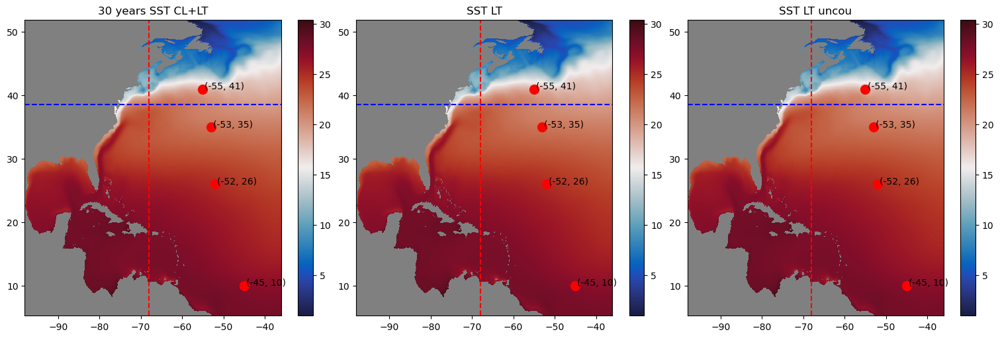

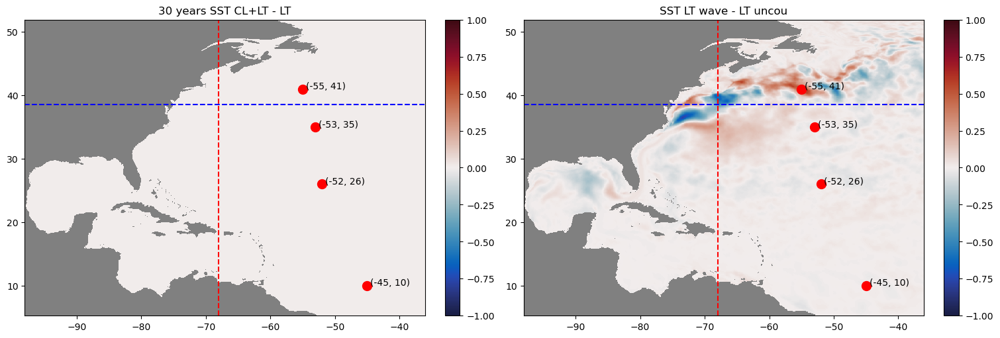

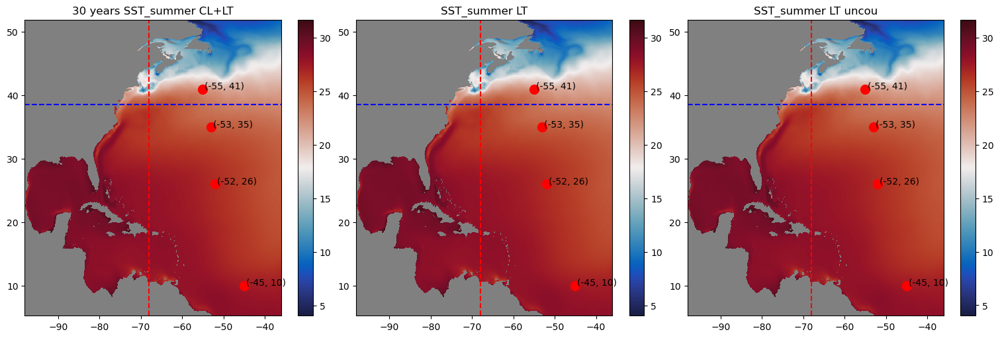

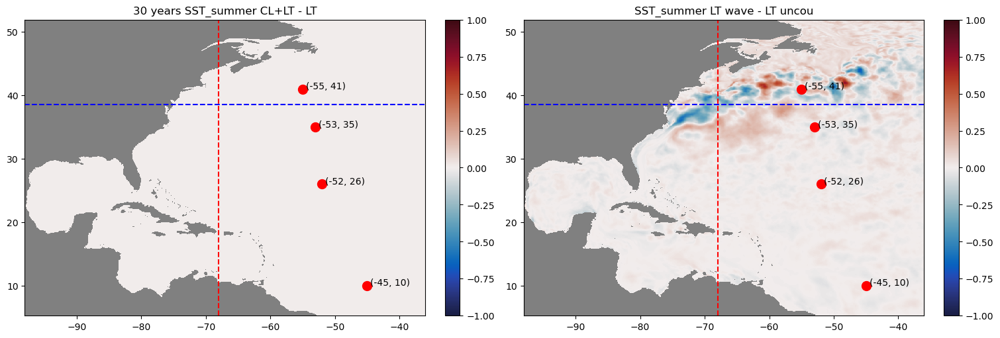

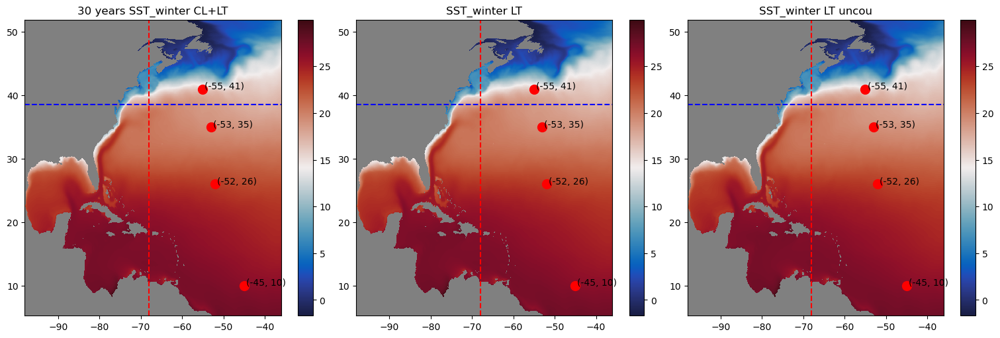

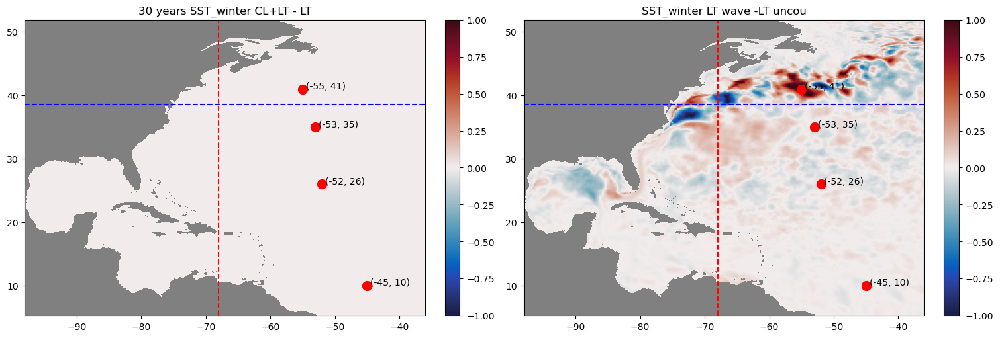

In [10]:


SST_uncou_ave= Dcombined_data_uncou['SST']
SST_summer_uncou_ave= Dsummer_data_uncou['SST']
SST_winter_uncou_ave= Dwinter_data_uncou['SST']

SST_6_all_ave= Dcombined_data_6_all['SST']
SST_summer_6_all_ave= Dsummer_data_6_all['SST']
SST_winter_6_all_ave= Dwinter_data_6_all['SST']

SST_6_wave_ave= Dcombined_data_6_wave['SST']
SST_summer_6_wave_ave= Dsummer_data_6_wave['SST']
SST_winter_6_wave_ave= Dwinter_data_6_wave['SST']

diff_SST_uncou_ave=SST_6_wave_ave - SST_uncou_ave
diff_SST_all_ave=SST_6_all_ave-SST_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, SST_6_all_ave , cmap=cmap, shading='auto')
axes[0].set_title('30 years SST CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, SST_6_wave_ave, cmap=cmap, shading='auto')
axes[1].set_title('SST LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, SST_uncou_ave, cmap=cmap, shading='auto')
axes[2].set_title('SST LT uncou')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
axes[0].axvline(x=-68, color='red', linestyle='--')  # Vertical line
axes[0].axhline(y=38.5, color='blue', linestyle='--')  # Horizontal line

axes[1].axvline(x=-68, color='red', linestyle='--')
axes[1].axhline(y=38.5, color='blue', linestyle='--')

axes[2].axvline(x=-68, color='red', linestyle='--')
axes[2].axhline(y=38.5, color='blue', linestyle='--')
# Show the plot
points = [(-45, 10), (-52, 26), (-53, 35), (-55,41)]  # Example points

for ax in axes:  # Loop over each subplot
    for lon, lat in points:
        ax.scatter(lon, lat, color='red', marker='o', s=100)  # Plot the point
        ax.text(lon + 0.5, lat, f'({lon}, {lat})', fontsize=10, color='black')  # Add label
# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_SST_all_ave , cmap=cmap, shading='auto',vmin=-1,vmax=1)
axes[0].set_title('30 years SST CL+LT - LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_SST_uncou_ave, cmap=cmap, shading='auto',vmin=-1,vmax=1)
axes[1].set_title('SST LT wave - LT uncou')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
axes[0].axvline(x=-68, color='red', linestyle='--')  # Vertical line
axes[0].axhline(y=38.5, color='blue', linestyle='--')  # Horizontal line

axes[1].axvline(x=-68, color='red', linestyle='--')
axes[1].axhline(y=38.5, color='blue', linestyle='--')
points = [(-45, 10), (-52, 26), (-53, 35), (-55,41)]  # Example points

for ax in axes:  # Loop over each subplot
    for lon, lat in points:
        ax.scatter(lon, lat, color='red', marker='o', s=100)  # Plot the point
        ax.text(lon + 0.5, lat, f'({lon}, {lat})', fontsize=10, color='black')  # Add label
# Show the plot
plt.show()


diff_SST_summer_uncou_ave=SST_summer_6_wave_ave-SST_summer_uncou_ave
diff_SST_summer_all_ave=SST_summer_6_all_ave-SST_summer_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, SST_summer_6_all_ave , cmap=cmap, shading='auto')
axes[0].set_title('30 years SST_summer CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, SST_summer_6_wave_ave, cmap=cmap, shading='auto')
axes[1].set_title('SST_summer LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, SST_summer_uncou_ave, cmap=cmap, shading='auto')
axes[2].set_title('SST_summer LT uncou')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
axes[0].axvline(x=-68, color='red', linestyle='--')  # Vertical line
axes[0].axhline(y=38.5, color='blue', linestyle='--')  # Horizontal line

axes[1].axvline(x=-68, color='red', linestyle='--')
axes[1].axhline(y=38.5, color='blue', linestyle='--')
axes[2].axvline(x=-68, color='red', linestyle='--')
axes[2].axhline(y=38.5, color='blue', linestyle='--')
points = [(-45, 10), (-52, 26), (-53, 35), (-55,41)]  # Example points

for ax in axes:  # Loop over each subplot
    for lon, lat in points:
        ax.scatter(lon, lat, color='red', marker='o', s=100)  # Plot the point
        ax.text(lon + 0.5, lat, f'({lon}, {lat})', fontsize=10, color='black')  # Add label
# Show the plot
# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_SST_summer_all_ave , cmap=cmap, shading='auto',vmin=-1,vmax=1)
axes[0].set_title('30 years SST_summer CL+LT - LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_SST_summer_uncou_ave, cmap=cmap, shading='auto',vmin=-1,vmax=1)
axes[1].set_title('SST_summer LT wave - LT uncou')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
axes[0].axvline(x=-68, color='red', linestyle='--')  # Vertical line
axes[0].axhline(y=38.5, color='blue', linestyle='--')  # Horizontal line

axes[1].axvline(x=-68, color='red', linestyle='--')
axes[1].axhline(y=38.5, color='blue', linestyle='--')
points = [(-45, 10), (-52, 26), (-53, 35), (-55,41)]  # Example points

for ax in axes:  # Loop over each subplot
    for lon, lat in points:
        ax.scatter(lon, lat, color='red', marker='o', s=100)  # Plot the point
        ax.text(lon + 0.5, lat, f'({lon}, {lat})', fontsize=10, color='black')  # Add label
# Show the plot

plt.show()

diff_SST_winter_uncou_ave=SST_winter_6_wave_ave - SST_winter_uncou_ave
diff_SST_winter_all_ave=SST_winter_6_all_ave-SST_winter_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, SST_winter_6_all_ave , cmap=cmap, shading='auto')
axes[0].set_title('30 years SST_winter CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, SST_winter_6_wave_ave, cmap=cmap, shading='auto')
axes[1].set_title('SST_winter LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, SST_winter_uncou_ave, cmap=cmap, shading='auto')
axes[2].set_title('SST_winter LT uncou')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
axes[0].axvline(x=-68, color='red', linestyle='--')  # Vertical line
axes[0].axhline(y=38.5, color='blue', linestyle='--')  # Horizontal line

axes[1].axvline(x=-68, color='red', linestyle='--')
axes[1].axhline(y=38.5, color='blue', linestyle='--')
axes[2].axvline(x=-68, color='red', linestyle='--')
axes[2].axhline(y=38.5, color='blue', linestyle='--')
points = [(-45, 10), (-52, 26), (-53, 35), (-55,41)]  # Example points

for ax in axes:  # Loop over each subplot
    for lon, lat in points:
        ax.scatter(lon, lat, color='red', marker='o', s=100)  # Plot the point
        ax.text(lon + 0.5, lat, f'({lon}, {lat})', fontsize=10, color='black')  # Add label
# Show the plot
# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_SST_winter_all_ave , cmap=cmap, shading='auto',vmin=-1,vmax=1)
axes[0].set_title('30 years SST_winter CL+LT - LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_SST_winter_uncou_ave, cmap=cmap, shading='auto',vmin=-1,vmax=1)
axes[1].set_title('SST_winter LT wave -LT uncou')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
axes[0].axvline(x=-68, color='red', linestyle='--')  # Vertical line
axes[0].axhline(y=38.5, color='blue', linestyle='--')  # Horizontal line

axes[1].axvline(x=-68, color='red', linestyle='--')
axes[1].axhline(y=38.5, color='blue', linestyle='--')
points = [(-45, 10), (-52, 26), (-53, 35), (-55,41)]  # Example points

for ax in axes:  # Loop over each subplot
    for lon, lat in points:
        ax.scatter(lon, lat, color='red', marker='o', s=100)  # Plot the point
        ax.text(lon + 0.5, lat, f'({lon}, {lat})', fontsize=10, color='black')  # Add label
# Show the plot
plt.show()

In [8]:
print( SST_uncou_ave.sel(xh=-45, yh=10, method="nearest").values)
print( SST_summer_uncou_ave.sel(xh=-45, yh=10, method="nearest").values)
print( SST_winter_uncou_ave.sel(xh=-45, yh=10, method="nearest").values)


print( diff_SST_uncou_ave.sel(xh=-45, yh=10, method="nearest").values)
print( diff_SST_summer_uncou_ave.sel(xh=-45, yh=10, method="nearest").values)
print( diff_SST_winter_uncou_ave.sel(xh=-45, yh=10, method="nearest").values)

print( diff_SST_all_ave.sel(xh=-45, yh=10, method="nearest").values)
print( diff_SST_summer_all_ave.sel(xh=-45, yh=10, method="nearest").values)
print( diff_SST_winter_all_ave.sel(xh=-45, yh=10, method="nearest").values)

# point_val_wave = Dcombined_data_6_wave['SST'].sel(xh=-45, yh=10, method="nearest").mean(dim='time', skipna=True)
# point_val_all = Dcombined_data_all['SST'].sel(xh=-45, yh=10, method="nearest").mean(dim='time', skipna=True)
# print(point_val_wave - point_val_uncou)

# point_val_wave = Dsummer_data_6_wave['SST'].sel(xh=-45, yh=10, method="nearest").mean(dim='time', skipna=True)
# point_val_uncou = Dsummer_data_uncou['SST'].sel(xh=-45, yh=10, method="nearest").mean(dim='time', skipna=True)
# print(point_val_wave - point_val_uncou)

# point_val_wave = Dwinter_data_6_wave['SST'].sel(xh=-45, yh=10, method="nearest").mean(dim='time', skipna=True)
# point_val_uncou = Dwinter_data_uncou['SST'].sel(xh=-45, yh=10, method="nearest").mean(dim='time', skipna=True)

# -44.959991455078125, Exact yh: 10.028401374816895
# print(point_val_wave - point_val_uncou)

27.161626129414987
27.45991847826087
26.48848471555227
27.142431778771563
27.467878170289854
26.448795945696343
-0.01919435064342423
0.007959692028983056
-0.039688769855928285
0.0
0.0
0.0


In [11]:
MLD_EN1_uncou_ave= Dcombined_data_uncou['MLD_EN1'].mean(dim='time', skipna=True)
MLD_EN1_summer_uncou_ave= Dsummer_data_uncou['MLD_EN1'].mean(dim='time', skipna=True)
MLD_EN1_winter_uncou_ave= Dwinter_data_uncou['MLD_EN1'].mean(dim='time', skipna=True)

MLD_EN1_6_all_ave= Dcombined_data_6_all['MLD_EN1'].mean(dim='time', skipna=True)
MLD_EN1_summer_6_all_ave= Dsummer_data_6_all['MLD_EN1'].mean(dim='time', skipna=True)
MLD_EN1_winter_6_all_ave= Dwinter_data_6_all['MLD_EN1'].mean(dim='time', skipna=True)

MLD_EN1_6_wave_ave= Dcombined_data_6_wave['MLD_EN1'].mean(dim='time', skipna=True)
MLD_EN1_summer_6_wave_ave= Dsummer_data_6_wave['MLD_EN1'].mean(dim='time', skipna=True)
MLD_EN1_winter_6_wave_ave= Dwinter_data_6_wave['MLD_EN1'].mean(dim='time', skipna=True)

diff_MLD_EN1_uncou_ave=MLD_EN1_6_wave_ave-MLD_EN1_uncou_ave
diff_MLD_EN1_all_ave=MLD_EN1_6_all_ave-MLD_EN1_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, MLD_EN1_6_all_ave , cmap=cmap, shading='auto')
axes[0].set_title('30 years MLD_EN1 CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, MLD_EN1_6_wave_ave, cmap=cmap, shading='auto')
axes[1].set_title('MLD_EN1 LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, MLD_EN1_uncou_ave, cmap=cmap, shading='auto')
axes[2].set_title('MLD_EN1 LT uncou')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
axes[0].axvline(x=-68, color='red', linestyle='--')  # Vertical line
axes[0].axhline(y=38.5, color='blue', linestyle='--')  # Horizontal line

axes[1].axvline(x=-68, color='red', linestyle='--')
axes[1].axhline(y=38.5, color='blue', linestyle='--')
axes[2].axvline(x=-68, color='red', linestyle='--')
axes[2].axhline(y=38.5, color='blue', linestyle='--')

points = [(-45, 10), (-52, 26), (-53, 35), (-55,41)]  # Example points

for ax in axes:  # Loop over each subplot
    for lon, lat in points:
        ax.scatter(lon, lat, color='red', marker='o', s=100)  # Plot the point
        ax.text(lon + 0.5, lat, f'({lon}, {lat})', fontsize=10, color='black')  # Add label
# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_MLD_EN1_all_ave , cmap=cmap, shading='auto',vmin=-10,vmax=10)
axes[0].set_title('30 years MLD_EN1 CL+LT - LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_MLD_EN1_uncou_ave, cmap=cmap, shading='auto',vmin=-10,vmax=10)
axes[1].set_title('MLD_EN1 LT wave -LT uncou')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
axes[0].axvline(x=-68, color='red', linestyle='--')  # Vertical line
axes[0].axhline(y=38.5, color='blue', linestyle='--')  # Horizontal line

axes[1].axvline(x=-68, color='red', linestyle='--')
axes[1].axhline(y=38.5, color='blue', linestyle='--')

for ax in axes:  # Loop over each subplot
    for lon, lat in points:
        ax.scatter(lon, lat, color='red', marker='o', s=100)  # Plot the point
        ax.text(lon + 0.5, lat, f'({lon}, {lat})', fontsize=10, color='black')  # Add label
plt.show()


diff_MLD_EN1_summer_uncou_ave=MLD_EN1_summer_6_wave_ave-MLD_EN1_summer_uncou_ave
diff_MLD_EN1_summer_all_ave=MLD_EN1_summer_6_all_ave-MLD_EN1_summer_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, MLD_EN1_summer_6_all_ave , cmap=cmap, shading='auto')
axes[0].set_title('30 years MLD_EN1_summer CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, MLD_EN1_summer_6_wave_ave, cmap=cmap, shading='auto')
axes[1].set_title('MLD_EN1_summer LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, MLD_EN1_summer_uncou_ave, cmap=cmap, shading='auto')
axes[2].set_title('MLD_EN1_summer LT uncou')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
axes[0].axvline(x=-68, color='red', linestyle='--')  # Vertical line
axes[0].axhline(y=38.5, color='blue', linestyle='--')  # Horizontal line

axes[1].axvline(x=-68, color='red', linestyle='--')
axes[1].axhline(y=38.5, color='blue', linestyle='--')
axes[2].axvline(x=-68, color='red', linestyle='--')
axes[2].axhline(y=38.5, color='blue', linestyle='--')

for ax in axes:  # Loop over each subplot
    for lon, lat in points:
        ax.scatter(lon, lat, color='red', marker='o', s=100)  # Plot the point
        ax.text(lon + 0.5, lat, f'({lon}, {lat})', fontsize=10, color='black')  # Add label
# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_MLD_EN1_summer_all_ave , cmap=cmap, shading='auto',vmin=-10,vmax=10)
axes[0].set_title('30 years MLD_EN1_summer CL+LT - LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_MLD_EN1_summer_uncou_ave, cmap=cmap, shading='auto',vmin=-10,vmax=10)
axes[1].set_title('MLD_EN1_summer LT wave -LT uncou')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
axes[0].axvline(x=-68, color='red', linestyle='--')  # Vertical line
axes[0].axhline(y=38.5, color='blue', linestyle='--')  # Horizontal line

axes[1].axvline(x=-68, color='red', linestyle='--')
axes[1].axhline(y=38.5, color='blue', linestyle='--')

for ax in axes:  # Loop over each subplot
    for lon, lat in points:
        ax.scatter(lon, lat, color='red', marker='o', s=100)  # Plot the point
        ax.text(lon + 0.5, lat, f'({lon}, {lat})', fontsize=10, color='black')  # Add label
plt.show()

diff_MLD_EN1_winter_uncou_ave=MLD_EN1_winter_6_wave_ave-MLD_EN1_winter_uncou_ave
diff_MLD_EN1_winter_all_ave=MLD_EN1_winter_6_all_ave-MLD_EN1_winter_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, MLD_EN1_winter_6_all_ave , cmap=cmap, shading='auto')
axes[0].set_title('30 years MLD_EN1_winter CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, MLD_EN1_winter_6_wave_ave, cmap=cmap, shading='auto')
axes[1].set_title('MLD_EN1_winter LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, MLD_EN1_winter_uncou_ave, cmap=cmap, shading='auto')
axes[2].set_title('MLD_EN1_winter LT uncou')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
axes[0].axvline(x=-68, color='red', linestyle='--')  # Vertical line
axes[0].axhline(y=38.5, color='blue', linestyle='--')  # Horizontal line

axes[1].axvline(x=-68, color='red', linestyle='--')
axes[1].axhline(y=38.5, color='blue', linestyle='--')

for ax in axes:  # Loop over each subplot
    for lon, lat in points:
        ax.scatter(lon, lat, color='red', marker='o', s=100)  # Plot the point
        ax.text(lon + 0.5, lat, f'({lon}, {lat})', fontsize=10, color='black')  # Add label
# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_MLD_EN1_winter_all_ave , cmap=cmap, shading='auto',vmin=-20,vmax=20)
axes[0].set_title('30 years MLD_EN1_winter CL+LT - LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_MLD_EN1_winter_uncou_ave, cmap=cmap, shading='auto',vmin=-20,vmax=20)
axes[1].set_title('MLD_EN1_winter LT wave -  LT uncou')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
axes[0].axvline(x=-68, color='red', linestyle='--')  # Vertical line
axes[0].axhline(y=38.5, color='blue', linestyle='--')  # Horizontal line

axes[1].axvline(x=-68, color='red', linestyle='--')
axes[1].axhline(y=38.5, color='blue', linestyle='--')

for ax in axes:  # Loop over each subplot
    for lon, lat in points:
        ax.scatter(lon, lat, color='red', marker='o', s=100)  # Plot the point
        ax.text(lon + 0.5, lat, f'({lon}, {lat})', fontsize=10, color='black')  # Add label
plt.show()

KeyError: 'MLD_EN1'

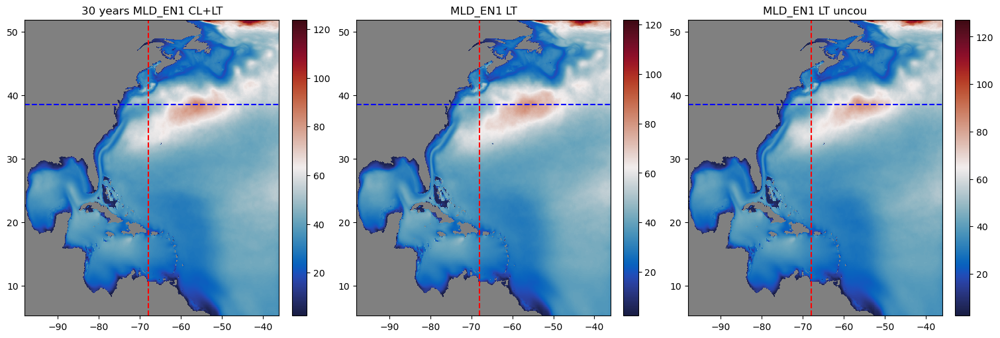

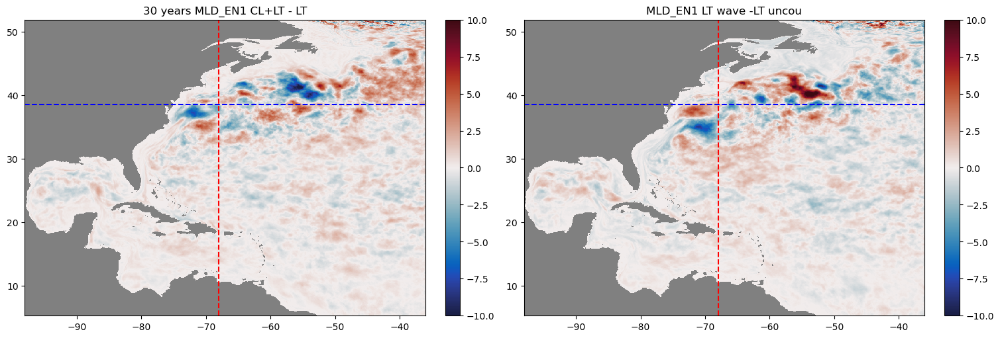

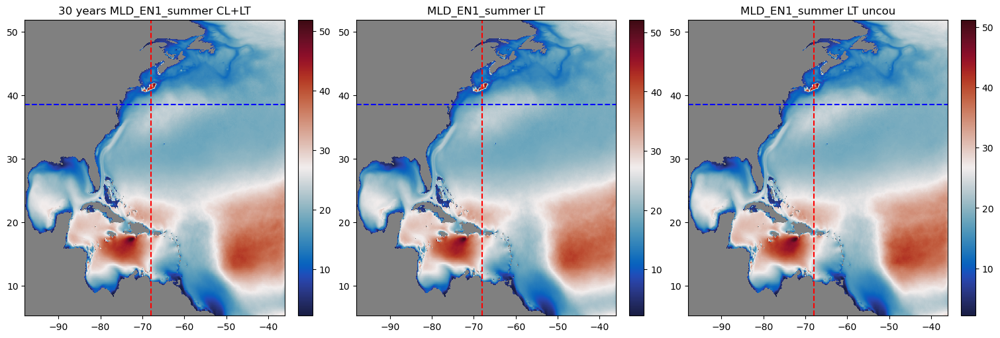

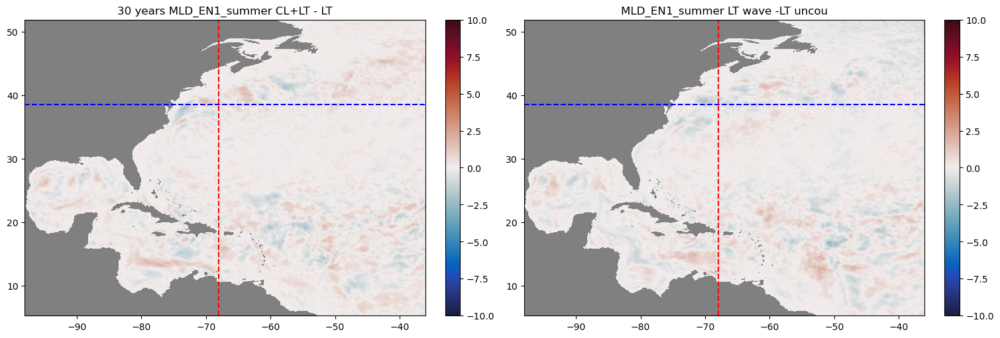

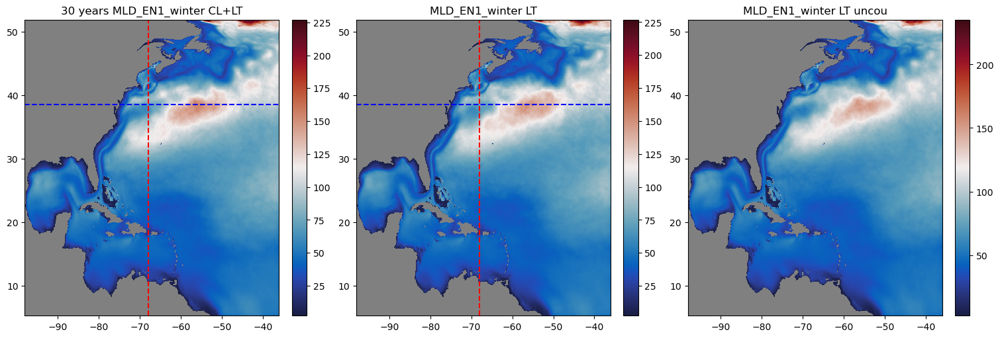

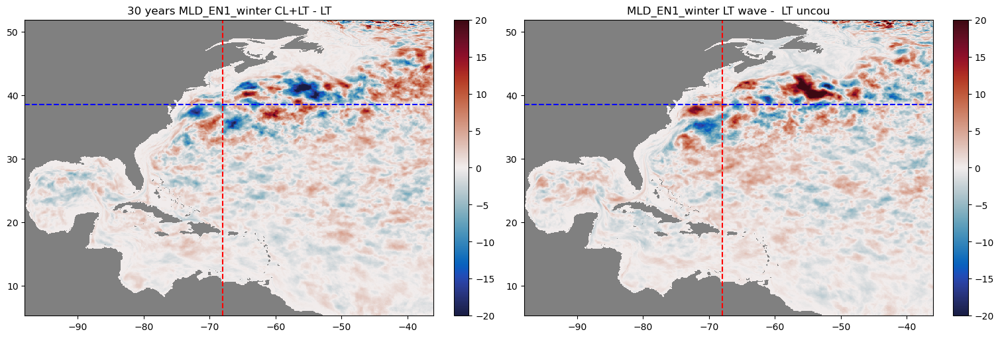

In [13]:
MLD_EN1_uncou_ave= Mcombined_data_uncou['MLD_EN1']
MLD_EN1_summer_uncou_ave= Msummer_data_uncou['MLD_EN1']
MLD_EN1_winter_uncou_ave= Mwinter_data_uncou['MLD_EN1']

MLD_EN1_6_all_ave= combined_data_6_all['MLD_EN1']
MLD_EN1_summer_6_all_ave= summer_data_6_all['MLD_EN1']
MLD_EN1_winter_6_all_ave= winter_data_6_all['MLD_EN1']

MLD_EN1_6_wave_ave= combined_data_6_wave['MLD_EN1']
MLD_EN1_summer_6_wave_ave= summer_data_6_wave['MLD_EN1']
MLD_EN1_winter_6_wave_ave= winter_data_6_wave['MLD_EN1']

diff_MLD_EN1_uncou_ave=MLD_EN1_6_wave_ave-MLD_EN1_uncou_ave
diff_MLD_EN1_all_ave=MLD_EN1_6_all_ave-MLD_EN1_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, MLD_EN1_6_all_ave , cmap=cmap, shading='auto')
axes[0].set_title('30 years MLD_EN1 CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, MLD_EN1_6_wave_ave, cmap=cmap, shading='auto')
axes[1].set_title('MLD_EN1 LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, MLD_EN1_uncou_ave, cmap=cmap, shading='auto')
axes[2].set_title('MLD_EN1 LT uncou')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
axes[0].axvline(x=-68, color='red', linestyle='--')  # Vertical line
axes[0].axhline(y=38.5, color='blue', linestyle='--')  # Horizontal line

axes[1].axvline(x=-68, color='red', linestyle='--')
axes[1].axhline(y=38.5, color='blue', linestyle='--')
axes[2].axvline(x=-68, color='red', linestyle='--')
axes[2].axhline(y=38.5, color='blue', linestyle='--')
# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_MLD_EN1_all_ave , cmap=cmap, shading='auto',vmin=-10,vmax=10)
axes[0].set_title('30 years MLD_EN1 CL+LT - LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_MLD_EN1_uncou_ave, cmap=cmap, shading='auto',vmin=-10,vmax=10)
axes[1].set_title('MLD_EN1 LT wave -LT uncou')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
axes[0].axvline(x=-68, color='red', linestyle='--')  # Vertical line
axes[0].axhline(y=38.5, color='blue', linestyle='--')  # Horizontal line

axes[1].axvline(x=-68, color='red', linestyle='--')
axes[1].axhline(y=38.5, color='blue', linestyle='--')
plt.show()


diff_MLD_EN1_summer_uncou_ave=MLD_EN1_summer_6_wave_ave-MLD_EN1_summer_uncou_ave
diff_MLD_EN1_summer_all_ave=MLD_EN1_summer_6_all_ave-MLD_EN1_summer_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, MLD_EN1_summer_6_all_ave , cmap=cmap, shading='auto')
axes[0].set_title('30 years MLD_EN1_summer CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, MLD_EN1_summer_6_wave_ave, cmap=cmap, shading='auto')
axes[1].set_title('MLD_EN1_summer LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, MLD_EN1_summer_uncou_ave, cmap=cmap, shading='auto')
axes[2].set_title('MLD_EN1_summer LT uncou')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
axes[0].axvline(x=-68, color='red', linestyle='--')  # Vertical line
axes[0].axhline(y=38.5, color='blue', linestyle='--')  # Horizontal line

axes[1].axvline(x=-68, color='red', linestyle='--')
axes[1].axhline(y=38.5, color='blue', linestyle='--')
axes[2].axvline(x=-68, color='red', linestyle='--')
axes[2].axhline(y=38.5, color='blue', linestyle='--')
# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_MLD_EN1_summer_all_ave , cmap=cmap, shading='auto',vmin=-10,vmax=10)
axes[0].set_title('30 years MLD_EN1_summer CL+LT - LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_MLD_EN1_summer_uncou_ave, cmap=cmap, shading='auto',vmin=-10,vmax=10)
axes[1].set_title('MLD_EN1_summer LT wave -LT uncou')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
axes[0].axvline(x=-68, color='red', linestyle='--')  # Vertical line
axes[0].axhline(y=38.5, color='blue', linestyle='--')  # Horizontal line

axes[1].axvline(x=-68, color='red', linestyle='--')
axes[1].axhline(y=38.5, color='blue', linestyle='--')
plt.show()

diff_MLD_EN1_winter_uncou_ave=MLD_EN1_winter_6_wave_ave-MLD_EN1_winter_uncou_ave
diff_MLD_EN1_winter_all_ave=MLD_EN1_winter_6_all_ave-MLD_EN1_winter_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, MLD_EN1_winter_6_all_ave , cmap=cmap, shading='auto')
axes[0].set_title('30 years MLD_EN1_winter CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, MLD_EN1_winter_6_wave_ave, cmap=cmap, shading='auto')
axes[1].set_title('MLD_EN1_winter LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, MLD_EN1_winter_uncou_ave, cmap=cmap, shading='auto')
axes[2].set_title('MLD_EN1_winter LT uncou')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
axes[0].axvline(x=-68, color='red', linestyle='--')  # Vertical line
axes[0].axhline(y=38.5, color='blue', linestyle='--')  # Horizontal line

axes[1].axvline(x=-68, color='red', linestyle='--')
axes[1].axhline(y=38.5, color='blue', linestyle='--')
# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_MLD_EN1_winter_all_ave , cmap=cmap, shading='auto',vmin=-20,vmax=20)
axes[0].set_title('30 years MLD_EN1_winter CL+LT - LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_MLD_EN1_winter_uncou_ave, cmap=cmap, shading='auto',vmin=-20,vmax=20)
axes[1].set_title('MLD_EN1_winter LT wave -  LT uncou')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
axes[0].axvline(x=-68, color='red', linestyle='--')  # Vertical line
axes[0].axhline(y=38.5, color='blue', linestyle='--')  # Horizontal line

axes[1].axvline(x=-68, color='red', linestyle='--')
axes[1].axhline(y=38.5, color='blue', linestyle='--')
plt.show()

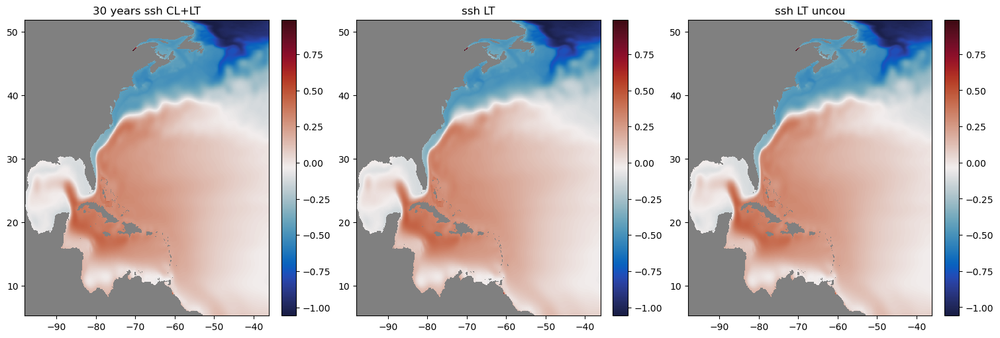

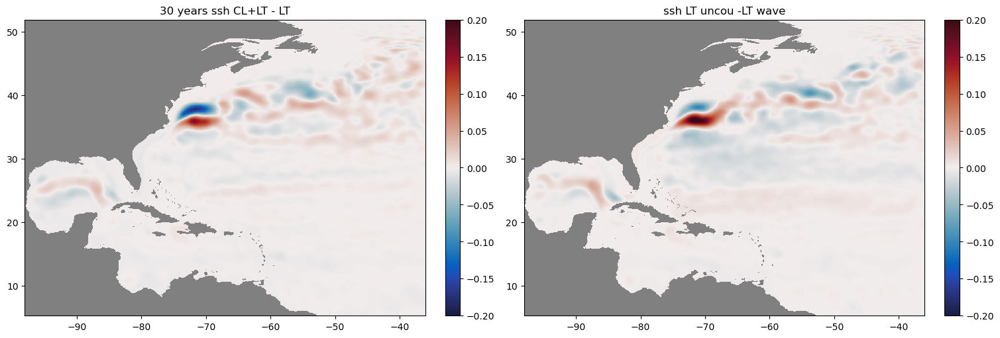

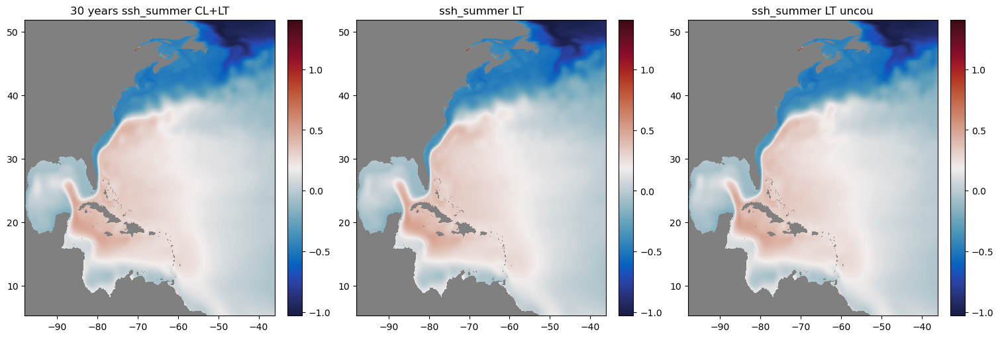

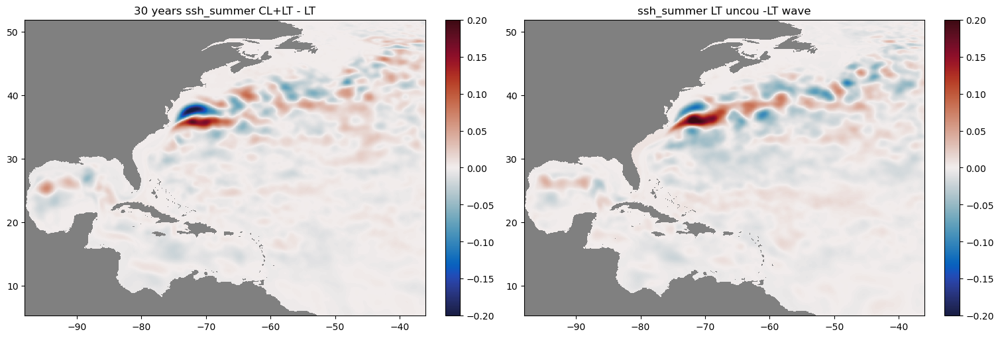

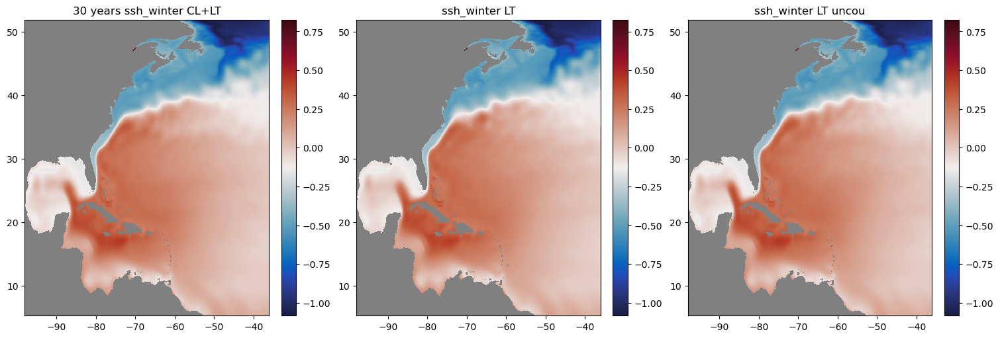

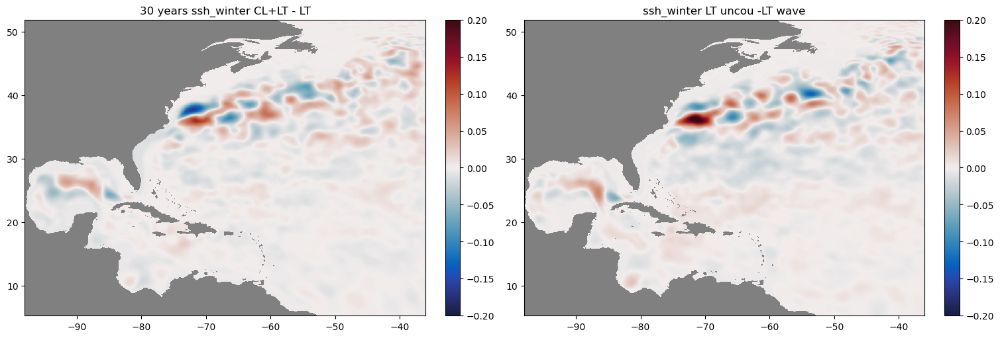

In [14]:
ssh_uncou_ave= Mcombined_data_uncou['ssh']
ssh_summer_uncou_ave= Msummer_data_uncou['ssh']
ssh_winter_uncou_ave= Mwinter_data_uncou['ssh']

ssh_6_all_ave= combined_data_6_all['ssh']
ssh_summer_6_all_ave= summer_data_6_all['ssh']
ssh_winter_6_all_ave= winter_data_6_all['ssh']

ssh_6_wave_ave= combined_data_6_wave['ssh']
ssh_summer_6_wave_ave= summer_data_6_wave['ssh']
ssh_winter_6_wave_ave= winter_data_6_wave['ssh']

diff_ssh_uncou_ave=ssh_uncou_ave-ssh_6_wave_ave
diff_ssh_all_ave=ssh_6_all_ave-ssh_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, ssh_6_all_ave , cmap=cmap, shading='auto')
axes[0].set_title('30 years ssh CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, ssh_6_wave_ave, cmap=cmap, shading='auto')
axes[1].set_title('ssh LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, ssh_uncou_ave, cmap=cmap, shading='auto')
axes[2].set_title('ssh LT uncou')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_ssh_all_ave , cmap=cmap, shading='auto',vmin=-0.2,vmax=0.2)
axes[0].set_title('30 years ssh CL+LT - LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_ssh_uncou_ave, cmap=cmap, shading='auto',vmin=-0.2,vmax=0.2)
axes[1].set_title('ssh LT uncou -LT wave')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
plt.show()


diff_ssh_summer_uncou_ave=ssh_summer_uncou_ave-ssh_summer_6_wave_ave
diff_ssh_summer_all_ave=ssh_summer_6_all_ave-ssh_summer_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, ssh_summer_6_all_ave , cmap=cmap, shading='auto')
axes[0].set_title('30 years ssh_summer CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, ssh_summer_6_wave_ave, cmap=cmap, shading='auto')
axes[1].set_title('ssh_summer LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, ssh_summer_uncou_ave, cmap=cmap, shading='auto')
axes[2].set_title('ssh_summer LT uncou')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_ssh_summer_all_ave , cmap=cmap, shading='auto',vmin=-0.2,vmax=0.2)
axes[0].set_title('30 years ssh_summer CL+LT - LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_ssh_summer_uncou_ave, cmap=cmap, shading='auto',vmin=-0.2,vmax=0.2)
axes[1].set_title('ssh_summer LT uncou -LT wave')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
plt.show()

diff_ssh_winter_uncou_ave=ssh_winter_uncou_ave-ssh_winter_6_wave_ave
diff_ssh_winter_all_ave=ssh_winter_6_all_ave-ssh_winter_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, ssh_winter_6_all_ave , cmap=cmap, shading='auto')
axes[0].set_title('30 years ssh_winter CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, ssh_winter_6_wave_ave, cmap=cmap, shading='auto')
axes[1].set_title('ssh_winter LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, ssh_winter_uncou_ave, cmap=cmap, shading='auto')
axes[2].set_title('ssh_winter LT uncou')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_ssh_winter_all_ave , cmap=cmap, shading='auto',vmin=-0.2,vmax=0.2)
axes[0].set_title('30 years ssh_winter CL+LT - LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_ssh_winter_uncou_ave, cmap=cmap, shading='auto',vmin=-0.2,vmax=0.2)
axes[1].set_title('ssh_winter LT uncou -LT wave')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
plt.show()

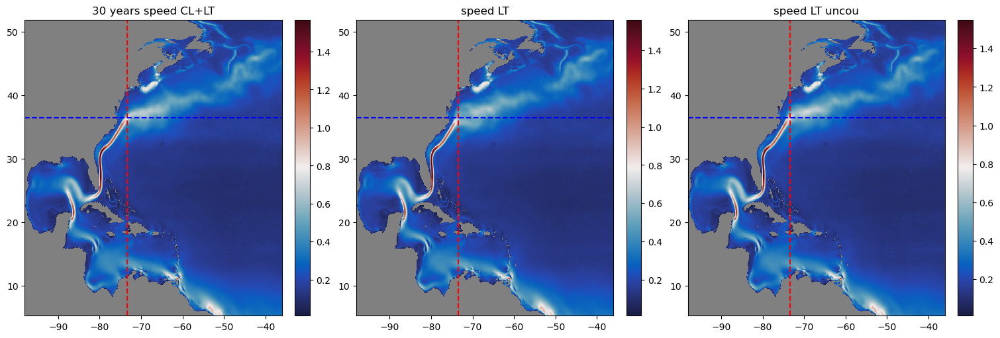

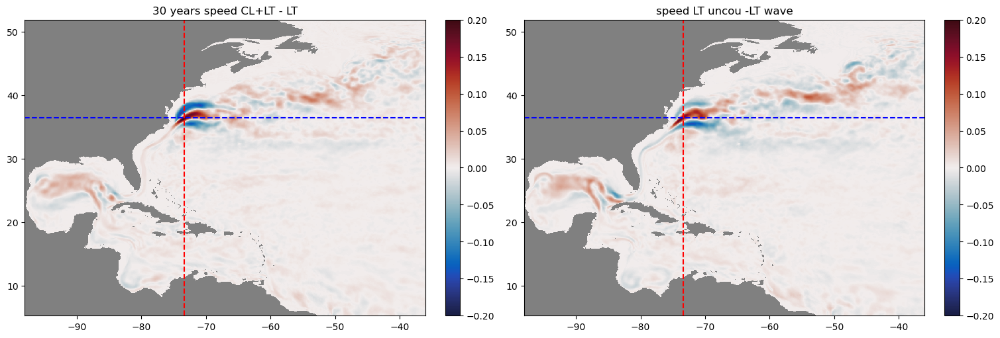

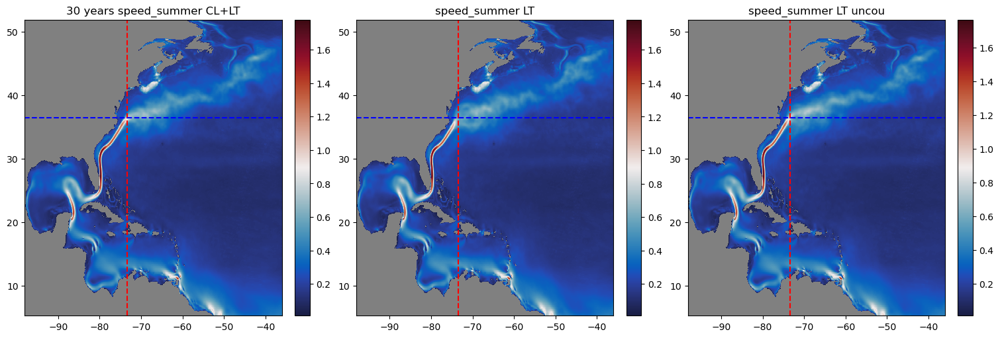

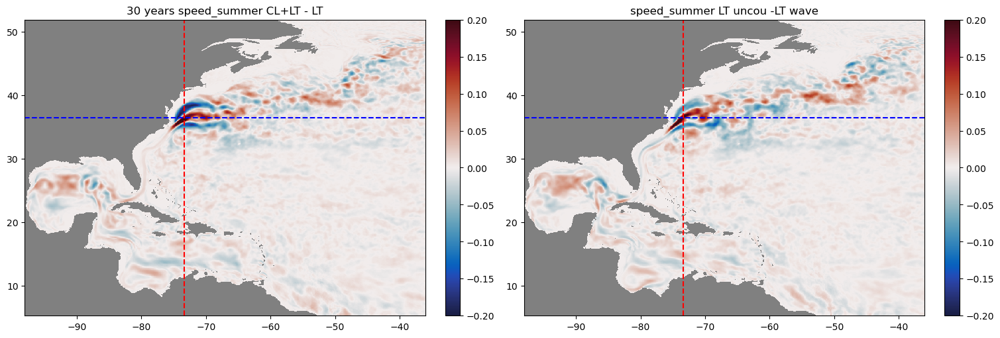

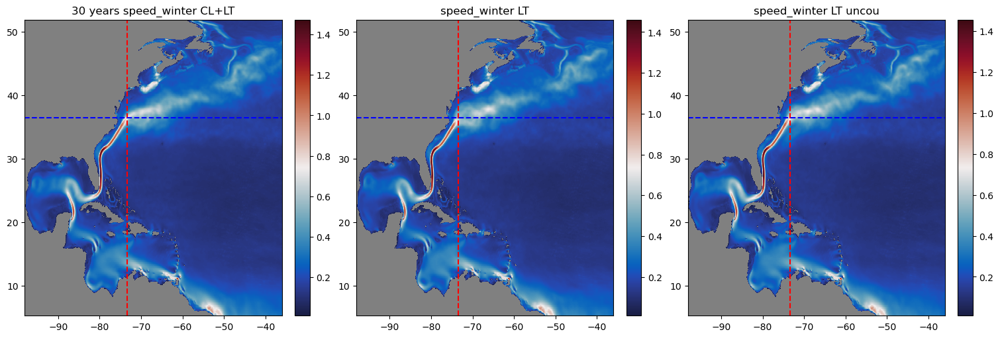

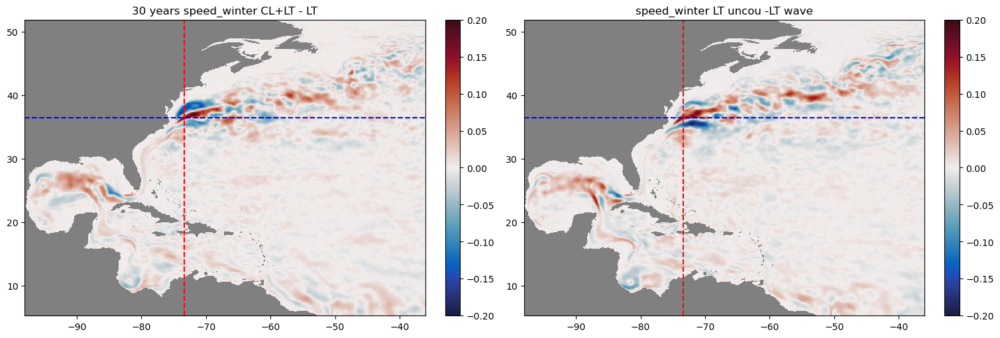

In [15]:
speed_uncou= Mcombined_data_uncou['speed']
speed_summer_uncou= Msummer_data_uncou['speed']
speed_winter_uncou= Mwinter_data_uncou['speed']
speed_uncou_ave=speed_uncou
speed_summer_uncou_ave=speed_summer_uncou
speed_winter_uncou_ave=speed_winter_uncou

speed_6_all= combined_data_6_all['speed']
speed_summer_6_all= summer_data_6_all['speed']
speed_winter_6_all= winter_data_6_all['speed']
speed_6_all_ave=speed_6_all
speed_summer_6_all_ave=speed_summer_6_all
speed_winter_6_all_ave=speed_winter_6_all

speed_6_wave= combined_data_6_wave['speed']
speed_summer_6_wave= summer_data_6_wave['speed']
speed_winter_6_wave= winter_data_6_wave['speed']
speed_6_wave_ave=speed_6_wave
speed_summer_6_wave_ave=speed_summer_6_wave
speed_winter_6_wave_ave=speed_winter_6_wave


diff_speed_uncou_ave=speed_uncou_ave-speed_6_wave_ave
diff_speed_all_ave=speed_6_all_ave-speed_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, speed_6_all_ave , cmap=cmap, shading='auto')
axes[0].set_title('30 years speed CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, speed_6_wave_ave, cmap=cmap, shading='auto')
axes[1].set_title('speed LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, speed_uncou_ave, cmap=cmap, shading='auto')
axes[2].set_title('speed LT uncou')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
axes[0].axvline(x=-73.4, color='red', linestyle='--')  # Vertical line
axes[0].axhline(y=36.5, color='blue', linestyle='--')  # Horizontal line

axes[1].axvline(x=-73.4, color='red', linestyle='--')
axes[1].axhline(y=36.5, color='blue', linestyle='--')

axes[2].axvline(x=-73.4, color='red', linestyle='--')
axes[2].axhline(y=36.5, color='blue', linestyle='--')
# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_speed_all_ave , cmap=cmap, shading='auto',vmin=-0.2,vmax=0.2)
axes[0].set_title('30 years speed CL+LT - LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_speed_uncou_ave, cmap=cmap, shading='auto',vmin=-0.2,vmax=0.2)
axes[1].set_title('speed LT uncou -LT wave')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
axes[0].axvline(x=-73.4, color='red', linestyle='--')  # Vertical line
axes[0].axhline(y=36.5, color='blue', linestyle='--')  # Horizontal line

axes[1].axvline(x=-73.4, color='red', linestyle='--')
axes[1].axhline(y=36.5, color='blue', linestyle='--')


plt.show()


diff_speed_summer_uncou_ave=speed_summer_uncou_ave-speed_summer_6_wave_ave
diff_speed_summer_all_ave=speed_summer_6_all_ave-speed_summer_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, speed_summer_6_all_ave , cmap=cmap, shading='auto')
axes[0].set_title('30 years speed_summer CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, speed_summer_6_wave_ave, cmap=cmap, shading='auto')
axes[1].set_title('speed_summer LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, speed_summer_uncou_ave, cmap=cmap, shading='auto')
axes[2].set_title('speed_summer LT uncou')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
axes[0].axvline(x=-73.4, color='red', linestyle='--')  # Vertical line
axes[0].axhline(y=36.5, color='blue', linestyle='--')  # Horizontal line

axes[1].axvline(x=-73.4, color='red', linestyle='--')
axes[1].axhline(y=36.5, color='blue', linestyle='--')

axes[2].axvline(x=-73.4, color='red', linestyle='--')
axes[2].axhline(y=36.5, color='blue', linestyle='--')
# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_speed_summer_all_ave , cmap=cmap, shading='auto',vmin=-0.2,vmax=0.2)
axes[0].set_title('30 years speed_summer CL+LT - LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_speed_summer_uncou_ave, cmap=cmap, shading='auto',vmin=-0.2,vmax=0.2)
axes[1].set_title('speed_summer LT uncou -LT wave')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
axes[0].axvline(x=-73.4, color='red', linestyle='--')  # Vertical line
axes[0].axhline(y=36.5, color='blue', linestyle='--')  # Horizontal line

axes[1].axvline(x=-73.4, color='red', linestyle='--')
axes[1].axhline(y=36.5, color='blue', linestyle='--')

plt.show()

diff_speed_winter_uncou_ave=speed_winter_uncou_ave-speed_winter_6_wave_ave
diff_speed_winter_all_ave=speed_winter_6_all_ave-speed_winter_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, speed_winter_6_all_ave , cmap=cmap, shading='auto')
axes[0].set_title('30 years speed_winter CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, speed_winter_6_wave_ave, cmap=cmap, shading='auto')
axes[1].set_title('speed_winter LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, speed_winter_uncou_ave, cmap=cmap, shading='auto')
axes[2].set_title('speed_winter LT uncou')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
axes[0].axvline(x=-73.4, color='red', linestyle='--')  # Vertical line
axes[0].axhline(y=36.5, color='blue', linestyle='--')  # Horizontal line

axes[1].axvline(x=-73.4, color='red', linestyle='--')
axes[1].axhline(y=36.5, color='blue', linestyle='--')

axes[2].axvline(x=-73.4, color='red', linestyle='--')
axes[2].axhline(y=36.5, color='blue', linestyle='--')
# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_speed_winter_all_ave , cmap=cmap, shading='auto',vmin=-0.2,vmax=0.2)
axes[0].set_title('30 years speed_winter CL+LT - LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_speed_winter_uncou_ave, cmap=cmap, shading='auto',vmin=-0.2,vmax=0.2)
axes[1].set_title('speed_winter LT uncou -LT wave')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
axes[0].axvline(x=-73.4, color='red', linestyle='--')  # Vertical line
axes[0].axhline(y=36.5, color='blue', linestyle='--')  # Horizontal line

axes[1].axvline(x=-73.4, color='red', linestyle='--')
axes[1].axhline(y=36.5, color='blue', linestyle='--')

plt.show()

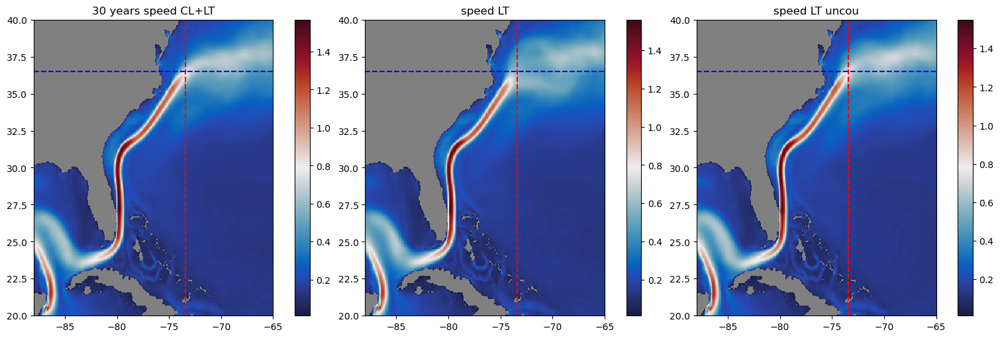

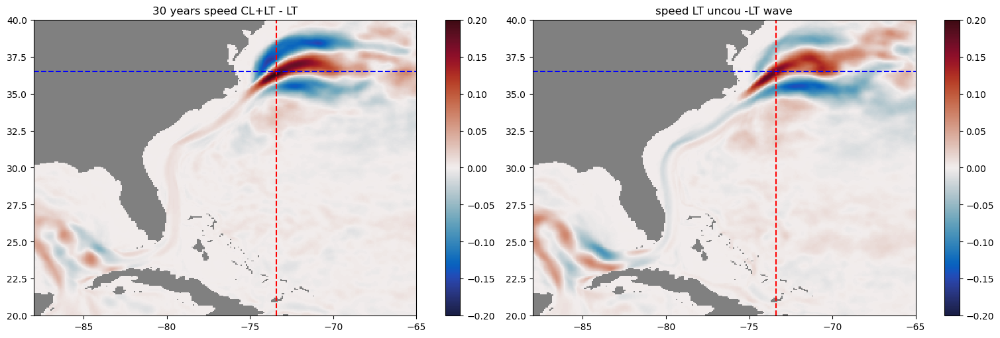

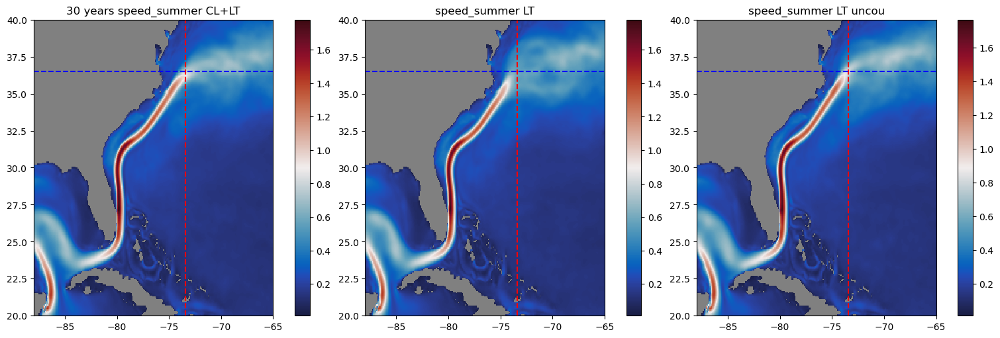

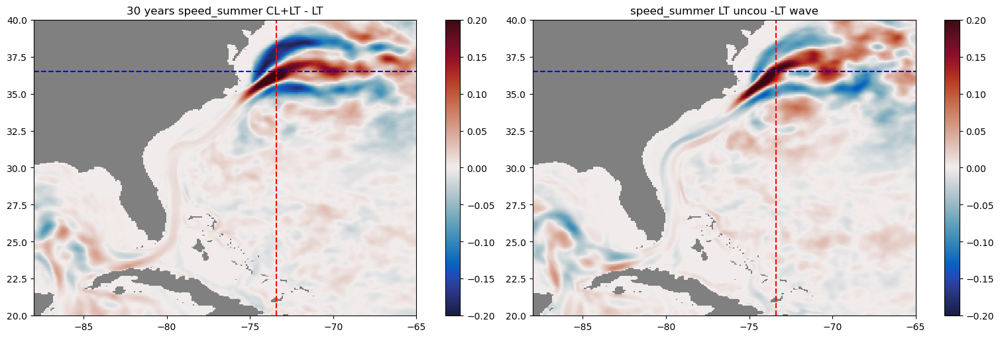

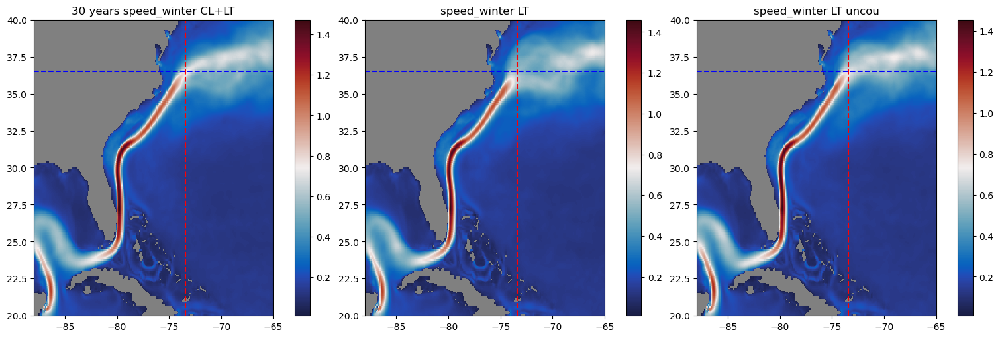

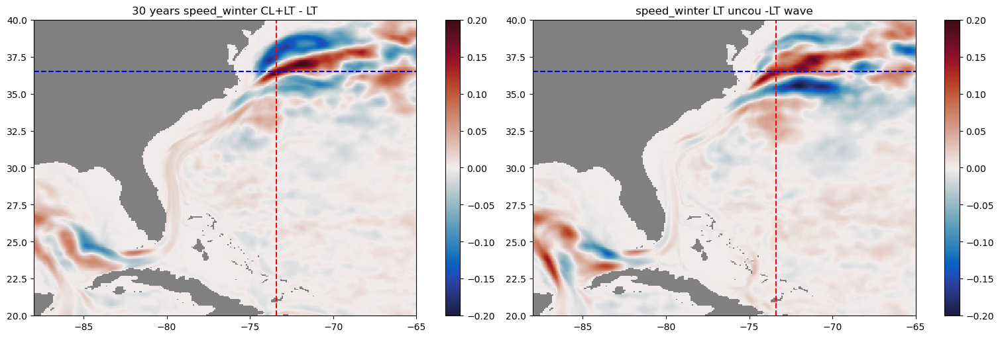

In [16]:
diff_speed_uncou_ave=speed_uncou_ave-speed_6_wave_ave
diff_speed_all_ave=speed_6_all_ave-speed_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, speed_6_all_ave , cmap=cmap, shading='auto')
axes[0].set_title('30 years speed CL+LT')
axes[0].set_xlim([-88, -65])
axes[0].set_ylim([20,40])
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, speed_6_wave_ave, cmap=cmap, shading='auto')
axes[1].set_title('speed LT')
axes[0].set_xlim([-88, -65])
axes[0].set_ylim([20,40])
axes[1].set_xlim([-88, -65])
axes[1].set_ylim([20,40])
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, speed_uncou_ave, cmap=cmap, shading='auto')
axes[2].set_title('speed LT uncou')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
axes[2].set_xlim([-88, -65])
axes[2].set_ylim([20,40])
axes[0].axvline(x=-73.4, color='red', linestyle='--')  # Vertical line
axes[0].axhline(y=36.5, color='blue', linestyle='--')  # Horizontal line

axes[1].axvline(x=-73.4, color='red', linestyle='--')
axes[1].axhline(y=36.5, color='blue', linestyle='--')

axes[2].axvline(x=-73.4, color='red', linestyle='--')
axes[2].axhline(y=36.5, color='blue', linestyle='--')
# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_speed_all_ave , cmap=cmap, shading='auto',vmin=-0.2,vmax=0.2)
axes[0].set_title('30 years speed CL+LT - LT')
axes[0].set_xlim([-88, -65])
axes[0].set_ylim([20,40])
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_speed_uncou_ave, cmap=cmap, shading='auto',vmin=-0.2,vmax=0.2)
axes[1].set_title('speed LT uncou -LT wave')
axes[1].set_xlim([-88, -65])
axes[1].set_ylim([20,40])
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
axes[0].axvline(x=-73.4, color='red', linestyle='--')  # Vertical line
axes[0].axhline(y=36.5, color='blue', linestyle='--')  # Horizontal line

axes[1].axvline(x=-73.4, color='red', linestyle='--')
axes[1].axhline(y=36.5, color='blue', linestyle='--')

plt.show()


diff_speed_summer_uncou_ave=speed_summer_uncou_ave-speed_summer_6_wave_ave
diff_speed_summer_all_ave=speed_summer_6_all_ave-speed_summer_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, speed_summer_6_all_ave , cmap=cmap, shading='auto')
axes[0].set_title('30 years speed_summer CL+LT')
axes[0].set_xlim([-88, -65])
axes[0].set_ylim([20,40])
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, speed_summer_6_wave_ave, cmap=cmap, shading='auto')
axes[1].set_title('speed_summer LT')
axes[1].set_xlim([-88, -65])
axes[1].set_ylim([20,40])
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, speed_summer_uncou_ave, cmap=cmap, shading='auto')
axes[2].set_title('speed_summer LT uncou')
axes[2].set_xlim([-88, -65])
axes[2].set_ylim([20,40])
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
axes[0].axvline(x=-73.4, color='red', linestyle='--')  # Vertical line
axes[0].axhline(y=36.5, color='blue', linestyle='--')  # Horizontal line

axes[1].axvline(x=-73.4, color='red', linestyle='--')
axes[1].axhline(y=36.5, color='blue', linestyle='--')

axes[2].axvline(x=-73.4, color='red', linestyle='--')
axes[2].axhline(y=36.5, color='blue', linestyle='--')
# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_speed_summer_all_ave , cmap=cmap, shading='auto',vmin=-0.2,vmax=0.2)
axes[0].set_title('30 years speed_summer CL+LT - LT')
axes[0].set_xlim([-88, -65])
axes[0].set_ylim([20,40])
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_speed_summer_uncou_ave, cmap=cmap, shading='auto',vmin=-0.2,vmax=0.2)
axes[1].set_title('speed_summer LT uncou -LT wave')
axes[1].set_xlim([-88, -65])
axes[1].set_ylim([20,40])
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
axes[0].axvline(x=-73.4, color='red', linestyle='--')  # Vertical line
axes[0].axhline(y=36.5, color='blue', linestyle='--')  # Horizontal line

axes[1].axvline(x=-73.4, color='red', linestyle='--')
axes[1].axhline(y=36.5, color='blue', linestyle='--')

plt.show()

diff_speed_winter_uncou_ave=speed_winter_uncou_ave-speed_winter_6_wave_ave
diff_speed_winter_all_ave=speed_winter_6_all_ave-speed_winter_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, speed_winter_6_all_ave , cmap=cmap, shading='auto')
axes[0].set_title('30 years speed_winter CL+LT')
axes[0].set_xlim([-88, -65])
axes[0].set_ylim([20,40])
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, speed_winter_6_wave_ave, cmap=cmap, shading='auto')
axes[1].set_title('speed_winter LT')
axes[1].set_xlim([-88, -65])
axes[1].set_ylim([20,40])
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, speed_winter_uncou_ave, cmap=cmap, shading='auto')
axes[2].set_title('speed_winter LT uncou')
axes[2].set_xlim([-88, -65])
axes[2].set_ylim([20,40])
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
axes[0].axvline(x=-73.4, color='red', linestyle='--')  # Vertical line
axes[0].axhline(y=36.5, color='blue', linestyle='--')  # Horizontal line

axes[1].axvline(x=-73.4, color='red', linestyle='--')
axes[1].axhline(y=36.5, color='blue', linestyle='--')

axes[2].axvline(x=-73.4, color='red', linestyle='--')
axes[2].axhline(y=36.5, color='blue', linestyle='--')
# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_speed_winter_all_ave , cmap=cmap, shading='auto',vmin=-0.2,vmax=0.2)
axes[0].set_title('30 years speed_winter CL+LT - LT')
axes[0].set_xlim([-88, -65])
axes[0].set_ylim([20,40])
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_speed_winter_uncou_ave, cmap=cmap, shading='auto',vmin=-0.2,vmax=0.2)
axes[1].set_title('speed_winter LT uncou -LT wave')
axes[1].set_xlim([-88, -65])
axes[1].set_ylim([20,40])
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
axes[0].axvline(x=-73.4, color='red', linestyle='--')  # Vertical line
axes[0].axhline(y=36.5, color='blue', linestyle='--')  # Horizontal line

axes[1].axvline(x=-73.4, color='red', linestyle='--')
axes[1].axhline(y=36.5, color='blue', linestyle='--')

plt.show()

In [16]:
def calculate_ssh_gradient_nonuniform(SSH, xh, yh):
    grad_x = np.zeros_like(SSH)
    grad_y = np.zeros_like(SSH)
    
    # Loop over the interior points only to avoid boundary issues
    for j in range(1, len(yh) - 1):  # Loop over 'yh' (rows, y-direction)
        for i in range(1, len(xh) - 1):  # Loop over 'xh' (columns, x-direction)
            dx = xh[i+1] - xh[i-1]  # Local dx for point (j, i)
            dy = yh[j+1] - yh[j-1]  # Local dy for point (j, i)

            grad_x[j, i] = (SSH[j, i+1] - SSH[j, i-1]) / dx  # Gradient in x-direction
            grad_y[j, i] = (SSH[j+1, i] - SSH[j-1, i]) / dy  # Gradient in y-direction
    
    # Optionally, compute the gradient magnitude

    
    return grad_x, grad_y

gx_summer_uncou,gy_summer_uncou=calculate_ssh_gradient_nonuniform(ssh_summer_uncou_ave, model_grid_x, model_grid_y)
gx_winter_uncou,gy_winter_uncou=calculate_ssh_gradient_nonuniform(ssh_winter_uncou_ave, model_grid_x, model_grid_y)
gx_uncou,gy_uncou=calculate_ssh_gradient_nonuniform(ssh_uncou_ave, model_grid_x, model_grid_y)

gx_summer_6_all,gy_summer_6_all=calculate_ssh_gradient_nonuniform(ssh_summer_6_all_ave, model_grid_x, model_grid_y)
gx_winter_6_all,gy_winter_6_all=calculate_ssh_gradient_nonuniform(ssh_winter_6_all_ave, model_grid_x, model_grid_y)
gx_6_all,gy_6_all=calculate_ssh_gradient_nonuniform(ssh_6_all_ave, model_grid_x, model_grid_y)

gx_summer_6_wave,gy_summer_6_wave=calculate_ssh_gradient_nonuniform(ssh_summer_6_wave_ave, model_grid_x, model_grid_y)
gx_winter_6_wave,gy_winter_6_wave=calculate_ssh_gradient_nonuniform(ssh_winter_6_wave_ave, model_grid_x, model_grid_y)
gx_6_wave,gy_6_wave=calculate_ssh_gradient_nonuniform(ssh_6_wave_ave, model_grid_x, model_grid_y)

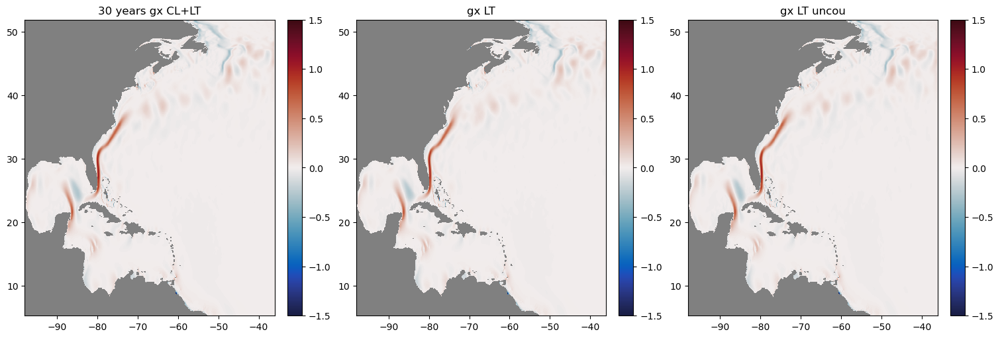

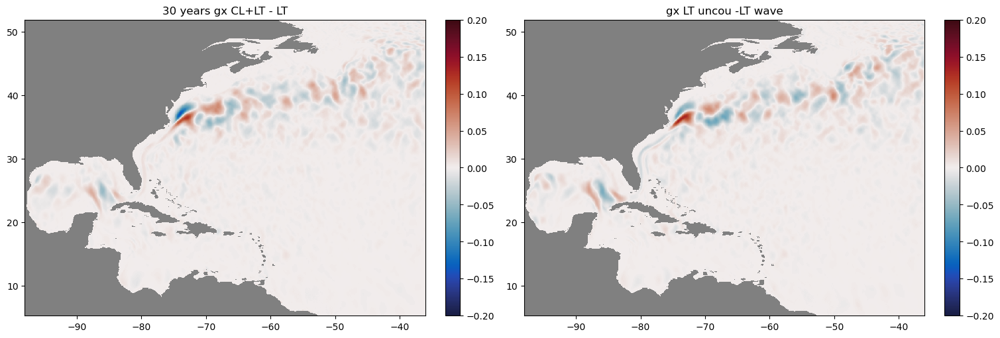

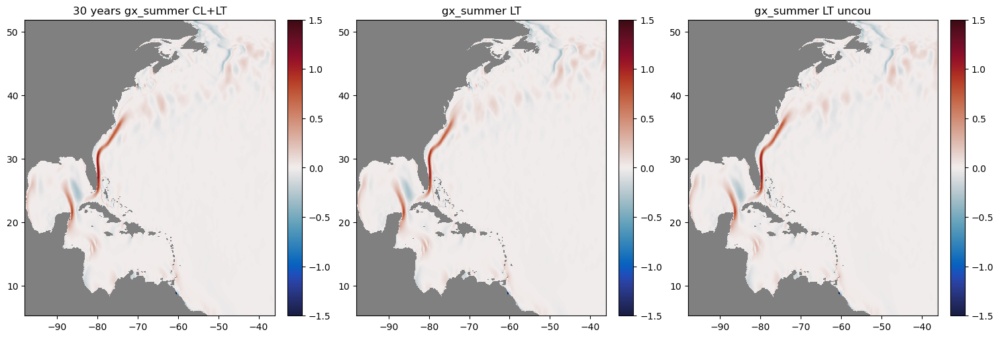

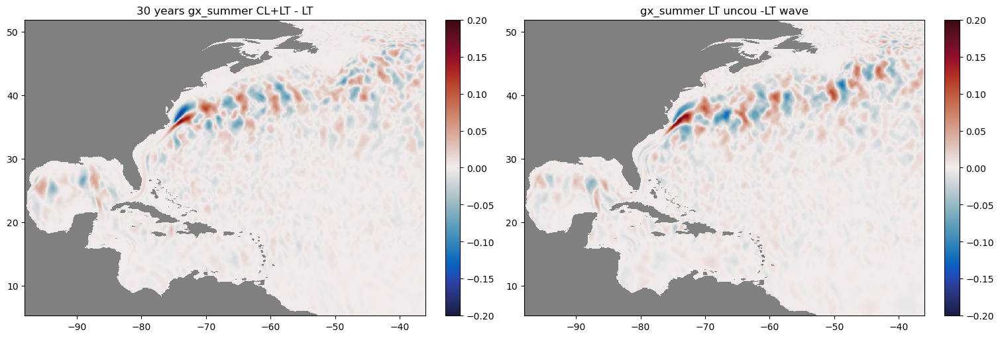

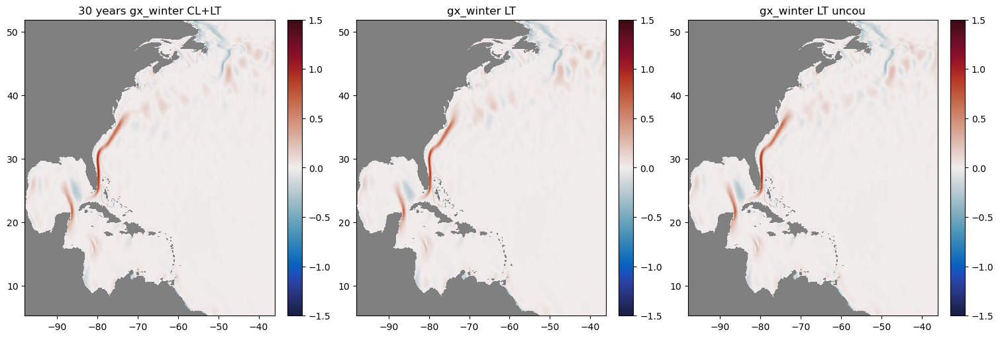

...

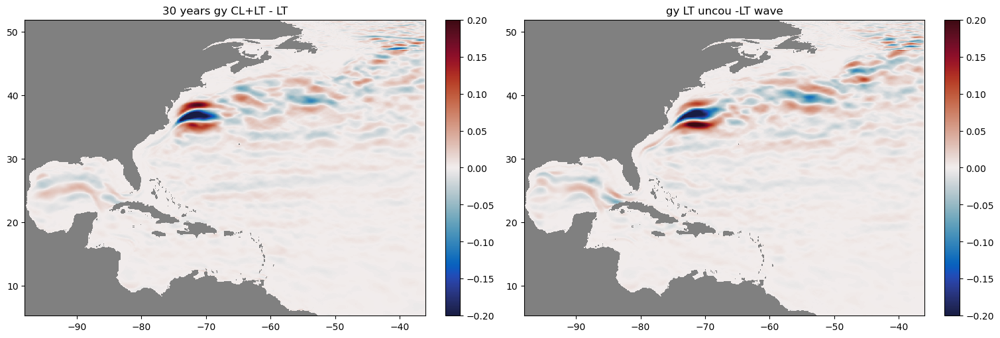

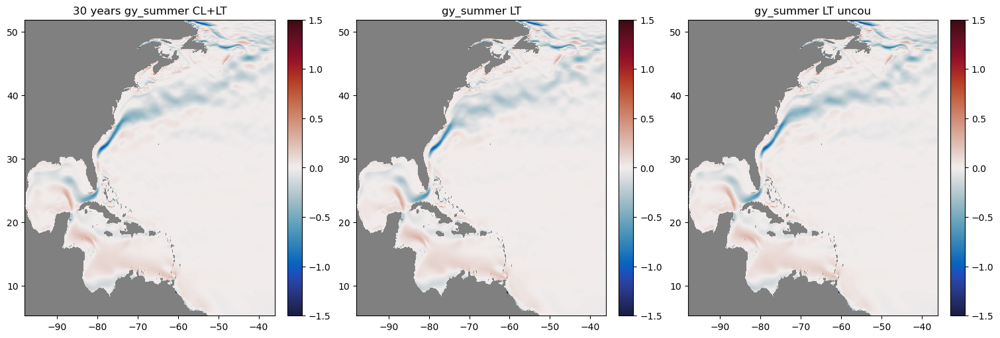

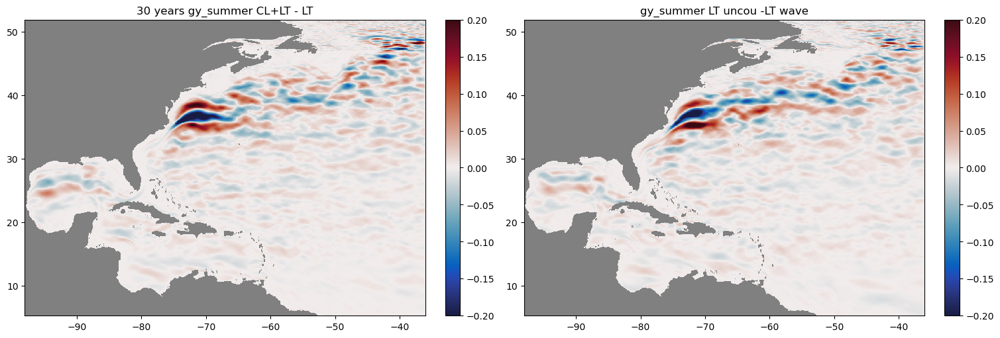

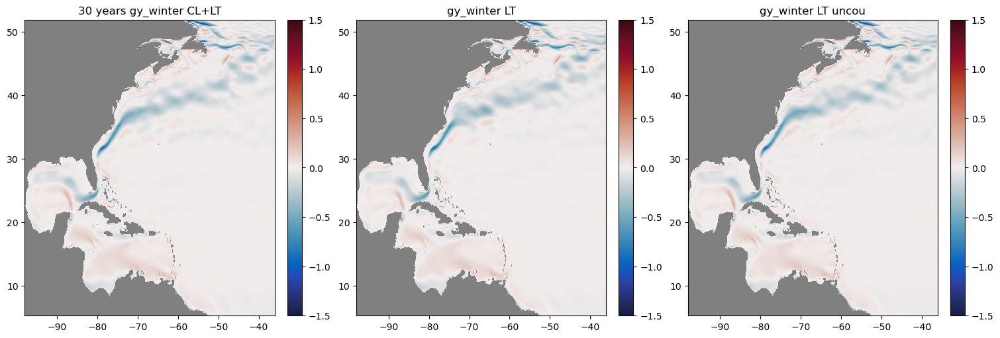

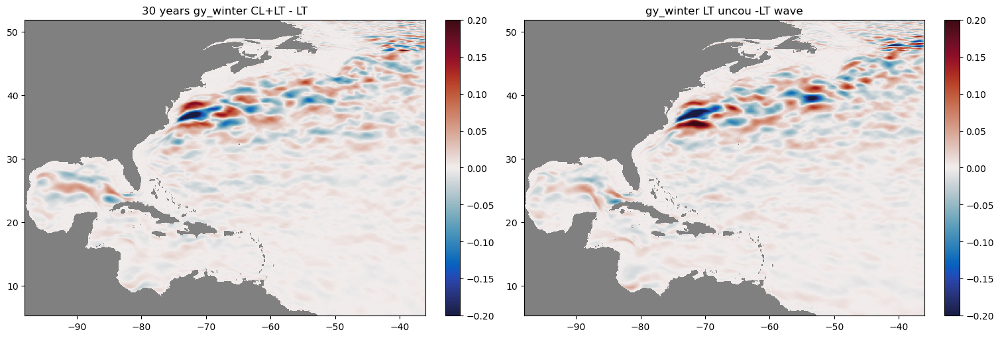

In [17]:
diff_gx_uncou=gx_uncou-gx_6_wave
diff_gx_all=gx_6_all-gx_6_wave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, gx_6_all , cmap=cmap, shading='auto',vmin=-1.5,vmax=1.5)
axes[0].set_title('30 years gx CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, gx_6_wave, cmap=cmap, shading='auto',vmin=-1.5,vmax=1.5)
axes[1].set_title('gx LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, gx_uncou, cmap=cmap, shading='auto',vmin=-1.5,vmax=1.5)
axes[2].set_title('gx LT uncou')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_gx_all , cmap=cmap, shading='auto',vmin=-0.2,vmax=0.2)
axes[0].set_title('30 years gx CL+LT - LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_gx_uncou, cmap=cmap, shading='auto',vmin=-0.2,vmax=0.2)
axes[1].set_title('gx LT uncou -LT wave')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
plt.show()

diff_gx_summer_uncou=gx_summer_uncou-gx_summer_6_wave
diff_gx_summer_all=gx_summer_6_all-gx_summer_6_wave

fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, gx_summer_6_all , cmap=cmap, shading='auto',vmin=-1.5,vmax=1.5)
axes[0].set_title('30 years gx_summer CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, gx_summer_6_wave, cmap=cmap, shading='auto',vmin=-1.5,vmax=1.5)
axes[1].set_title('gx_summer LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, gx_summer_uncou, cmap=cmap, shading='auto',vmin=-1.5,vmax=1.5)
axes[2].set_title('gx_summer LT uncou')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_gx_summer_all , cmap=cmap, shading='auto',vmin=-0.2,vmax=0.2)
axes[0].set_title('30 years gx_summer CL+LT - LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_gx_summer_uncou, cmap=cmap, shading='auto',vmin=-0.2,vmax=0.2)
axes[1].set_title('gx_summer LT uncou -LT wave')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
plt.show()

diff_gx_winter_uncou=gx_winter_uncou-gx_winter_6_wave
diff_gx_winter_all=gx_winter_6_all-gx_winter_6_wave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, gx_winter_6_all , cmap=cmap, shading='auto',vmin=-1.5,vmax=1.5)
axes[0].set_title('30 years gx_winter CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, gx_winter_6_wave, cmap=cmap, shading='auto',vmin=-1.5,vmax=1.5)
axes[1].set_title('gx_winter LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, gx_winter_uncou, cmap=cmap, shading='auto',vmin=-1.5,vmax=1.5)
axes[2].set_title('gx_winter LT uncou')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_gx_winter_all , cmap=cmap, shading='auto',vmin=-0.2,vmax=0.2)
axes[0].set_title('30 years gx_winter CL+LT - LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_gx_winter_uncou, cmap=cmap, shading='auto',vmin=-0.2,vmax=0.2)
axes[1].set_title('gx_winter LT uncou -LT wave')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
plt.show()


diff_gy_uncou=gy_uncou-gy_6_wave
diff_gy_all=gy_6_all-gy_6_wave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, gy_6_all , cmap=cmap, shading='auto',vmin=-1.5,vmax=1.5)
axes[0].set_title('30 years gy CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, gy_6_wave, cmap=cmap, shading='auto',vmin=-1.5,vmax=1.5)
axes[1].set_title('gy LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, gy_uncou, cmap=cmap, shading='auto',vmin=-1.5,vmax=1.5)
axes[2].set_title('gy LT uncou')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_gy_all , cmap=cmap, shading='auto',vmin=-0.2,vmax=0.2)
axes[0].set_title('30 years gy CL+LT - LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_gy_uncou, cmap=cmap, shading='auto',vmin=-0.2,vmax=0.2)
axes[1].set_title('gy LT uncou -LT wave')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
plt.show()

diff_gy_summer_uncou=gy_summer_uncou-gy_summer_6_wave
diff_gy_summer_all=gy_summer_6_all-gy_summer_6_wave

fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, gy_summer_6_all , cmap=cmap, shading='auto',vmin=-1.5,vmax=1.5)
axes[0].set_title('30 years gy_summer CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, gy_summer_6_wave, cmap=cmap, shading='auto',vmin=-1.5,vmax=1.5)
axes[1].set_title('gy_summer LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, gy_summer_uncou, cmap=cmap, shading='auto',vmin=-1.5,vmax=1.5)
axes[2].set_title('gy_summer LT uncou')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_gy_summer_all , cmap=cmap, shading='auto',vmin=-0.2,vmax=0.2)
axes[0].set_title('30 years gy_summer CL+LT - LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_gy_summer_uncou, cmap=cmap, shading='auto',vmin=-0.2,vmax=0.2)
axes[1].set_title('gy_summer LT uncou -LT wave')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
plt.show()

diff_gy_winter_uncou=gy_winter_uncou-gy_winter_6_wave
diff_gy_winter_all=gy_winter_6_all-gy_winter_6_wave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, gy_winter_6_all , cmap=cmap, shading='auto',vmin=-1.5,vmax=1.5)
axes[0].set_title('30 years gy_winter CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, gy_winter_6_wave, cmap=cmap, shading='auto',vmin=-1.5,vmax=1.5)
axes[1].set_title('gy_winter LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, gy_winter_uncou, cmap=cmap, shading='auto',vmin=-1.5,vmax=1.5)
axes[2].set_title('gy_winter LT uncou')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_gy_winter_all , cmap=cmap, shading='auto',vmin=-0.2,vmax=0.2)
axes[0].set_title('30 years gy_winter CL+LT - LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_gy_winter_uncou, cmap=cmap, shading='auto',vmin=-0.2,vmax=0.2)
axes[1].set_title('gy_winter LT uncou -LT wave')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
plt.show()

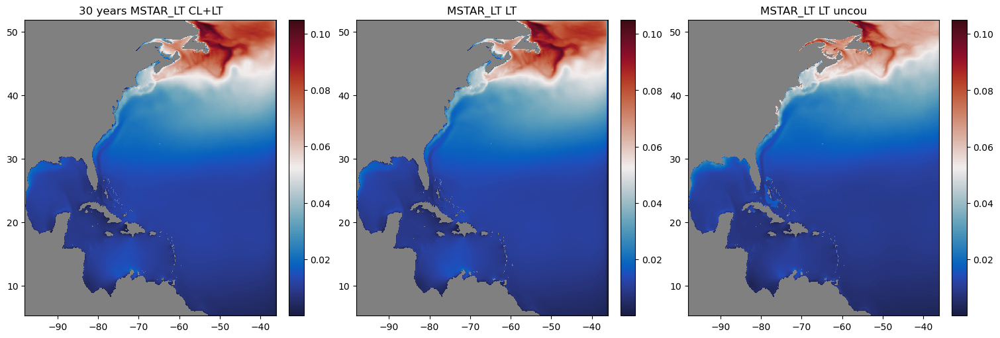

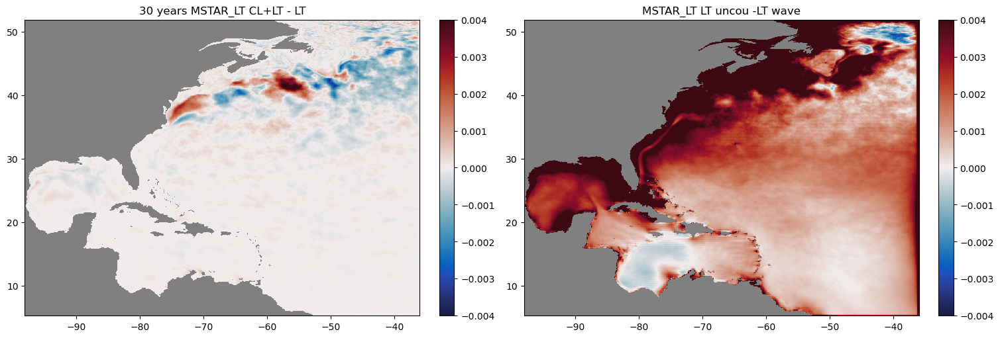

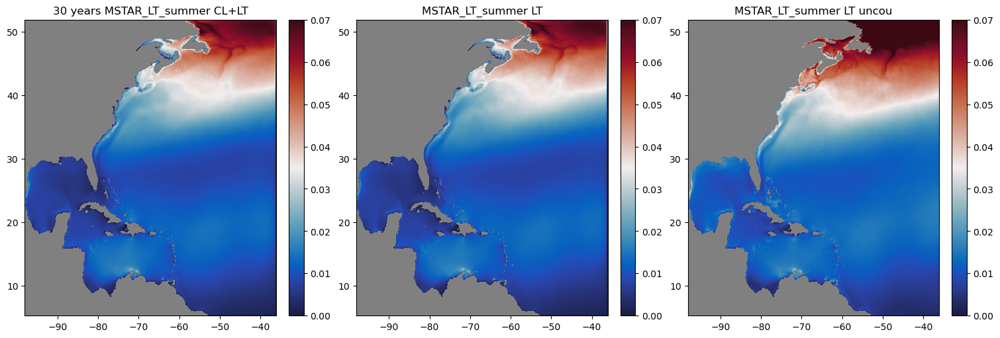

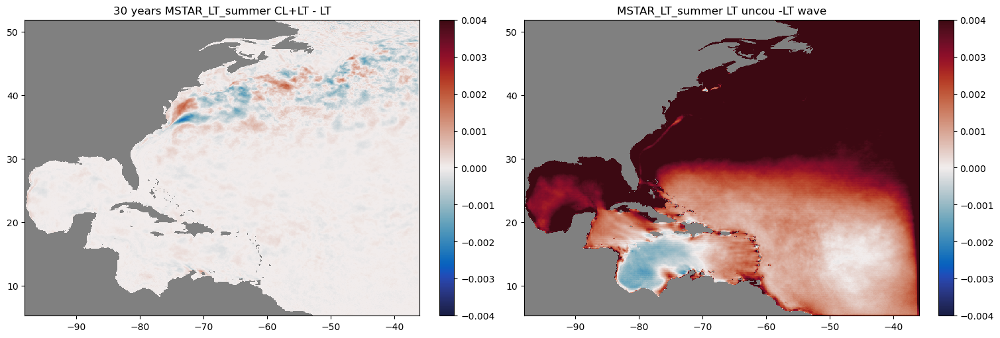

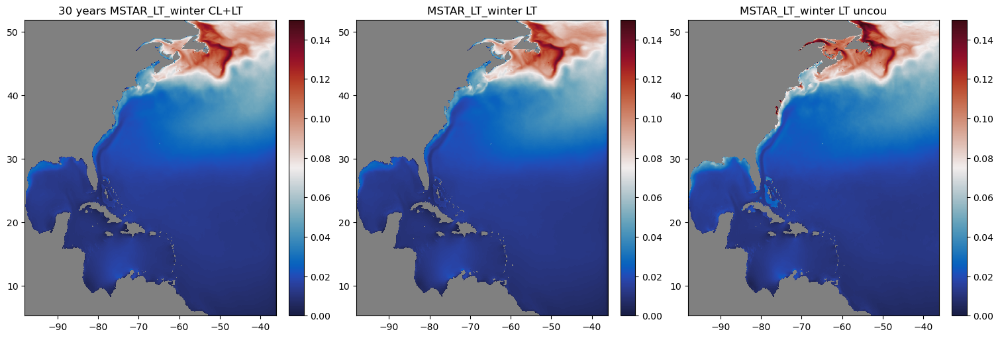

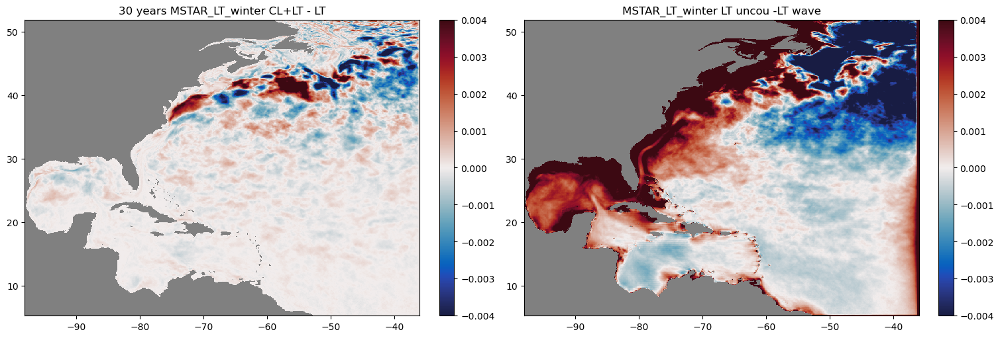

In [17]:
MSTAR_LT_uncou= Mcombined_data_uncou['MSTAR_LT']
MSTAR_LT_summer_uncou= Msummer_data_uncou['MSTAR_LT']
MSTAR_LT_winter_uncou= Mwinter_data_uncou['MSTAR_LT']
MSTAR_LT_uncou_ave=MSTAR_LT_uncou
MSTAR_LT_summer_uncou_ave=MSTAR_LT_summer_uncou
MSTAR_LT_winter_uncou_ave=MSTAR_LT_winter_uncou

MSTAR_LT_6_all= combined_data_6_all['MSTAR_LT']
MSTAR_LT_summer_6_all= summer_data_6_all['MSTAR_LT']
MSTAR_LT_winter_6_all= winter_data_6_all['MSTAR_LT']
MSTAR_LT_6_all_ave=MSTAR_LT_6_all
MSTAR_LT_summer_6_all_ave=MSTAR_LT_summer_6_all
MSTAR_LT_winter_6_all_ave=MSTAR_LT_winter_6_all

MSTAR_LT_6_wave= combined_data_6_wave['MSTAR_LT']
MSTAR_LT_summer_6_wave= summer_data_6_wave['MSTAR_LT']
MSTAR_LT_winter_6_wave= winter_data_6_wave['MSTAR_LT']
MSTAR_LT_6_wave_ave=MSTAR_LT_6_wave
MSTAR_LT_summer_6_wave_ave=MSTAR_LT_summer_6_wave
MSTAR_LT_winter_6_wave_ave=MSTAR_LT_winter_6_wave


diff_MSTAR_LT_uncou_ave=MSTAR_LT_uncou_ave-MSTAR_LT_6_wave_ave
diff_MSTAR_LT_all_ave=MSTAR_LT_6_all_ave-MSTAR_LT_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, MSTAR_LT_6_all_ave , cmap=cmap, shading='auto')
axes[0].set_title('30 years MSTAR_LT CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, MSTAR_LT_6_wave_ave, cmap=cmap, shading='auto')
axes[1].set_title('MSTAR_LT LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, MSTAR_LT_uncou_ave, cmap=cmap, shading='auto')
axes[2].set_title('MSTAR_LT LT uncou')
plt.colorbar(mesh2, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_MSTAR_LT_all_ave , cmap=cmap, shading='auto',vmin=-0.004,vmax=0.004)
axes[0].set_title('30 years MSTAR_LT CL+LT - LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_MSTAR_LT_uncou_ave, cmap=cmap, shading='auto',vmin=-0.004,vmax=0.004)
axes[1].set_title('MSTAR_LT LT uncou -LT wave')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

plt.show()


diff_MSTAR_LT_summer_uncou_ave=MSTAR_LT_summer_uncou_ave-MSTAR_LT_summer_6_wave_ave
diff_MSTAR_LT_summer_all_ave=MSTAR_LT_summer_6_all_ave-MSTAR_LT_summer_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, MSTAR_LT_summer_6_all_ave , cmap=cmap, shading='auto',vmin=0,vmax=0.07)
axes[0].set_title('30 years MSTAR_LT_summer CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, MSTAR_LT_summer_6_wave_ave, cmap=cmap, shading='auto',vmin=0,vmax=0.07)
axes[1].set_title('MSTAR_LT_summer LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, MSTAR_LT_summer_uncou_ave, cmap=cmap, shading='auto',vmin=0,vmax=0.07)
axes[2].set_title('MSTAR_LT_summer LT uncou')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot

# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_MSTAR_LT_summer_all_ave , cmap=cmap, shading='auto',vmin=-0.004,vmax=0.004)
axes[0].set_title('30 years MSTAR_LT_summer CL+LT - LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_MSTAR_LT_summer_uncou_ave, cmap=cmap, shading='auto',vmin=-0.004,vmax=0.004)
axes[1].set_title('MSTAR_LT_summer LT uncou -LT wave')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
plt.show()

diff_MSTAR_LT_winter_uncou_ave=MSTAR_LT_winter_uncou_ave-MSTAR_LT_winter_6_wave_ave
diff_MSTAR_LT_winter_all_ave=MSTAR_LT_winter_6_all_ave-MSTAR_LT_winter_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, MSTAR_LT_winter_6_all_ave , cmap=cmap, shading='auto',vmin=0,vmax=0.15)
axes[0].set_title('30 years MSTAR_LT_winter CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, MSTAR_LT_winter_6_wave_ave, cmap=cmap, shading='auto',vmin=0,vmax=0.15)
axes[1].set_title('MSTAR_LT_winter LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, MSTAR_LT_winter_uncou_ave, cmap=cmap, shading='auto',vmin=0,vmax=0.15)
axes[2].set_title('MSTAR_LT_winter LT uncou')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot

# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_MSTAR_LT_winter_all_ave , cmap=cmap, shading='auto',vmin=-0.004,vmax=0.004)
axes[0].set_title('30 years MSTAR_LT_winter CL+LT - LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_MSTAR_LT_winter_uncou_ave, cmap=cmap, shading='auto',vmin=-0.004,vmax=0.004)
axes[1].set_title('MSTAR_LT_winter LT uncou -LT wave')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot


plt.show()

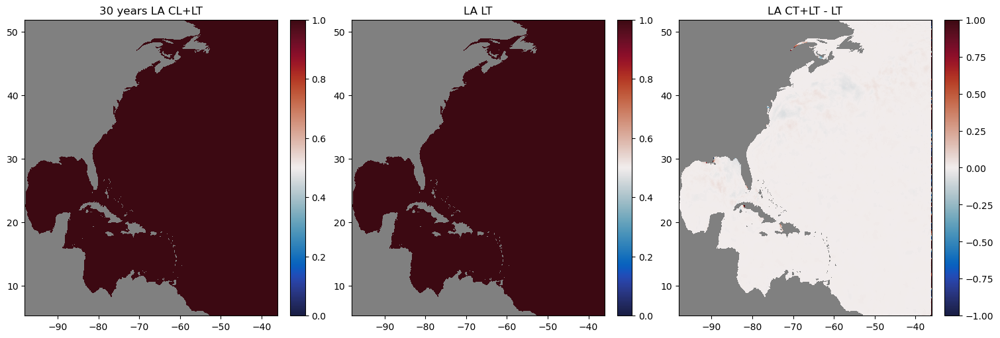

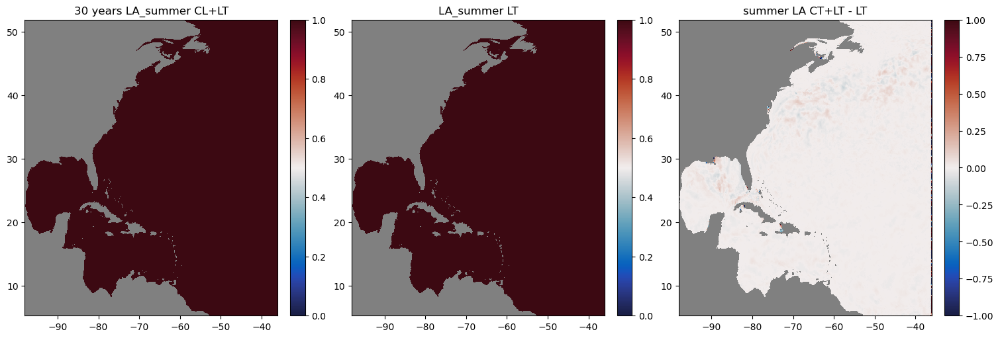

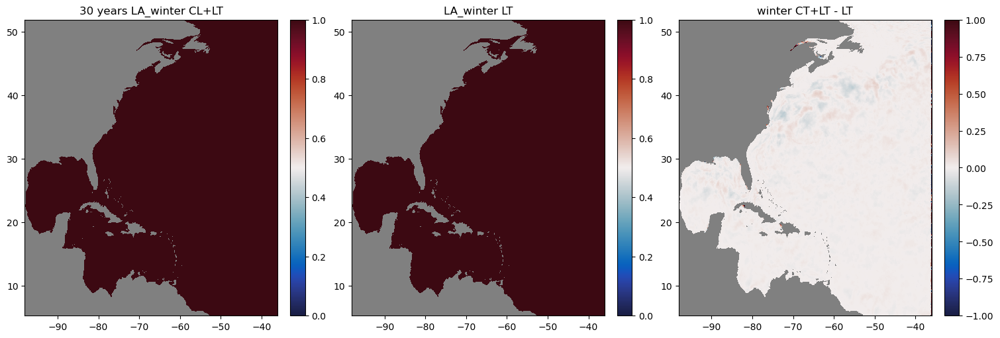

In [18]:

LA_6_all_ave= combined_data_6_all['LA']
LA_summer_6_all_ave= summer_data_6_all['LA']
LA_winter_6_all_ave= winter_data_6_all['LA']

LA_6_wave_ave= combined_data_6_wave['LA']
LA_summer_6_wave_ave= summer_data_6_wave['LA']
LA_winter_6_wave_ave= winter_data_6_wave['LA']


diff_LA_all_ave=LA_6_all_ave-LA_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, LA_6_all_ave , cmap=cmap, shading='auto',vmin=0,vmax=1)
axes[0].set_title('30 years LA CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, LA_6_wave_ave, cmap=cmap, shading='auto',vmin=0,vmax=1)
axes[1].set_title('LA LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, diff_LA_all_ave, cmap=cmap, shading='auto',vmin=-1,vmax=1)
axes[2].set_title('LA CT+LT - LT')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()




diff_LA_summer_all_ave=LA_summer_6_all_ave-LA_summer_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, LA_summer_6_all_ave , cmap=cmap, shading='auto',vmin=0,vmax=1)
axes[0].set_title('30 years LA_summer CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, LA_summer_6_wave_ave, cmap=cmap, shading='auto',vmin=0,vmax=1)
axes[1].set_title('LA_summer LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, diff_LA_summer_all_ave, cmap=cmap, shading='auto',vmin=-1,vmax=1)
axes[2].set_title('summer LA CT+LT - LT')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()



diff_LA_winter_all_ave=LA_winter_6_all_ave-LA_winter_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, LA_winter_6_all_ave , cmap=cmap, shading='auto',vmin=0,vmax=1)
axes[0].set_title('30 years LA_winter CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, LA_winter_6_wave_ave, cmap=cmap, shading='auto',vmin=0,vmax=1)
axes[1].set_title('LA_winter LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, diff_LA_winter_all_ave, cmap=cmap, shading='auto',vmin=-1,vmax=1)
axes[2].set_title('winter CT+LT - LT')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()

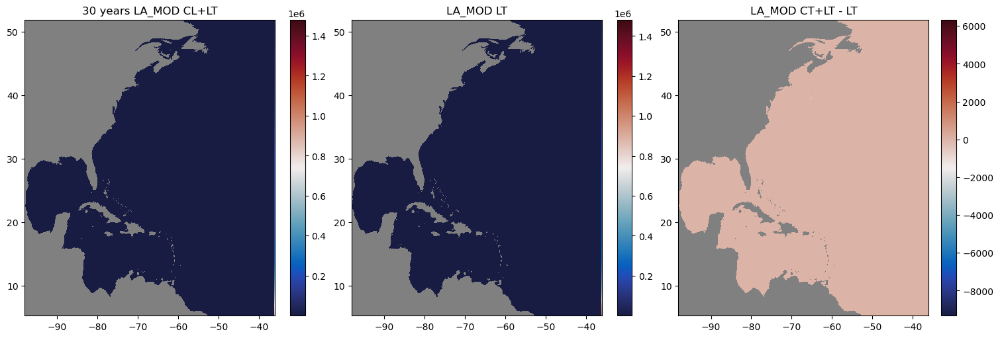

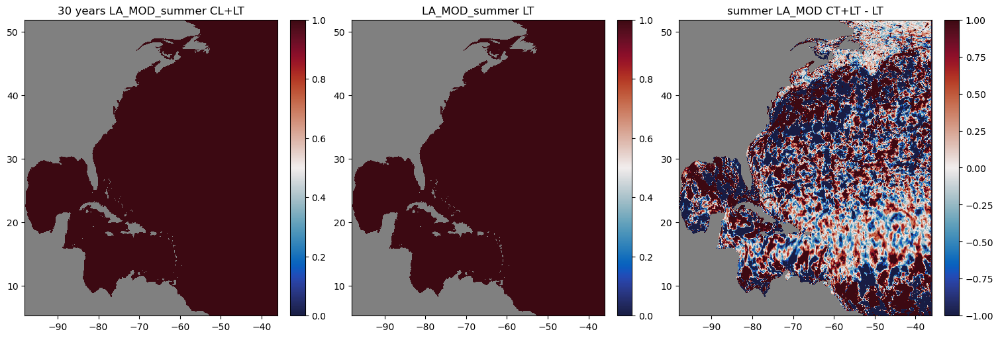

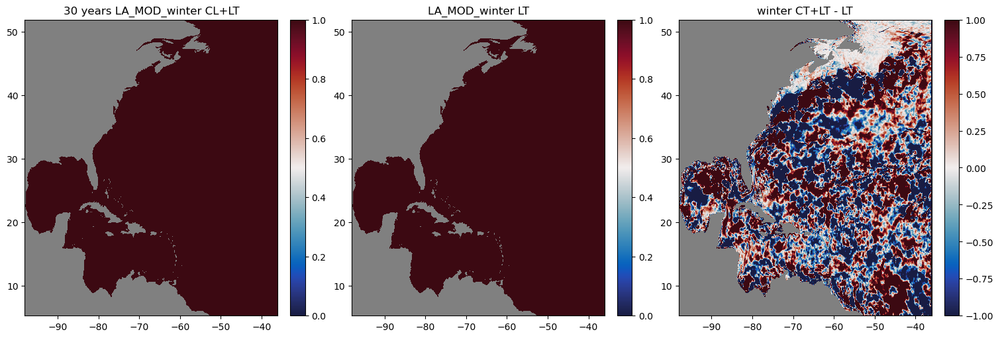

In [19]:
LA_MOD_6_all_ave= combined_data_6_all['LA_MOD']
LA_MOD_summer_6_all_ave= summer_data_6_all['LA_MOD']
LA_MOD_winter_6_all_ave= winter_data_6_all['LA_MOD']

LA_MOD_6_wave_ave= combined_data_6_wave['LA_MOD']
LA_MOD_summer_6_wave_ave= summer_data_6_wave['LA_MOD']
LA_MOD_winter_6_wave_ave= winter_data_6_wave['LA_MOD']


diff_LA_MOD_all_ave=LA_MOD_6_all_ave-LA_MOD_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, LA_MOD_6_all_ave , cmap=cmap, shading='auto')
axes[0].set_title('30 years LA_MOD CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, LA_MOD_6_wave_ave, cmap=cmap, shading='auto')
axes[1].set_title('LA_MOD LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, diff_LA_MOD_all_ave, cmap=cmap, shading='auto')
axes[2].set_title('LA_MOD CT+LT - LT')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()




diff_LA_MOD_summer_all_ave=LA_MOD_summer_6_all_ave-LA_MOD_summer_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, LA_MOD_summer_6_all_ave , cmap=cmap, shading='auto',vmin=0,vmax=1)
axes[0].set_title('30 years LA_MOD_summer CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, LA_MOD_summer_6_wave_ave, cmap=cmap, shading='auto',vmin=0,vmax=1)
axes[1].set_title('LA_MOD_summer LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, diff_LA_MOD_summer_all_ave, cmap=cmap, shading='auto',vmin=-1,vmax=1)
axes[2].set_title('summer LA_MOD CT+LT - LT')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()



diff_LA_MOD_winter_all_ave=LA_MOD_winter_6_all_ave-LA_MOD_winter_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, LA_MOD_winter_6_all_ave , cmap=cmap, shading='auto',vmin=0,vmax=1)
axes[0].set_title('30 years LA_MOD_winter CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, LA_MOD_winter_6_wave_ave, cmap=cmap, shading='auto',vmin=0,vmax=1)
axes[1].set_title('LA_MOD_winter LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, diff_LA_MOD_winter_all_ave, cmap=cmap, shading='auto',vmin=-1,vmax=1)
axes[2].set_title('winter CT+LT - LT')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()

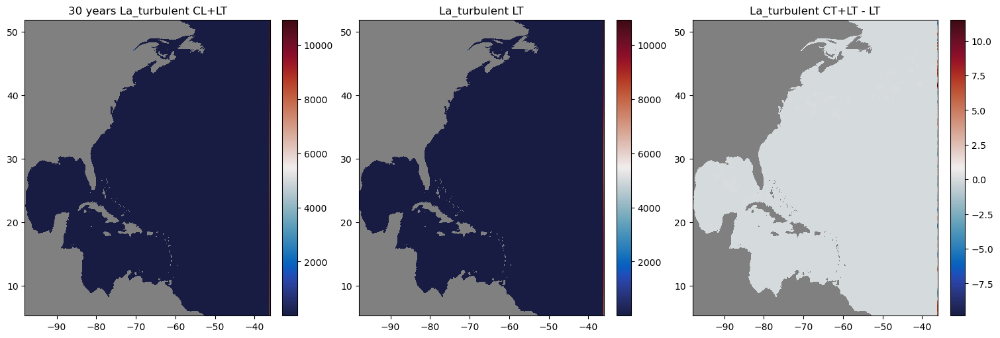

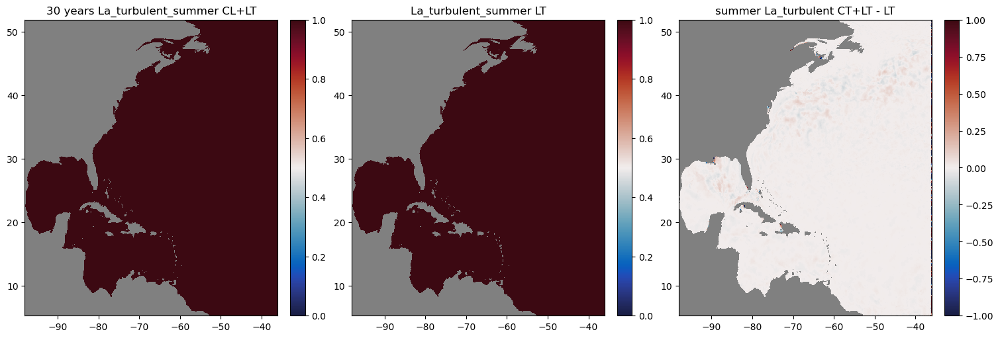

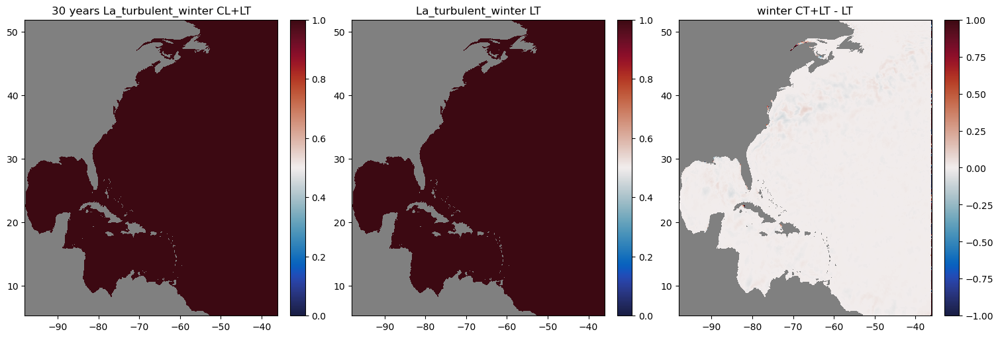

In [20]:
La_turbulent_6_all_ave= combined_data_6_all['La_turbulent']
La_turbulent_summer_6_all_ave= summer_data_6_all['La_turbulent']
La_turbulent_winter_6_all_ave= winter_data_6_all['La_turbulent']

La_turbulent_6_wave_ave= combined_data_6_wave['La_turbulent']
La_turbulent_summer_6_wave_ave= summer_data_6_wave['La_turbulent']
La_turbulent_winter_6_wave_ave= winter_data_6_wave['La_turbulent']


diff_La_turbulent_all_ave=La_turbulent_6_all_ave-La_turbulent_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, La_turbulent_6_all_ave , cmap=cmap, shading='auto')
axes[0].set_title('30 years La_turbulent CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, La_turbulent_6_wave_ave, cmap=cmap, shading='auto')
axes[1].set_title('La_turbulent LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, diff_La_turbulent_all_ave, cmap=cmap, shading='auto')
axes[2].set_title('La_turbulent CT+LT - LT')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()




diff_La_turbulent_summer_all_ave=La_turbulent_summer_6_all_ave-La_turbulent_summer_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, La_turbulent_summer_6_all_ave , cmap=cmap, shading='auto',vmin=0,vmax=1)
axes[0].set_title('30 years La_turbulent_summer CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, La_turbulent_summer_6_wave_ave, cmap=cmap, shading='auto',vmin=0,vmax=1)
axes[1].set_title('La_turbulent_summer LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, diff_La_turbulent_summer_all_ave, cmap=cmap, shading='auto',vmin=-1,vmax=1)
axes[2].set_title('summer La_turbulent CT+LT - LT')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()



diff_La_turbulent_winter_all_ave=La_turbulent_winter_6_all_ave-La_turbulent_winter_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, La_turbulent_winter_6_all_ave , cmap=cmap, shading='auto',vmin=0,vmax=1)
axes[0].set_title('30 years La_turbulent_winter CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, La_turbulent_winter_6_wave_ave, cmap=cmap, shading='auto',vmin=0,vmax=1)
axes[1].set_title('La_turbulent_winter LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, diff_La_turbulent_winter_all_ave, cmap=cmap, shading='auto',vmin=-1,vmax=1)
axes[2].set_title('winter CT+LT - LT')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()

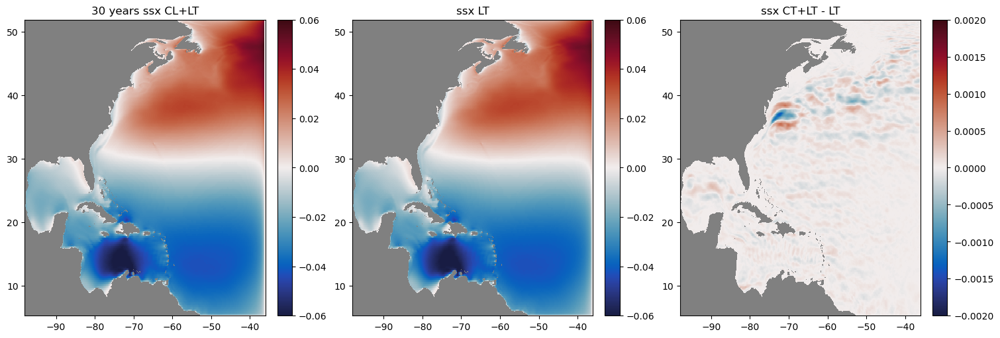

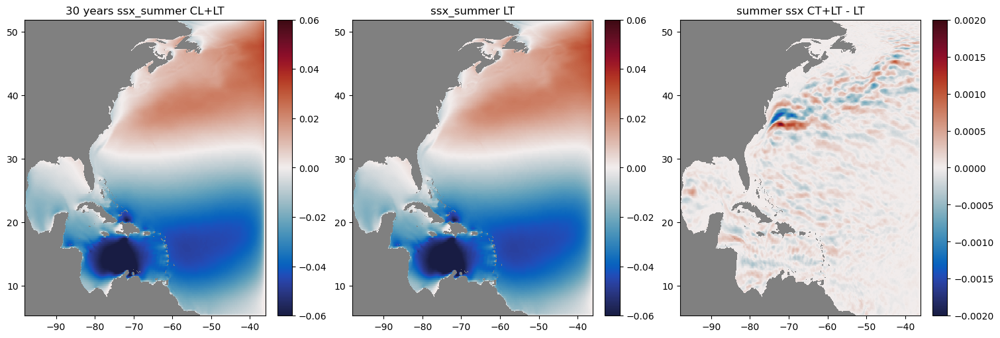

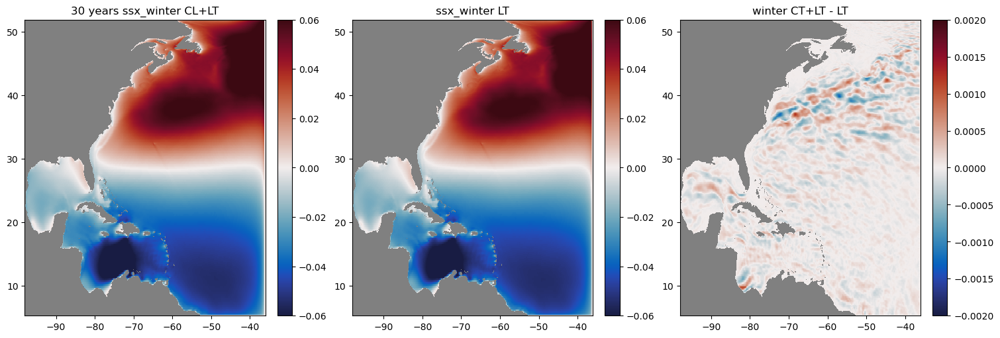

In [21]:
ssx_6_all_ave= combined_data_6_all['surface_stokes_x'][:,1:]
ssx_summer_6_all_ave= summer_data_6_all['surface_stokes_x'][:,1:]
ssx_winter_6_all_ave= winter_data_6_all['surface_stokes_x'][:,1:]

ssx_6_wave_ave= combined_data_6_wave['surface_stokes_x'][:,1:]
ssx_summer_6_wave_ave= summer_data_6_wave['surface_stokes_x'][:,1:]
ssx_winter_6_wave_ave= winter_data_6_wave['surface_stokes_x'][:,1:]
diff_ssx_all_ave=ssx_6_all_ave-ssx_6_wave_ave



fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, ssx_6_all_ave , cmap=cmap, shading='auto',vmin=-0.06,vmax=0.06)
axes[0].set_title('30 years ssx CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, ssx_6_wave_ave, cmap=cmap, shading='auto',vmin=-0.06,vmax=0.06)
axes[1].set_title('ssx LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, diff_ssx_all_ave, cmap=cmap, shading='auto',vmin=-0.002,vmax=0.002)
axes[2].set_title('ssx CT+LT - LT')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()




diff_ssx_summer_all_ave=ssx_summer_6_all_ave-ssx_summer_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, ssx_summer_6_all_ave , cmap=cmap, shading='auto',vmin=-0.06,vmax=0.06)
axes[0].set_title('30 years ssx_summer CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, ssx_summer_6_wave_ave, cmap=cmap, shading='auto',vmin=-0.06,vmax=0.06)
axes[1].set_title('ssx_summer LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, diff_ssx_summer_all_ave, cmap=cmap, shading='auto',vmin=-0.002,vmax=0.002)
axes[2].set_title('summer ssx CT+LT - LT')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()



diff_ssx_winter_all_ave=ssx_winter_6_all_ave-ssx_winter_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, ssx_winter_6_all_ave , cmap=cmap, shading='auto',vmin=-0.06,vmax=0.06)
axes[0].set_title('30 years ssx_winter CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, ssx_winter_6_wave_ave, cmap=cmap, shading='auto',vmin=-0.06,vmax=0.06)
axes[1].set_title('ssx_winter LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, diff_ssx_winter_all_ave, cmap=cmap, shading='auto',vmin=-0.002,vmax=0.002)
axes[2].set_title('winter CT+LT - LT')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()

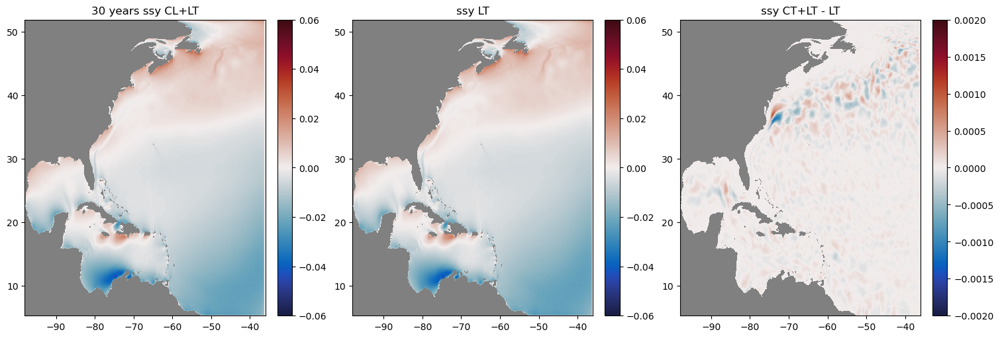

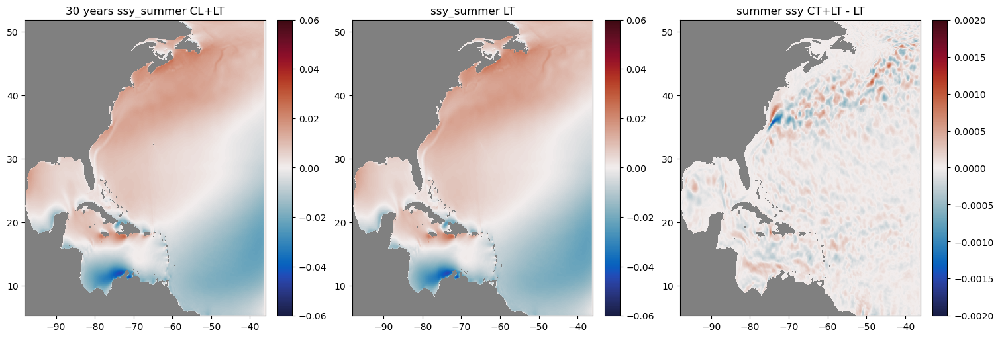

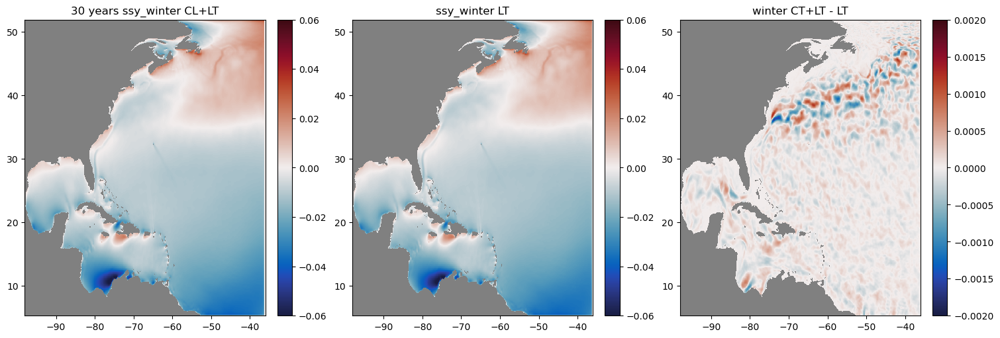

In [22]:
ssy_6_all_ave= combined_data_6_all['surface_stokes_y'][1:,:]
ssy_summer_6_all_ave= summer_data_6_all['surface_stokes_y'][1:,:]
ssy_winter_6_all_ave= winter_data_6_all['surface_stokes_y'][1:,:]

ssy_6_wave_ave= combined_data_6_wave['surface_stokes_y'][1:,:]
ssy_summer_6_wave_ave= summer_data_6_wave['surface_stokes_y'][1:,:]
ssy_winter_6_wave_ave= winter_data_6_wave['surface_stokes_y'][1:,:]
diff_ssy_all_ave=ssy_6_all_ave-ssy_6_wave_ave



fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, ssy_6_all_ave , cmap=cmap, shading='auto',vmin=-0.06,vmax=0.06)
axes[0].set_title('30 years ssy CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, ssy_6_wave_ave, cmap=cmap, shading='auto',vmin=-0.06,vmax=0.06)
axes[1].set_title('ssy LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, diff_ssy_all_ave, cmap=cmap, shading='auto',vmin=-0.002,vmax=0.002)
axes[2].set_title('ssy CT+LT - LT')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()




diff_ssy_summer_all_ave=ssy_summer_6_all_ave-ssy_summer_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, ssy_summer_6_all_ave , cmap=cmap, shading='auto',vmin=-0.06,vmax=0.06)
axes[0].set_title('30 years ssy_summer CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, ssy_summer_6_wave_ave, cmap=cmap, shading='auto',vmin=-0.06,vmax=0.06)
axes[1].set_title('ssy_summer LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, diff_ssy_summer_all_ave, cmap=cmap, shading='auto',vmin=-0.002,vmax=0.002)
axes[2].set_title('summer ssy CT+LT - LT')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()



diff_ssy_winter_all_ave=ssy_winter_6_all_ave-ssy_winter_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, ssy_winter_6_all_ave , cmap=cmap, shading='auto',vmin=-0.06,vmax=0.06)
axes[0].set_title('30 years ssy_winter CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, ssy_winter_6_wave_ave, cmap=cmap, shading='auto',vmin=-0.06,vmax=0.06)
axes[1].set_title('ssy_winter LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, diff_ssy_winter_all_ave, cmap=cmap, shading='auto',vmin=-0.002,vmax=0.002)
axes[2].set_title('winter CT+LT - LT')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()

In [5]:


print("Summer wave data shape:", summer_wave.shape)
print("Winter wave data shape:", winter_wave.shape)
dates

Summer dates: []
Winter dates: [cftime.DatetimeGregorian(1993, 1, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 1, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 1, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 1, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 1, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 1, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 1, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 1, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 1, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 1, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 1, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 1, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 1, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 1, 14, 0, 

array([cftime.DatetimeGregorian(1993, 1, 1, 0, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(1993, 1, 2, 0, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(1993, 1, 3, 0, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(1993, 1, 4, 0, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(1993, 1, 5, 0, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(1993, 1, 6, 0, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(1993, 1, 7, 0, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(1993, 1, 8, 0, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(1993, 1, 9, 0, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(1993, 1, 10, 0, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(1993, 1, 11, 0, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(1993, 1, 12, 0, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(1993, 1, 13, 0, 0, 0, 0, has_

In [18]:
import numpy as np
import logging
from netCDF4 import Dataset, num2date
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import AxesGrid
import xarray as xr
import os
import logging
import cmocean
import copy
from datetime import datetime, timedelta

cmocean.cm.balance
cmap = copy.copy(cmocean.cm.balance)
cmap.set_bad('gray')   
###first verage every year and then concate

pp_root_uncou = "/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/"
pp_root_uncou_LAfalse="/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou_LALTFalse/"
pp_root_12_all="/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_wave_all/"
pp_root_12_wave="/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_wave/"
pp_root_6_all="/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/"
pp_root_6_wave="/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/"

def Extend_file_list(file_list):
    transformed_file_list = []
    
    for date in file_list:
        year_month = date[:6]  # Extract YYYYMM
        date_1 = year_month + "01"
        ndate = int(year_month)
        
        # Generate date_2 to date_7 as integer year_month values
        date_2 = str(ndate + 1)
        date_3 = str(ndate + 2)
        date_4 = str(ndate + 3)
        date_5 = str(ndate + 4)
        date_6 = str(ndate + 5)
        date_7 = str(ndate + 6)
    
        # If moving to the 13th month, roll over to next January
        if int(date_7[-2:]) > 12:
            date_7 = str(int(date_7[:4]) + 1) + "01"  # Roll over to next January
        else:
            date_7 = str(ndate + 6)  # Keep it as is if the month doesn't exceed 12
        
        list_date = [date_1, date_2, date_3, date_4, date_5, date_6, date_7]
        
        for date_str in list_date:
            # Create the transformed file string
            transformed_file = f"{date_1}_results/ww3.{date_str}.nc"
            transformed_file_list.append(transformed_file)
    return transformed_file_list

    
def hs_mean_from_files(pp_root, file_list, model_grid_x, model_grid_y):
    data={}
    S_data={}
    W_data={}
    hs_data = []
    cur_data = []
    wnd_data = []
    S_hs_data = []
    S_cur_data = []
    S_wnd_data = []
    W_hs_data = []
    W_cur_data = []
    W_wnd_data = []
    E_file_list=Extend_file_list(file_list)

    for date_str in E_file_list:
        file_path = os.path.join(pp_root, date_str)
        print(file_path)
        if os.path.exists(file_path):
            try:
                ww3 = Dataset(file_path)
                hs = ww3.variables['hs'][:]
                t = ww3.variables['time'][:]
                ucur = ww3.variables['ucur'][:]
                vcur = ww3.variables['vcur'][:]
                uwnd = ww3.variables['uwnd'][:]
                vwnd = ww3.variables['vwnd'][:]

                cur = np.sqrt(ucur**2 + vcur**2)
                wnd = np.sqrt(uwnd**2 + vwnd**2)

                da_hs = xr.DataArray(hs, dims=['time', 'yh', 'xh'], coords={'time': t, 'xh': model_grid_x, 'yh': model_grid_y})
                da_cur = xr.DataArray(cur, dims=['time', 'yh', 'xh'], coords={'time': t, 'xh': model_grid_x, 'yh': model_grid_y})
                da_wnd = xr.DataArray(wnd, dims=['time', 'yh', 'xh'], coords={'time': t, 'xh': model_grid_x, 'yh': model_grid_y})

                hs_data.append(da_hs.mean(dim='time', skipna=True))
                cur_data.append(da_cur.mean(dim='time', skipna=True))
                wnd_data.append(da_wnd.mean(dim='time', skipna=True))
               

                time_units = ww3.variables['time'].units
                time_calendar = getattr(ww3.variables['time'], 'calendar', 'standard')
                dates = num2date(t, units=time_units, calendar=time_calendar)
                dates = np.array(dates)
                summer_indices = np.array([d.month in [6, 7, 8] for d in dates])
                winter_indices = np.array([d.month in [12, 1, 2] for d in dates])
                
                # Extract summer and winter dates
                summer_dates = dates[summer_indices]
                winter_dates = dates[winter_indices]
                # print("Summer dates:", summer_dates)
                # print("Winter dates:", winter_dates)
                if len(summer_dates) > 0:
                    summer_hs = hs[summer_indices]
                    da_summer_hs = xr.DataArray(summer_hs, dims=['time', 'yh', 'xh'], coords={'time':summer_dates , 'xh': model_grid_x, 'yh': model_grid_y})
                    S_hs_data.append(da_summer_hs.mean(dim='time', skipna=True))
                    summer_cur = cur[summer_indices]
                    da_summer_cur = xr.DataArray(summer_cur, dims=['time', 'yh', 'xh'], coords={'time':summer_dates , 'xh': model_grid_x, 'yh': model_grid_y})
                    S_cur_data.append(da_summer_cur.mean(dim='time', skipna=True))
                    summer_wnd = wnd[summer_indices]
                    da_summer_wnd = xr.DataArray(summer_wnd, dims=['time', 'yh', 'xh'], coords={'time':summer_dates , 'xh': model_grid_x, 'yh': model_grid_y})
                    S_wnd_data.append(da_summer_wnd.mean(dim='time', skipna=True))
                if len(winter_dates) > 0:
                    winter_hs = hs[winter_indices]
                    da_winter_hs = xr.DataArray(winter_hs, dims=['time', 'yh', 'xh'], coords={'time':winter_dates , 'xh': model_grid_x, 'yh': model_grid_y})
                    W_hs_data.append(da_winter_hs.mean(dim='time', skipna=True))
                    winter_cur = cur[winter_indices]
                    da_winter_cur = xr.DataArray(winter_cur, dims=['time', 'yh', 'xh'], coords={'time':winter_dates , 'xh': model_grid_x, 'yh': model_grid_y})
                    W_cur_data.append(da_winter_cur.mean(dim='time', skipna=True))
                    winter_wnd = wnd[winter_indices]
                    da_winter_wnd = xr.DataArray(winter_wnd, dims=['time', 'yh', 'xh'], coords={'time':winter_dates , 'xh': model_grid_x, 'yh': model_grid_y})
                    W_wnd_data.append(da_winter_wnd.mean(dim='time', skipna=True))
                    
               

            except Exception as e:
                print(f"Error processing file {file_path}: {e}")
        else:
            print(f"File not found: {file_path}")

    data['hs'] = xr.concat(hs_data, dim='time').mean(dim='time', skipna=True) if hs_data else None
    data['cur'] = xr.concat(cur_data, dim='time').mean(dim='time', skipna=True) if cur_data else None
    data['wnd'] = xr.concat(wnd_data, dim='time').mean(dim='time', skipna=True) if wnd_data else None
    
    S_data['hs'] = xr.concat(S_hs_data, dim='time').mean(dim='time', skipna=True) if hs_data else None
    S_data['cur'] = xr.concat(S_cur_data, dim='time').mean(dim='time', skipna=True) if cur_data else None
    S_data['wnd'] = xr.concat(S_wnd_data, dim='time').mean(dim='time', skipna=True) if wnd_data else None

    W_data['hs'] = xr.concat(W_hs_data, dim='time').mean(dim='time', skipna=True) if hs_data else None
    W_data['cur'] = xr.concat(W_cur_data, dim='time').mean(dim='time', skipna=True) if cur_data else None
    W_data['wnd'] = xr.concat(W_wnd_data, dim='time').mean(dim='time', skipna=True) if wnd_data else None
    return data, S_data, W_data
    

file_list = [
    "19930101",
    "19930701",
    "19940101",
    "19940701",
    "19950101",
    "19950701",
    "19960101",
    "19960701",
    "19970101",
    "19970701",
    "19980101",
    "19980701",
    "19990101",
    "19990701",
    "20000101",
    "20000701",
    "20010101",
    "20010701",
    "20020101",
    "20020701",
    "20030101",
    "20030701",
    "20040101",
    "20040701",
    "20050101",
    "20050701",
    "20060101",
    "20060701",
    "20070101",
    "20070701",
    "20080101",
    "20080701",
    "20090101",
    "20090701",
    "20100101",
    "20100701",
    "20110101",
    "20110701",
    "20120101",
    "20120701",
    "20130101",
    "20130701",
    "20140101",
    "20140701",
    "20150101",
    "20150701",
    "20160101",
    "20160701",
    "20170101",
    "20170701",
    "20180101",
    "20180701",
    "20190101",
    "20190701",
    "20200101",
    "20200701",
    "20210101",
    "20210701",
    "20220101",
    "20220701",
]

ww3_1 = Dataset("/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19930101_results/ww3.19930101.nc")
model_grid_x_6=ww3_1.variables['longitude'][0,:]
model_grid_y_6=ww3_1.variables['latitude'][:,0]

data_6_wave,S_data_6_wave, W_data_6_wave=hs_mean_from_files(pp_root_6_wave, file_list, model_grid_x_6, model_grid_y_6) 
data_6_all,S_data_6_all, W_data_6_all=hs_mean_from_files(pp_root_6_all, file_list, model_grid_x_6, model_grid_y_6) 




/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19930101_results/ww3.19930101.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19930101_results/ww3.199302.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19930101_results/ww3.199303.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19930101_results/ww3.199304.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19930101_results/ww3.199305.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19930101_results/ww3.199306.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19930101_results/ww3.199307.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19930701_results/ww3.19930701.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19930701_results/ww3.199308.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19930701_results/ww3.199309.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19930701_results/ww3.199310.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19930701_results/ww3.199311.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19930701_results/ww3.199312.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19930701_results/ww3.199401.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19940101_results/ww3.19940101.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19940101_results/ww3.199402.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19940101_results/ww3.199403.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19940101_results/ww3.199404.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19940101_results/ww3.199405.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19940101_results/ww3.199406.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19940101_results/ww3.199407.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19940701_results/ww3.19940701.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19940701_results/ww3.199408.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19940701_results/ww3.199409.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19940701_results/ww3.199410.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19940701_results/ww3.199411.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19940701_results/ww3.199412.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19940701_results/ww3.199501.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19950101_results/ww3.19950101.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19950101_results/ww3.199502.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19950101_results/ww3.199503.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19950101_results/ww3.199504.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19950101_results/ww3.199505.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19950101_results/ww3.199506.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19950101_results/ww3.199507.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19950701_results/ww3.19950701.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19950701_results/ww3.199508.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19950701_results/ww3.199509.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19950701_results/ww3.199510.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19950701_results/ww3.199511.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19950701_results/ww3.199512.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19950701_results/ww3.199601.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19960101_results/ww3.19960101.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19960101_results/ww3.199602.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19960101_results/ww3.199603.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19960101_results/ww3.199604.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19960101_results/ww3.199605.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19960101_results/ww3.199606.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19960101_results/ww3.199607.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19960701_results/ww3.19960701.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19960701_results/ww3.199608.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19960701_results/ww3.199609.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19960701_results/ww3.199610.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19960701_results/ww3.199611.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19960701_results/ww3.199612.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19960701_results/ww3.199701.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19970101_results/ww3.19970101.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19970101_results/ww3.199702.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19970101_results/ww3.199703.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19970101_results/ww3.199704.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19970101_results/ww3.199705.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19970101_results/ww3.199706.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19970101_results/ww3.199707.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19970701_results/ww3.19970701.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19970701_results/ww3.199708.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19970701_results/ww3.199709.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19970701_results/ww3.199710.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19970701_results/ww3.199711.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19970701_results/ww3.199712.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19970701_results/ww3.199801.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19980101_results/ww3.19980101.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19980101_results/ww3.199802.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19980101_results/ww3.199803.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19980101_results/ww3.199804.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19980101_results/ww3.199805.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19980101_results/ww3.199806.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19980101_results/ww3.199807.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19980701_results/ww3.19980701.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19980701_results/ww3.199808.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19980701_results/ww3.199809.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19980701_results/ww3.199810.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19980701_results/ww3.199811.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19980701_results/ww3.199812.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19980701_results/ww3.199901.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19990101_results/ww3.19990101.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19990101_results/ww3.199902.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19990101_results/ww3.199903.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19990101_results/ww3.199904.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19990101_results/ww3.199905.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19990101_results/ww3.199906.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19990101_results/ww3.199907.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19990701_results/ww3.19990701.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19990701_results/ww3.199908.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19990701_results/ww3.199909.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19990701_results/ww3.199910.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19990701_results/ww3.199911.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19990701_results/ww3.199912.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19990701_results/ww3.200001.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20000101_results/ww3.20000101.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20000101_results/ww3.200002.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20000101_results/ww3.200003.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20000101_results/ww3.200004.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20000101_results/ww3.200005.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20000101_results/ww3.200006.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20000101_results/ww3.200007.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20000701_results/ww3.20000701.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20000701_results/ww3.200008.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20000701_results/ww3.200009.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20000701_results/ww3.200010.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20000701_results/ww3.200011.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20000701_results/ww3.200012.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20000701_results/ww3.200101.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20010101_results/ww3.20010101.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20010101_results/ww3.200102.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20010101_results/ww3.200103.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20010101_results/ww3.200104.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20010101_results/ww3.200105.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20010101_results/ww3.200106.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20010101_results/ww3.200107.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20010701_results/ww3.20010701.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20010701_results/ww3.200108.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20010701_results/ww3.200109.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20010701_results/ww3.200110.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20010701_results/ww3.200111.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20010701_results/ww3.200112.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20010701_results/ww3.200201.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20020101_results/ww3.20020101.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20020101_results/ww3.200202.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20020101_results/ww3.200203.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20020101_results/ww3.200204.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20020101_results/ww3.200205.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20020101_results/ww3.200206.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20020101_results/ww3.200207.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20020701_results/ww3.20020701.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20020701_results/ww3.200208.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20020701_results/ww3.200209.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20020701_results/ww3.200210.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20020701_results/ww3.200211.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20020701_results/ww3.200212.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20020701_results/ww3.200301.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20030101_results/ww3.20030101.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20030101_results/ww3.200302.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20030101_results/ww3.200303.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20030101_results/ww3.200304.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20030101_results/ww3.200305.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20030101_results/ww3.200306.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20030101_results/ww3.200307.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20030701_results/ww3.20030701.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20030701_results/ww3.200308.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20030701_results/ww3.200309.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20030701_results/ww3.200310.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20030701_results/ww3.200311.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20030701_results/ww3.200312.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20030701_results/ww3.200401.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20040101_results/ww3.20040101.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20040101_results/ww3.200402.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20040101_results/ww3.200403.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20040101_results/ww3.200404.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20040101_results/ww3.200405.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20040101_results/ww3.200406.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20040101_results/ww3.200407.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20040701_results/ww3.20040701.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20040701_results/ww3.200408.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20040701_results/ww3.200409.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20040701_results/ww3.200410.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20040701_results/ww3.200411.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20040701_results/ww3.200412.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20040701_results/ww3.200501.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20050101_results/ww3.20050101.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20050101_results/ww3.200502.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20050101_results/ww3.200503.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20050101_results/ww3.200504.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20050101_results/ww3.200505.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20050101_results/ww3.200506.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20050101_results/ww3.200507.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20050701_results/ww3.20050701.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20050701_results/ww3.200508.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20050701_results/ww3.200509.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20050701_results/ww3.200510.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20050701_results/ww3.200511.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20050701_results/ww3.200512.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20050701_results/ww3.200601.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20060101_results/ww3.20060101.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20060101_results/ww3.200602.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20060101_results/ww3.200603.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20060101_results/ww3.200604.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20060101_results/ww3.200605.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20060101_results/ww3.200606.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20060101_results/ww3.200607.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20060701_results/ww3.20060701.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20060701_results/ww3.200608.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20060701_results/ww3.200609.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20060701_results/ww3.200610.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20060701_results/ww3.200611.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20060701_results/ww3.200612.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20060701_results/ww3.200701.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20070101_results/ww3.20070101.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20070101_results/ww3.200702.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20070101_results/ww3.200703.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20070101_results/ww3.200704.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20070101_results/ww3.200705.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20070101_results/ww3.200706.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20070101_results/ww3.200707.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20070701_results/ww3.20070701.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20070701_results/ww3.200708.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20070701_results/ww3.200709.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20070701_results/ww3.200710.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20070701_results/ww3.200711.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20070701_results/ww3.200712.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20070701_results/ww3.200801.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20080101_results/ww3.20080101.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20080101_results/ww3.200802.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20080101_results/ww3.200803.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20080101_results/ww3.200804.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20080101_results/ww3.200805.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20080101_results/ww3.200806.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20080101_results/ww3.200807.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20080701_results/ww3.20080701.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20080701_results/ww3.200808.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20080701_results/ww3.200809.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20080701_results/ww3.200810.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20080701_results/ww3.200811.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20080701_results/ww3.200812.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20080701_results/ww3.200901.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20090101_results/ww3.20090101.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20090101_results/ww3.200902.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20090101_results/ww3.200903.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20090101_results/ww3.200904.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20090101_results/ww3.200905.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20090101_results/ww3.200906.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20090101_results/ww3.200907.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20090701_results/ww3.20090701.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20090701_results/ww3.200908.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20090701_results/ww3.200909.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20090701_results/ww3.200910.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20090701_results/ww3.200911.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20090701_results/ww3.200912.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20090701_results/ww3.201001.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20100101_results/ww3.20100101.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20100101_results/ww3.201002.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20100101_results/ww3.201003.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20100101_results/ww3.201004.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20100101_results/ww3.201005.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20100101_results/ww3.201006.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20100101_results/ww3.201007.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20100701_results/ww3.20100701.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20100701_results/ww3.201008.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20100701_results/ww3.201009.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20100701_results/ww3.201010.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20100701_results/ww3.201011.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20100701_results/ww3.201012.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20100701_results/ww3.201101.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20110101_results/ww3.20110101.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20110101_results/ww3.201102.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20110101_results/ww3.201103.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20110101_results/ww3.201104.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20110101_results/ww3.201105.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20110101_results/ww3.201106.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20110101_results/ww3.201107.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20110701_results/ww3.20110701.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20110701_results/ww3.201108.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20110701_results/ww3.201109.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20110701_results/ww3.201110.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20110701_results/ww3.201111.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20110701_results/ww3.201112.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20110701_results/ww3.201201.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20120101_results/ww3.20120101.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20120101_results/ww3.201202.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20120101_results/ww3.201203.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20120101_results/ww3.201204.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20120101_results/ww3.201205.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20120101_results/ww3.201206.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20120101_results/ww3.201207.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20120701_results/ww3.20120701.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20120701_results/ww3.201208.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20120701_results/ww3.201209.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20120701_results/ww3.201210.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20120701_results/ww3.201211.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20120701_results/ww3.201212.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20120701_results/ww3.201301.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20130101_results/ww3.20130101.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20130101_results/ww3.201302.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20130101_results/ww3.201303.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20130101_results/ww3.201304.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20130101_results/ww3.201305.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20130101_results/ww3.201306.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20130101_results/ww3.201307.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20130701_results/ww3.20130701.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20130701_results/ww3.201308.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20130701_results/ww3.201309.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20130701_results/ww3.201310.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20130701_results/ww3.201311.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20130701_results/ww3.201312.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20130701_results/ww3.201401.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20140101_results/ww3.20140101.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20140101_results/ww3.201402.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20140101_results/ww3.201403.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20140101_results/ww3.201404.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20140101_results/ww3.201405.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20140101_results/ww3.201406.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20140101_results/ww3.201407.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20140701_results/ww3.20140701.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20140701_results/ww3.201408.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20140701_results/ww3.201409.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20140701_results/ww3.201410.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20140701_results/ww3.201411.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20140701_results/ww3.201412.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20140701_results/ww3.201501.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20150101_results/ww3.20150101.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20150101_results/ww3.201502.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20150101_results/ww3.201503.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20150101_results/ww3.201504.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20150101_results/ww3.201505.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20150101_results/ww3.201506.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20150101_results/ww3.201507.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20150701_results/ww3.20150701.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20150701_results/ww3.201508.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20150701_results/ww3.201509.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20150701_results/ww3.201510.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20150701_results/ww3.201511.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20150701_results/ww3.201512.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20150701_results/ww3.201601.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20160101_results/ww3.20160101.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20160101_results/ww3.201602.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20160101_results/ww3.201603.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20160101_results/ww3.201604.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20160101_results/ww3.201605.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20160101_results/ww3.201606.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20160101_results/ww3.201607.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20160701_results/ww3.20160701.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20160701_results/ww3.201608.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20160701_results/ww3.201609.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20160701_results/ww3.201610.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20160701_results/ww3.201611.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20160701_results/ww3.201612.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20160701_results/ww3.201701.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20170101_results/ww3.20170101.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20170101_results/ww3.201702.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20170101_results/ww3.201703.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20170101_results/ww3.201704.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20170101_results/ww3.201705.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20170101_results/ww3.201706.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20170101_results/ww3.201707.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20170701_results/ww3.20170701.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20170701_results/ww3.201708.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20170701_results/ww3.201709.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20170701_results/ww3.201710.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20170701_results/ww3.201711.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20170701_results/ww3.201712.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20170701_results/ww3.201801.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20180101_results/ww3.20180101.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20180101_results/ww3.201802.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20180101_results/ww3.201803.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20180101_results/ww3.201804.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20180101_results/ww3.201805.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20180101_results/ww3.201806.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20180101_results/ww3.201807.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20180701_results/ww3.20180701.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20180701_results/ww3.201808.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20180701_results/ww3.201809.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20180701_results/ww3.201810.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20180701_results/ww3.201811.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20180701_results/ww3.201812.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20180701_results/ww3.201901.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20190101_results/ww3.20190101.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20190101_results/ww3.201902.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20190101_results/ww3.201903.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20190101_results/ww3.201904.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20190101_results/ww3.201905.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20190101_results/ww3.201906.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20190101_results/ww3.201907.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20190701_results/ww3.20190701.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20190701_results/ww3.201908.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20190701_results/ww3.201909.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20190701_results/ww3.201910.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20190701_results/ww3.201911.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20190701_results/ww3.201912.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20190701_results/ww3.202001.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20200101_results/ww3.20200101.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20200101_results/ww3.202002.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20200101_results/ww3.202003.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20200101_results/ww3.202004.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20200101_results/ww3.202005.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20200101_results/ww3.202006.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20200101_results/ww3.202007.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20200701_results/ww3.20200701.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20200701_results/ww3.202008.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20200701_results/ww3.202009.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20200701_results/ww3.202010.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20200701_results/ww3.202011.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20200701_results/ww3.202012.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20200701_results/ww3.202101.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20210101_results/ww3.20210101.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20210101_results/ww3.202102.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20210101_results/ww3.202103.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20210101_results/ww3.202104.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20210101_results/ww3.202105.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20210101_results/ww3.202106.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20210101_results/ww3.202107.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20210701_results/ww3.20210701.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20210701_results/ww3.202108.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20210701_results/ww3.202109.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20210701_results/ww3.202110.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20210701_results/ww3.202111.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20210701_results/ww3.202112.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20210701_results/ww3.202201.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20220101_results/ww3.20220101.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20220101_results/ww3.202202.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20220101_results/ww3.202203.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20220101_results/ww3.202204.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20220101_results/ww3.202205.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20220101_results/ww3.202206.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20220101_results/ww3.202207.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20220701_results/ww3.20220701.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20220701_results/ww3.202208.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20220701_results/ww3.202209.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20220701_results/ww3.202210.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20220701_results/ww3.202211.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20220701_results/ww3.202212.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20220701_results/ww3.202301.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19930101_results/ww3.19930101.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19930101_results/ww3.199302.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19930101_results/ww3.199303.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19930101_results/ww3.199304.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19930101_results/ww3.199305.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19930101_results/ww3.199306.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19930101_results/ww3.199307.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19930701_results/ww3.19930701.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19930701_results/ww3.199308.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19930701_results/ww3.199309.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19930701_results/ww3.199310.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19930701_results/ww3.199311.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19930701_results/ww3.199312.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19930701_results/ww3.199401.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19940101_results/ww3.19940101.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19940101_results/ww3.199402.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19940101_results/ww3.199403.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19940101_results/ww3.199404.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19940101_results/ww3.199405.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19940101_results/ww3.199406.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19940101_results/ww3.199407.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19940701_results/ww3.19940701.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19940701_results/ww3.199408.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19940701_results/ww3.199409.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19940701_results/ww3.199410.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19940701_results/ww3.199411.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19940701_results/ww3.199412.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19940701_results/ww3.199501.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19950101_results/ww3.19950101.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19950101_results/ww3.199502.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19950101_results/ww3.199503.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19950101_results/ww3.199504.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19950101_results/ww3.199505.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19950101_results/ww3.199506.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19950101_results/ww3.199507.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19950701_results/ww3.19950701.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19950701_results/ww3.199508.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19950701_results/ww3.199509.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19950701_results/ww3.199510.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19950701_results/ww3.199511.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19950701_results/ww3.199512.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19950701_results/ww3.199601.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19960101_results/ww3.19960101.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19960101_results/ww3.199602.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19960101_results/ww3.199603.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19960101_results/ww3.199604.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19960101_results/ww3.199605.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19960101_results/ww3.199606.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19960101_results/ww3.199607.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19960701_results/ww3.19960701.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19960701_results/ww3.199608.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19960701_results/ww3.199609.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19960701_results/ww3.199610.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19960701_results/ww3.199611.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19960701_results/ww3.199612.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19960701_results/ww3.199701.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19970101_results/ww3.19970101.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19970101_results/ww3.199702.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19970101_results/ww3.199703.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19970101_results/ww3.199704.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19970101_results/ww3.199705.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19970101_results/ww3.199706.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19970101_results/ww3.199707.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19970701_results/ww3.19970701.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19970701_results/ww3.199708.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19970701_results/ww3.199709.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19970701_results/ww3.199710.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19970701_results/ww3.199711.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19970701_results/ww3.199712.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19970701_results/ww3.199801.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19980101_results/ww3.19980101.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19980101_results/ww3.199802.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19980101_results/ww3.199803.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19980101_results/ww3.199804.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19980101_results/ww3.199805.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19980101_results/ww3.199806.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19980101_results/ww3.199807.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19980701_results/ww3.19980701.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19980701_results/ww3.199808.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19980701_results/ww3.199809.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19980701_results/ww3.199810.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19980701_results/ww3.199811.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19980701_results/ww3.199812.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19980701_results/ww3.199901.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19990101_results/ww3.19990101.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19990101_results/ww3.199902.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19990101_results/ww3.199903.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19990101_results/ww3.199904.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19990101_results/ww3.199905.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19990101_results/ww3.199906.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19990101_results/ww3.199907.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19990701_results/ww3.19990701.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19990701_results/ww3.199908.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19990701_results/ww3.199909.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19990701_results/ww3.199910.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19990701_results/ww3.199911.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19990701_results/ww3.199912.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19990701_results/ww3.200001.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20000101_results/ww3.20000101.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20000101_results/ww3.200002.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20000101_results/ww3.200003.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20000101_results/ww3.200004.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20000101_results/ww3.200005.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20000101_results/ww3.200006.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20000101_results/ww3.200007.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20000701_results/ww3.20000701.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20000701_results/ww3.200008.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20000701_results/ww3.200009.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20000701_results/ww3.200010.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20000701_results/ww3.200011.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20000701_results/ww3.200012.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20000701_results/ww3.200101.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20010101_results/ww3.20010101.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20010101_results/ww3.200102.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20010101_results/ww3.200103.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20010101_results/ww3.200104.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20010101_results/ww3.200105.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20010101_results/ww3.200106.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20010101_results/ww3.200107.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20010701_results/ww3.20010701.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20010701_results/ww3.200108.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20010701_results/ww3.200109.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20010701_results/ww3.200110.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20010701_results/ww3.200111.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20010701_results/ww3.200112.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20010701_results/ww3.200201.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20020101_results/ww3.20020101.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20020101_results/ww3.200202.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20020101_results/ww3.200203.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20020101_results/ww3.200204.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20020101_results/ww3.200205.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20020101_results/ww3.200206.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20020101_results/ww3.200207.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20020701_results/ww3.20020701.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20020701_results/ww3.200208.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20020701_results/ww3.200209.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20020701_results/ww3.200210.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20020701_results/ww3.200211.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20020701_results/ww3.200212.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20020701_results/ww3.200301.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20030101_results/ww3.20030101.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20030101_results/ww3.200302.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20030101_results/ww3.200303.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20030101_results/ww3.200304.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20030101_results/ww3.200305.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20030101_results/ww3.200306.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20030101_results/ww3.200307.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20030701_results/ww3.20030701.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20030701_results/ww3.200308.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20030701_results/ww3.200309.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20030701_results/ww3.200310.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20030701_results/ww3.200311.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20030701_results/ww3.200312.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20030701_results/ww3.200401.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20040101_results/ww3.20040101.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20040101_results/ww3.200402.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20040101_results/ww3.200403.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20040101_results/ww3.200404.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20040101_results/ww3.200405.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20040101_results/ww3.200406.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20040101_results/ww3.200407.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20040701_results/ww3.20040701.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20040701_results/ww3.200408.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20040701_results/ww3.200409.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20040701_results/ww3.200410.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20040701_results/ww3.200411.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20040701_results/ww3.200412.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20040701_results/ww3.200501.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20050101_results/ww3.20050101.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20050101_results/ww3.200502.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20050101_results/ww3.200503.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20050101_results/ww3.200504.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20050101_results/ww3.200505.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20050101_results/ww3.200506.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20050101_results/ww3.200507.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20050701_results/ww3.20050701.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20050701_results/ww3.200508.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20050701_results/ww3.200509.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20050701_results/ww3.200510.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20050701_results/ww3.200511.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20050701_results/ww3.200512.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20050701_results/ww3.200601.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20060101_results/ww3.20060101.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20060101_results/ww3.200602.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20060101_results/ww3.200603.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20060101_results/ww3.200604.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20060101_results/ww3.200605.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20060101_results/ww3.200606.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20060101_results/ww3.200607.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20060701_results/ww3.20060701.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20060701_results/ww3.200608.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20060701_results/ww3.200609.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20060701_results/ww3.200610.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20060701_results/ww3.200611.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20060701_results/ww3.200612.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20060701_results/ww3.200701.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20070101_results/ww3.20070101.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20070101_results/ww3.200702.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20070101_results/ww3.200703.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20070101_results/ww3.200704.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20070101_results/ww3.200705.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20070101_results/ww3.200706.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20070101_results/ww3.200707.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20070701_results/ww3.20070701.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20070701_results/ww3.200708.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20070701_results/ww3.200709.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20070701_results/ww3.200710.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20070701_results/ww3.200711.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20070701_results/ww3.200712.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20070701_results/ww3.200801.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20080101_results/ww3.20080101.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20080101_results/ww3.200802.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20080101_results/ww3.200803.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20080101_results/ww3.200804.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20080101_results/ww3.200805.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20080101_results/ww3.200806.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20080101_results/ww3.200807.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20080701_results/ww3.20080701.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20080701_results/ww3.200808.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20080701_results/ww3.200809.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20080701_results/ww3.200810.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20080701_results/ww3.200811.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20080701_results/ww3.200812.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20080701_results/ww3.200901.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20090101_results/ww3.20090101.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20090101_results/ww3.200902.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20090101_results/ww3.200903.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20090101_results/ww3.200904.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20090101_results/ww3.200905.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20090101_results/ww3.200906.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20090101_results/ww3.200907.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20090701_results/ww3.20090701.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20090701_results/ww3.200908.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20090701_results/ww3.200909.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20090701_results/ww3.200910.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20090701_results/ww3.200911.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20090701_results/ww3.200912.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20090701_results/ww3.201001.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20100101_results/ww3.20100101.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20100101_results/ww3.201002.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20100101_results/ww3.201003.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20100101_results/ww3.201004.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20100101_results/ww3.201005.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20100101_results/ww3.201006.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20100101_results/ww3.201007.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20100701_results/ww3.20100701.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20100701_results/ww3.201008.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20100701_results/ww3.201009.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20100701_results/ww3.201010.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20100701_results/ww3.201011.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20100701_results/ww3.201012.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20100701_results/ww3.201101.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20110101_results/ww3.20110101.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20110101_results/ww3.201102.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20110101_results/ww3.201103.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20110101_results/ww3.201104.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20110101_results/ww3.201105.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20110101_results/ww3.201106.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20110101_results/ww3.201107.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20110701_results/ww3.20110701.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20110701_results/ww3.201108.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20110701_results/ww3.201109.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20110701_results/ww3.201110.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20110701_results/ww3.201111.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20110701_results/ww3.201112.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20110701_results/ww3.201201.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20120101_results/ww3.20120101.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20120101_results/ww3.201202.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20120101_results/ww3.201203.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20120101_results/ww3.201204.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20120101_results/ww3.201205.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20120101_results/ww3.201206.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20120101_results/ww3.201207.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20120701_results/ww3.20120701.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20120701_results/ww3.201208.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20120701_results/ww3.201209.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20120701_results/ww3.201210.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20120701_results/ww3.201211.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20120701_results/ww3.201212.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20120701_results/ww3.201301.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20130101_results/ww3.20130101.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20130101_results/ww3.201302.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20130101_results/ww3.201303.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20130101_results/ww3.201304.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20130101_results/ww3.201305.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20130101_results/ww3.201306.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20130101_results/ww3.201307.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20130701_results/ww3.20130701.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20130701_results/ww3.201308.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20130701_results/ww3.201309.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20130701_results/ww3.201310.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20130701_results/ww3.201311.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20130701_results/ww3.201312.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20130701_results/ww3.201401.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20140101_results/ww3.20140101.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20140101_results/ww3.201402.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20140101_results/ww3.201403.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20140101_results/ww3.201404.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20140101_results/ww3.201405.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20140101_results/ww3.201406.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20140101_results/ww3.201407.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20140701_results/ww3.20140701.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20140701_results/ww3.201408.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20140701_results/ww3.201409.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20140701_results/ww3.201410.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20140701_results/ww3.201411.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20140701_results/ww3.201412.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20140701_results/ww3.201501.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20150101_results/ww3.20150101.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20150101_results/ww3.201502.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20150101_results/ww3.201503.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20150101_results/ww3.201504.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20150101_results/ww3.201505.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20150101_results/ww3.201506.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20150101_results/ww3.201507.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20150701_results/ww3.20150701.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20150701_results/ww3.201508.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20150701_results/ww3.201509.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20150701_results/ww3.201510.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20150701_results/ww3.201511.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20150701_results/ww3.201512.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20150701_results/ww3.201601.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20160101_results/ww3.20160101.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20160101_results/ww3.201602.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20160101_results/ww3.201603.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20160101_results/ww3.201604.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20160101_results/ww3.201605.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20160101_results/ww3.201606.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20160101_results/ww3.201607.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20160701_results/ww3.20160701.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20160701_results/ww3.201608.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20160701_results/ww3.201609.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20160701_results/ww3.201610.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20160701_results/ww3.201611.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20160701_results/ww3.201612.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20160701_results/ww3.201701.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20170101_results/ww3.20170101.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20170101_results/ww3.201702.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20170101_results/ww3.201703.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20170101_results/ww3.201704.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20170101_results/ww3.201705.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20170101_results/ww3.201706.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20170101_results/ww3.201707.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20170701_results/ww3.20170701.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20170701_results/ww3.201708.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20170701_results/ww3.201709.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20170701_results/ww3.201710.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20170701_results/ww3.201711.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20170701_results/ww3.201712.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20170701_results/ww3.201801.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20180101_results/ww3.20180101.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20180101_results/ww3.201802.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20180101_results/ww3.201803.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20180101_results/ww3.201804.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20180101_results/ww3.201805.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20180101_results/ww3.201806.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20180101_results/ww3.201807.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20180701_results/ww3.20180701.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20180701_results/ww3.201808.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20180701_results/ww3.201809.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20180701_results/ww3.201810.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20180701_results/ww3.201811.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20180701_results/ww3.201812.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20180701_results/ww3.201901.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20190101_results/ww3.20190101.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20190101_results/ww3.201902.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20190101_results/ww3.201903.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20190101_results/ww3.201904.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20190101_results/ww3.201905.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20190101_results/ww3.201906.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20190101_results/ww3.201907.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20190701_results/ww3.20190701.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20190701_results/ww3.201908.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20190701_results/ww3.201909.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20190701_results/ww3.201910.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20190701_results/ww3.201911.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20190701_results/ww3.201912.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20190701_results/ww3.202001.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20200101_results/ww3.20200101.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20200101_results/ww3.202002.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20200101_results/ww3.202003.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20200101_results/ww3.202004.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20200101_results/ww3.202005.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20200101_results/ww3.202006.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20200101_results/ww3.202007.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20200701_results/ww3.20200701.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20200701_results/ww3.202008.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20200701_results/ww3.202009.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20200701_results/ww3.202010.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20200701_results/ww3.202011.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20200701_results/ww3.202012.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20200701_results/ww3.202101.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20210101_results/ww3.20210101.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20210101_results/ww3.202102.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20210101_results/ww3.202103.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20210101_results/ww3.202104.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20210101_results/ww3.202105.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20210101_results/ww3.202106.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20210101_results/ww3.202107.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20210701_results/ww3.20210701.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20210701_results/ww3.202108.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20210701_results/ww3.202109.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20210701_results/ww3.202110.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20210701_results/ww3.202111.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20210701_results/ww3.202112.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20210701_results/ww3.202201.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20220101_results/ww3.20220101.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20220101_results/ww3.202202.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20220101_results/ww3.202203.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20220101_results/ww3.202204.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20220101_results/ww3.202205.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20220101_results/ww3.202206.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20220101_results/ww3.202207.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20220701_results/ww3.20220701.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20220701_results/ww3.202208.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20220701_results/ww3.202209.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20220701_results/ww3.202210.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20220701_results/ww3.202211.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20220701_results/ww3.202212.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20220701_results/ww3.202301.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


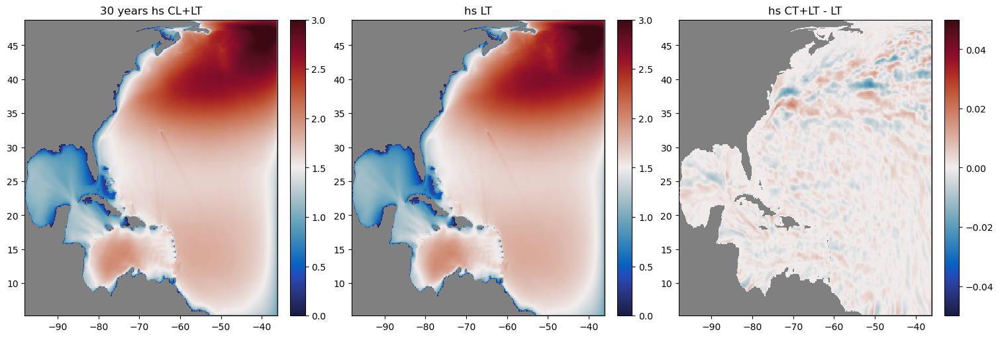

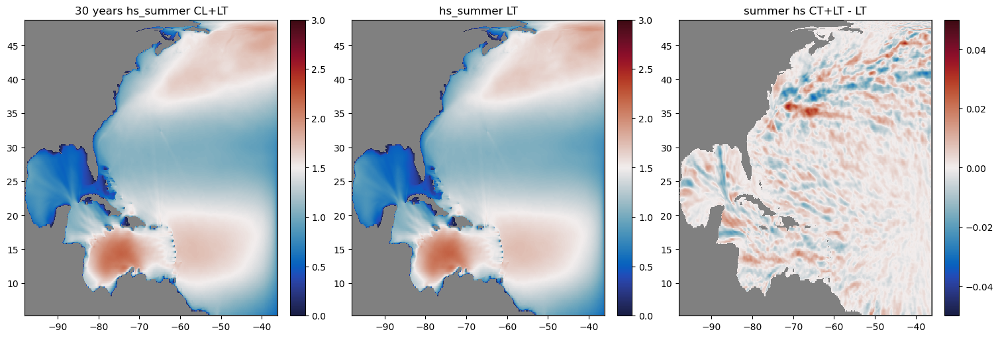

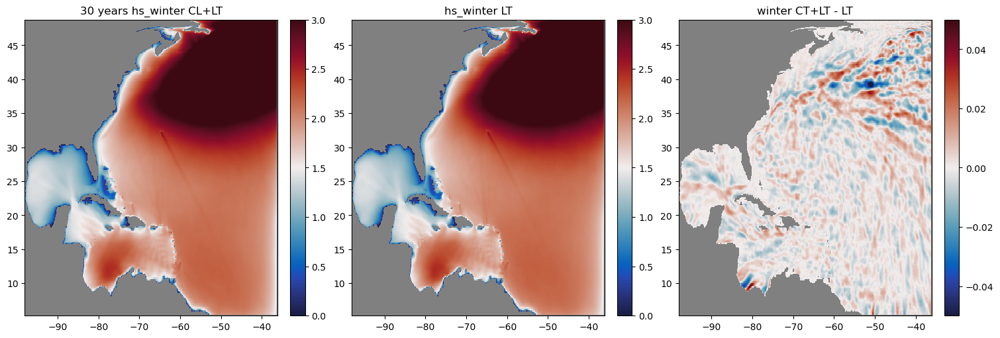

In [19]:
model_grid_x=model_grid_x_6
model_grid_y=model_grid_y_6

hs_6_all_ave=data_6_all['hs']
hs_winter_6_all_ave=W_data_6_all['hs']
hs_summer_6_all_ave=S_data_6_all['hs']

hs_6_wave_ave=data_6_wave['hs']
hs_winter_6_wave_ave=W_data_6_wave['hs']
hs_summer_6_wave_ave=S_data_6_wave['hs']


diff_hs_all_ave=hs_6_all_ave-hs_6_wave_ave

fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, hs_6_all_ave , cmap=cmap, shading='auto',vmin=0,vmax=3)
axes[0].set_title('30 years hs CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, hs_6_wave_ave, cmap=cmap, shading='auto',vmin=0,vmax=3)
axes[1].set_title('hs LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, diff_hs_all_ave, cmap=cmap, shading='auto',vmin=-0.05,vmax=0.05)
axes[2].set_title('hs CT+LT - LT')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()

diff_hs_summer_all_ave=hs_summer_6_all_ave-hs_summer_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, hs_summer_6_all_ave , cmap=cmap, shading='auto',vmin=0,vmax=3)
axes[0].set_title('30 years hs_summer CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, hs_summer_6_wave_ave, cmap=cmap, shading='auto',vmin=0,vmax=3)
axes[1].set_title('hs_summer LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, diff_hs_summer_all_ave, cmap=cmap, shading='auto',vmin=-0.05,vmax=0.05)
axes[2].set_title('summer hs CT+LT - LT')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()



diff_hs_winter_all_ave=hs_winter_6_all_ave-hs_winter_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, hs_winter_6_all_ave , cmap=cmap, shading='auto',vmin=0,vmax=3)
axes[0].set_title('30 years hs_winter CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, hs_winter_6_wave_ave, cmap=cmap, shading='auto',vmin=0,vmax=3)
axes[1].set_title('hs_winter LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, diff_hs_winter_all_ave, cmap=cmap, shading='auto',vmin=-0.05,vmax=0.05)
axes[2].set_title('winter CT+LT - LT')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()

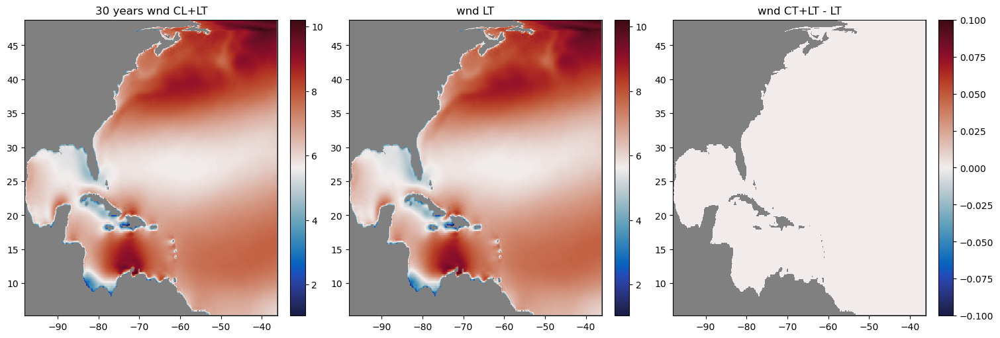

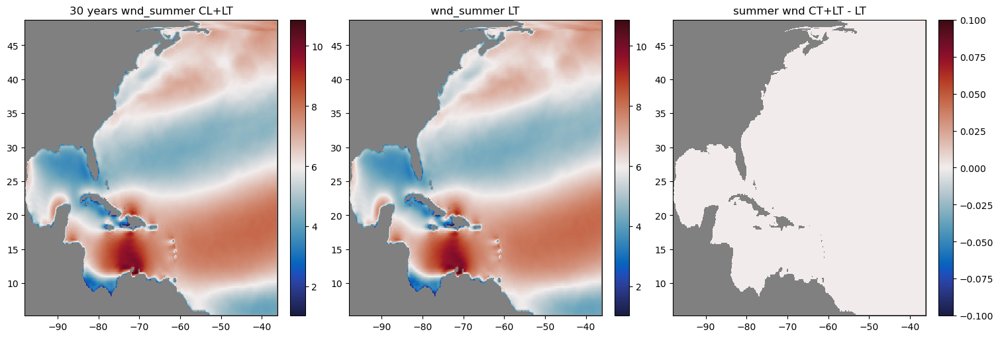

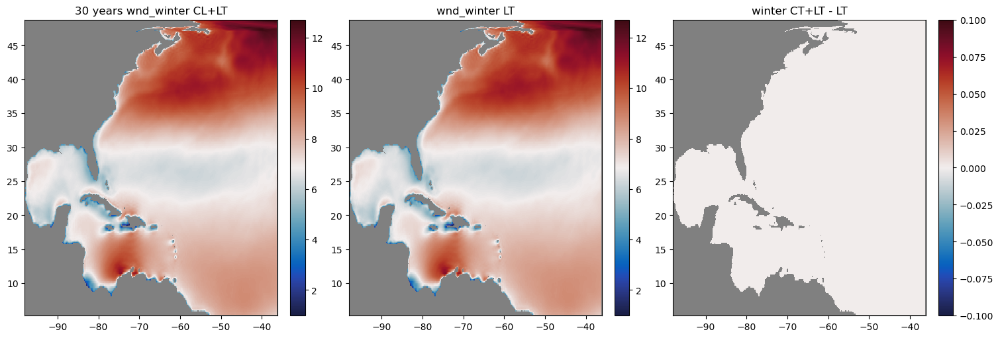

In [20]:
model_grid_x=model_grid_x_6
model_grid_y=model_grid_y_6

wnd_6_all_ave=data_6_all['wnd']
wnd_winter_6_all_ave=W_data_6_all['wnd']
wnd_summer_6_all_ave=S_data_6_all['wnd']

wnd_6_wave_ave=data_6_wave['wnd']
wnd_winter_6_wave_ave=W_data_6_wave['wnd']
wnd_summer_6_wave_ave=S_data_6_wave['wnd']


diff_wnd_all_ave=wnd_6_all_ave-wnd_6_wave_ave

fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, wnd_6_all_ave , cmap=cmap, shading='auto')
axes[0].set_title('30 years wnd CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, wnd_6_wave_ave, cmap=cmap, shading='auto')
axes[1].set_title('wnd LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, diff_wnd_all_ave, cmap=cmap, shading='auto')
axes[2].set_title('wnd CT+LT - LT')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()

diff_wnd_summer_all_ave=wnd_summer_6_all_ave-wnd_summer_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, wnd_summer_6_all_ave , cmap=cmap, shading='auto')
axes[0].set_title('30 years wnd_summer CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, wnd_summer_6_wave_ave, cmap=cmap, shading='auto')
axes[1].set_title('wnd_summer LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, diff_wnd_summer_all_ave, cmap=cmap, shading='auto')
axes[2].set_title('summer wnd CT+LT - LT')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()



diff_wnd_winter_all_ave=wnd_winter_6_all_ave-wnd_winter_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, wnd_winter_6_all_ave , cmap=cmap, shading='auto')
axes[0].set_title('30 years wnd_winter CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, wnd_winter_6_wave_ave, cmap=cmap, shading='auto')
axes[1].set_title('wnd_winter LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, diff_wnd_winter_all_ave, cmap=cmap, shading='auto')
axes[2].set_title('winter CT+LT - LT')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()

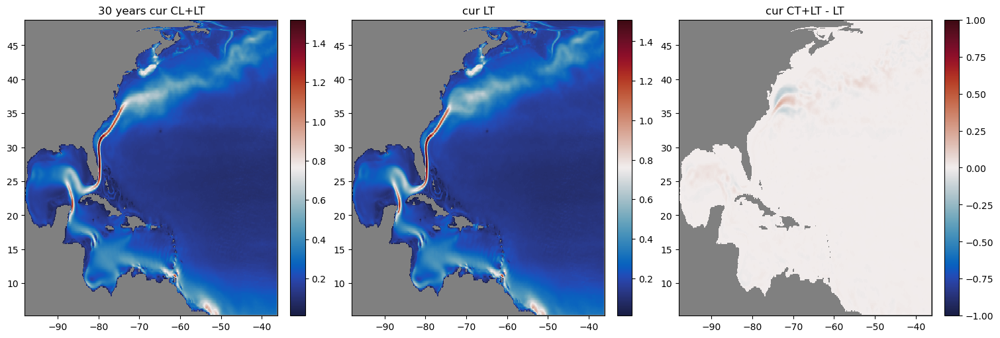

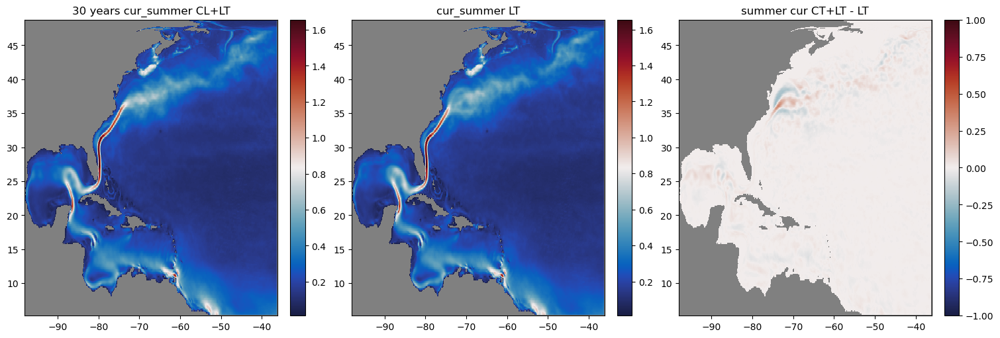

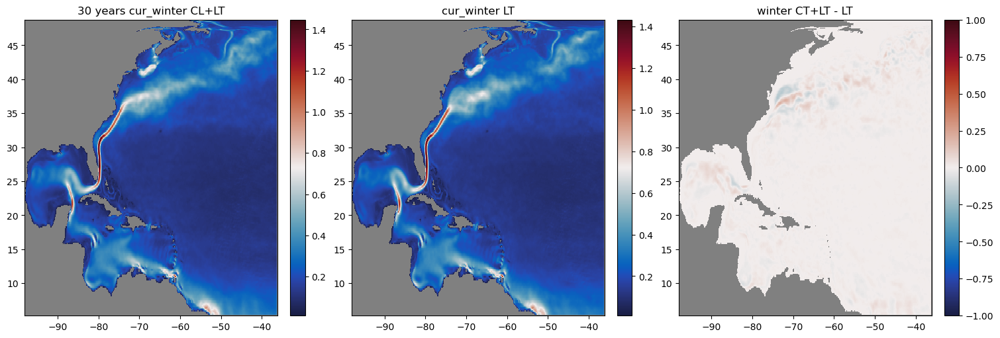

In [21]:
model_grid_x=model_grid_x_6
model_grid_y=model_grid_y_6

cur_6_all_ave=data_6_all['cur']
cur_winter_6_all_ave=W_data_6_all['cur']
cur_summer_6_all_ave=S_data_6_all['cur']

cur_6_wave_ave=data_6_wave['cur']
cur_winter_6_wave_ave=W_data_6_wave['cur']
cur_summer_6_wave_ave=S_data_6_wave['cur']


diff_cur_all_ave=cur_6_all_ave-cur_6_wave_ave

fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, cur_6_all_ave , cmap=cmap, shading='auto')
axes[0].set_title('30 years cur CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, cur_6_wave_ave, cmap=cmap, shading='auto')
axes[1].set_title('cur LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, diff_cur_all_ave, cmap=cmap, shading='auto',vmin=-1,vmax=1)
axes[2].set_title('cur CT+LT - LT')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()

diff_cur_summer_all_ave=cur_summer_6_all_ave-cur_summer_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, cur_summer_6_all_ave , cmap=cmap, shading='auto')
axes[0].set_title('30 years cur_summer CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, cur_summer_6_wave_ave, cmap=cmap, shading='auto')
axes[1].set_title('cur_summer LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, diff_cur_summer_all_ave, cmap=cmap, shading='auto',vmin=-1,vmax=1)
axes[2].set_title('summer cur CT+LT - LT')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()



diff_cur_winter_all_ave=cur_winter_6_all_ave-cur_winter_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, cur_winter_6_all_ave , cmap=cmap, shading='auto')
axes[0].set_title('30 years cur_winter CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, cur_winter_6_wave_ave, cmap=cmap, shading='auto')
axes[1].set_title('cur_winter LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, diff_cur_winter_all_ave, cmap=cmap, shading='auto',vmin=-1,vmax=1)
axes[2].set_title('winter CT+LT - LT')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()

In [17]:
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import AxesGrid
import xarray as xr
import os
import numpy as np
import logging
import cmocean
import copy

cmocean.cm.balance
cmap = copy.copy(cmocean.cm.balance)
cmap.set_bad('gray')   
###first verage every year and then concate

pp_root_uncou = "/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/"
pp_root_uncou_LAfalse="/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou_LALTFalse/"
pp_root_12_all="/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_wave_all/"
pp_root_12_wave="/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_wave/"
pp_root_6_all="/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/"
pp_root_6_wave="/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/"
def read_and_extract_data(pp_root, data_list, variables,x_coord,y_coord):
    combined_data = {}
    summer_data = {}
    winter_data = {}

    for var_name in variables:
        datasets = []
        summer_data_list = []
        winter_data_list = []

        for file_path in data_list:
            file_path = os.path.join(pp_root, file_path)
            if os.path.exists(file_path):
                try:
                    ds = xr.open_dataset(file_path)
                    if var_name in ds:
                        
                      
                        
                        wave_time = ds[var_name].sel(xh=x_coord, yh=y_coord, method="nearest")
                        exact_xh = wave_time.xh.values
                        exact_yh = wave_time.yh.values
                        datasets.append(wave_time)
                        
                        print(f"Exact xh: {exact_xh}, Exact yh: {exact_yh}")

                        # Summer: June, July, August (JJA)
                        summer = ds.sel(time=ds['time'].dt.month.isin([6, 7, 8]))
                        if not summer[var_name].isnull().all():
                            summer_mean = summer[var_name].sel(xh=x_coord, yh=y_coord, method="nearest")
                            exact_xh = summer_mean.xh.values
                            exact_yh = summer_mean.yh.values
                            print(f"Exact xh: {exact_xh}, Exact yh: {exact_yh}")
                            
                            summer_data_list.append(summer_mean)

                        # Winter: December, January, February (DJF)
                        winter = ds.sel(time=ds['time'].dt.month.isin([12, 1, 2]))
                        if not winter[var_name].isnull().all():
                            winter_mean=winter[var_name].sel(xh=x_coord, yh=y_coord, method="nearest")
                            exact_xh = winter_mean.xh.values
                            exact_yh = winter_mean.yh.values
                            print(f"Exact xh: {exact_xh}, Exact yh: {exact_yh}")
                            winter_data_list.append(winter_mean)

                    else:
                        print(f"Variable {var_name} not found in {file_path}")
                    ds.close()

                except Exception as e:
                    print(f"Error reading {file_path}: {e}")
            else:
                print(f"File not found: {file_path}")

        # Combine along time dimension after the loop finishes
        combined_data[var_name] = xr.concat(datasets, dim='time') if datasets else None
        summer_data[var_name] = xr.concat(summer_data_list, dim='time') if summer_data_list else None
        winter_data[var_name] = xr.concat(winter_data_list, dim='time') if winter_data_list else None

    return combined_data, summer_data, winter_data
def read_and_extract_data_multi(pp_root, data_list, variables, points):

    combined_data = {var: {} for var in variables}
    summer_data = {var: {} for var in variables}
    winter_data = {var: {} for var in variables}

    for var_name in variables:
        for point in points:
            x_coord, y_coord = point
            datasets = []
            summer_data_list = []
            winter_data_list = []

            for file_path in data_list:
                file_path = os.path.join(pp_root, file_path)
                if os.path.exists(file_path):
                    try:
                        ds = xr.open_dataset(file_path)
                        if var_name in ds:
                            
                            # Extract data at the nearest (xh, yh) to the given (x_coord, y_coord)
                            wave_time = ds[var_name].sel(xh=x_coord, yh=y_coord, method="nearest")
                            exact_xh = wave_time.xh.values
                            exact_yh = wave_time.yh.values
                            datasets.append(wave_time)
                            
                            print(f"Exact xh: {exact_xh}, Exact yh: {exact_yh}")
                       

                            # Summer: June, July, August (JJA)
                            summer = ds.sel(time=ds['time'].dt.month.isin([6, 7, 8]))
                            if not summer[var_name].isnull().all():
                                summer_mean = summer[var_name].sel(xh=x_coord, yh=y_coord, method="nearest")
                                summer_data_list.append(summer_mean)
                                exact_xh = summer_mean.xh.values
                                exact_yh = summer_mean.yh.values
                             
                            
                                print(f"summer Exact xh: {exact_xh}, Exact yh: {exact_yh}")

                            # Winter: December, January, February (DJF)
                            winter = ds.sel(time=ds['time'].dt.month.isin([12, 1, 2]))
                            if not winter[var_name].isnull().all():
                                winter_mean = winter[var_name].sel(xh=x_coord, yh=y_coord, method="nearest")
                                exact_xh = winter_mean.xh.values
                                exact_yh = winter_mean.yh.values
                                winter_data_list.append(winter_mean)
                                print(f"winter Exact xh: {exact_xh}, Exact yh: {exact_yh}")

                        else:
                            print(f"Variable {var_name} not found in {file_path}")
                        ds.close()

                    except Exception as e:
                        print(f"Error reading {file_path}: {e}")
                else:
                    print(f"File not found: {file_path}")

            # Store extracted data per point in a nested dictionary
            combined_data[var_name][point] = xr.concat(datasets, dim='time') if datasets else None
            summer_data[var_name][point] = xr.concat(summer_data_list, dim='time') if summer_data_list else None
            winter_data[var_name][point] = xr.concat(winter_data_list, dim='time') if winter_data_list else None

    return combined_data, summer_data, winter_data
Ddata_list = [
    '19930101_results/19930101.ocean_daily.nc',
    '19930701_results/19930701.ocean_daily.nc',
    '19940101_results/19940101.ocean_daily.nc',
    '19940701_results/19940701.ocean_daily.nc',
    '19950101_results/19950101.ocean_daily.nc',
    '19950701_results/19950701.ocean_daily.nc',
    '19960101_results/19960101.ocean_daily.nc',
    '19970101_results/19970101.ocean_daily.nc',
    '19980101_results/19980101.ocean_daily.nc',
    '19990101_results/19990101.ocean_daily.nc',
    '20000101_results/20000101.ocean_daily.nc',
    '20010101_results/20010101.ocean_daily.nc',
    '20020101_results/20020101.ocean_daily.nc',
    '20030101_results/20030101.ocean_daily.nc',
    '20040101_results/20040101.ocean_daily.nc',
    '20050101_results/20050101.ocean_daily.nc',
    '20060101_results/20060101.ocean_daily.nc',
    '20070101_results/20070101.ocean_daily.nc',
    '20080101_results/20080101.ocean_daily.nc',
    '20090101_results/20090101.ocean_daily.nc',
    '20100101_results/20100101.ocean_daily.nc',
    '20110101_results/20110101.ocean_daily.nc',
    '20120101_results/20120101.ocean_daily.nc',
    '20130101_results/20130101.ocean_daily.nc',
    '20140101_results/20140101.ocean_daily.nc',
    '20150101_results/20150101.ocean_daily.nc',
    '20160101_results/20160101.ocean_daily.nc',
    '20170101_results/20170101.ocean_daily.nc',
    '20180101_results/20180101.ocean_daily.nc',
    '20190101_results/20190101.ocean_daily.nc',
    '20200101_results/20200101.ocean_daily.nc',
    '20210101_results/20210101.ocean_daily.nc',
    '20220101_results/20220101.ocean_daily.nc',

]
Mdata_list = [
    '19930101_results/19930101.ocean_month.nc',
    '19930701_results/19930701.ocean_month.nc',
    '19940101_results/19940101.ocean_month.nc',
    '19940701_results/19940701.ocean_month.nc',
    '19950101_results/19950101.ocean_month.nc',
    '19950701_results/19950701.ocean_month.nc',
    '19960101_results/19960101.ocean_month.nc',
    '19970101_results/19970101.ocean_month.nc',
    '19980101_results/19980101.ocean_month.nc',
    '19990101_results/19990101.ocean_month.nc',
    '20000101_results/20000101.ocean_month.nc',
    '20010101_results/20010101.ocean_month.nc',
    '20020101_results/20020101.ocean_month.nc',
    '20030101_results/20030101.ocean_month.nc',
    '20040101_results/20040101.ocean_month.nc',
    '20050101_results/20050101.ocean_month.nc',
    '20060101_results/20060101.ocean_month.nc',
    '20070101_results/20070101.ocean_month.nc',
    '20080101_results/20080101.ocean_month.nc',
    '20090101_results/20090101.ocean_month.nc',
    '20100101_results/20100101.ocean_month.nc',
    '20110101_results/20110101.ocean_month.nc',
    '20120101_results/20120101.ocean_month.nc',
    '20130101_results/20130101.ocean_month.nc',
    '20140101_results/20140101.ocean_month.nc',
    '20150101_results/20150101.ocean_month.nc',
    '20160101_results/20160101.ocean_month.nc',
    '20170101_results/20170101.ocean_month.nc',
    '20180101_results/20180101.ocean_month.nc',
    '20190101_results/20190101.ocean_month.nc',
    '20200101_results/20200101.ocean_month.nc',
    '20210101_results/20210101.ocean_month.nc',
    '20220101_results/20220101.ocean_month.nc',

]
WMdata_list = [
    '19930101_results/19930101.ocean_month.nc',
    '19930701_results/19930701.ocean_month.nc',
    '19940101_results/19940101.ocean_month.nc',
    '19940701_results/19940701.ocean_month.nc',
    '19950101_results/19950101.ocean_month.nc',
    '19950701_results/19950701.ocean_month.nc',
    '19960101_results/19960101.ocean_month.nc',
    '19960701_results/19960701.ocean_month.nc',
    '19970101_results/19970101.ocean_month.nc',
    '19970701_results/19970701.ocean_month.nc',
    '19980101_results/19980101.ocean_month.nc',
    '19980701_results/19980701.ocean_month.nc',
    '19990101_results/19990101.ocean_month.nc',
    '19990701_results/19990701.ocean_month.nc',
    '20000101_results/20000101.ocean_month.nc',
    '20000701_results/20000701.ocean_month.nc',
    '20010101_results/20010101.ocean_month.nc',
    '20010701_results/20010701.ocean_month.nc',
    '20020101_results/20020101.ocean_month.nc',
    '20020701_results/20020701.ocean_month.nc',
    '20030101_results/20030101.ocean_month.nc',
    '20030701_results/20030701.ocean_month.nc',
    '20040101_results/20040101.ocean_month.nc',
    '20040701_results/20040701.ocean_month.nc',
    '20050101_results/20050101.ocean_month.nc',
    '20050701_results/20050701.ocean_month.nc',
    '20060101_results/20060101.ocean_month.nc',
    '20060701_results/20060701.ocean_month.nc',
    '20070101_results/20070101.ocean_month.nc',
    '20070701_results/20070701.ocean_month.nc',
    '20080101_results/20080101.ocean_month.nc',
    '20080701_results/20080701.ocean_month.nc',
    '20090101_results/20090101.ocean_month.nc',
    '20090701_results/20090701.ocean_month.nc',
    '20100101_results/20100101.ocean_month.nc',
    '20100701_results/20100701.ocean_month.nc',
    '20110101_results/20110101.ocean_month.nc',
    '20110701_results/20110701.ocean_month.nc',
    '20120101_results/20120101.ocean_month.nc',
    '20120701_results/20120701.ocean_month.nc',
    '20130101_results/20130101.ocean_month.nc',
    '20130701_results/20130701.ocean_month.nc',
    '20140101_results/20140101.ocean_month.nc',
    '20140701_results/20140701.ocean_month.nc',
    '20150101_results/20150101.ocean_month.nc',
    '20150701_results/20150701.ocean_month.nc',
    '20160101_results/20160101.ocean_month.nc',
    '20160701_results/20160701.ocean_month.nc',
    '20170101_results/20170101.ocean_month.nc',
    '20170701_results/20170701.ocean_month.nc',
    '20180101_results/20180101.ocean_month.nc',
    '20180701_results/20180701.ocean_month.nc',
    '20190101_results/20190101.ocean_month.nc',
    '20190701_results/20190701.ocean_month.nc',
    '20200101_results/20200101.ocean_month.nc',
    '20200701_results/20200701.ocean_month.nc',
    '20210101_results/20210101.ocean_month.nc',
    '20210701_results/20210701.ocean_month.nc',
    '20220101_results/20220101.ocean_month.nc',
    '20220701_results/20220701.ocean_month.nc',
]

WDdata_list = [
    '19930101_results/19930101.ocean_daily.nc',
    '19930701_results/19930701.ocean_daily.nc',
    '19940101_results/19940101.ocean_daily.nc',
    '19940701_results/19940701.ocean_daily.nc',
    '19950101_results/19950101.ocean_daily.nc',
    '19950701_results/19950701.ocean_daily.nc',
    '19960101_results/19960101.ocean_daily.nc',
    '19960701_results/19960701.ocean_daily.nc',
    '19970101_results/19970101.ocean_daily.nc',
    '19970701_results/19970701.ocean_daily.nc',
    '19980101_results/19980101.ocean_daily.nc',
    '19980701_results/19980701.ocean_daily.nc',
    '19990101_results/19990101.ocean_daily.nc',
    '19990701_results/19990701.ocean_daily.nc',
    '20000101_results/20000101.ocean_daily.nc',
    '20000701_results/20000701.ocean_daily.nc',
    '20010101_results/20010101.ocean_daily.nc',
    '20010701_results/20010701.ocean_daily.nc',
    '20020101_results/20020101.ocean_daily.nc',
    '20020701_results/20020701.ocean_daily.nc',
    '20030101_results/20030101.ocean_daily.nc',
    '20030701_results/20030701.ocean_daily.nc',
    '20040101_results/20040101.ocean_daily.nc',
    '20040701_results/20040701.ocean_daily.nc',
    '20050101_results/20050101.ocean_daily.nc',
    '20050701_results/20050701.ocean_daily.nc',
    '20060101_results/20060101.ocean_daily.nc',
    '20060701_results/20060701.ocean_daily.nc',
    '20070101_results/20070101.ocean_daily.nc',
    '20070701_results/20070701.ocean_daily.nc',
    '20080101_results/20080101.ocean_daily.nc',
    '20080701_results/20080701.ocean_daily.nc',
    '20090101_results/20090101.ocean_daily.nc',
    '20090701_results/20090701.ocean_daily.nc',
    '20100101_results/20100101.ocean_daily.nc',
    '20100701_results/20100701.ocean_daily.nc',
    '20110101_results/20110101.ocean_daily.nc',
    '20110701_results/20110701.ocean_daily.nc',
    '20120101_results/20120101.ocean_daily.nc',
    '20120701_results/20120701.ocean_daily.nc',
    '20130101_results/20130101.ocean_daily.nc',
    '20130701_results/20130701.ocean_daily.nc',
    '20140101_results/20140101.ocean_daily.nc',
    '20140701_results/20140701.ocean_daily.nc',
    '20150101_results/20150101.ocean_daily.nc',
    '20150701_results/20150701.ocean_daily.nc',
    '20160101_results/20160101.ocean_daily.nc',
    '20160701_results/20160701.ocean_daily.nc',
    '20170101_results/20170101.ocean_daily.nc',
    '20170701_results/20170701.ocean_daily.nc',
    '20180101_results/20180101.ocean_daily.nc',
    '20180701_results/20180701.ocean_daily.nc',
    '20190101_results/20190101.ocean_daily.nc',
    '20190701_results/20190701.ocean_daily.nc',
    '20200101_results/20200101.ocean_daily.nc',
    '20200701_results/20200701.ocean_daily.nc',
    '20210101_results/20210101.ocean_daily.nc',
    '20210701_results/20210701.ocean_daily.nc',
    '20220101_results/20220101.ocean_daily.nc',
    '20220701_results/20220701.ocean_daily.nc',
]

# variables_month = ['ssh','speed','MLD_EN1','LA','LA_MOD','MSTAR_LT','La_turbulent','surface_stokes_x','surface_stokes_y']
variables_daily = ['SST','MLD_EN1']
# points = [(-45, 10), (-52, 26), (-53, 35)]
points = [(-45, 10)]
Dcombined_data_uncou, Dsummer_data_uncou, Dwinter_data_uncou = read_and_extract_data_multi(pp_root_uncou, Ddata_list, variables_daily,points)

Dcombined_data_6_wave, Dsummer_data_6_wave, Dwinter_data_6_wave = read_and_extract_data_multi(pp_root_6_wave, WDdata_list, variables_daily,points)

Dcombined_data_6_all, Dsummer_data_6_all, Dwinter_data_6_all = read_and_extract_data_multi(pp_root_6_all, WDdata_list, variables_daily,points)

ocean_daily_uncou_1= xr.open_dataset(pp_root_uncou+"/19930101_results/19930101.ocean_daily.nc")
model_grid_x = ocean_daily_uncou_1.variables['xh']
model_grid_y = ocean_daily_uncou_1.variables['yh']





/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:98: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset(file_path)


Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
summer Exact xh: -44.959991455078125, Exact yh: 10.028401374816895
winter Exact xh: -44.959991455078125, Exact yh: 10.028401374816895


/vftmp/Qian.Xiao/pid404689/ipykernel_556611/1438512955.py:353: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ocean_daily_uncou_1= xr.open_dataset(pp_root_uncou+"/19930101_results/19930101.ocean_daily.nc")


In [30]:
mean=np.zeros((6,3))

mean[0,:]=[Dcombined_data_6_all['SST'][(-45, 10)].mean(dim='time', skipna=True),Dcombined_data_6_wave['SST'][(-45, 10)].mean(dim='time', skipna=True),Dcombined_data_uncou['SST'][(-45, 10)].mean(dim='time', skipna=True)]
mean[1,:]=[Dcombined_data_6_all['MLD_EN1'][(-45, 10)].mean(dim='time', skipna=True),Dcombined_data_6_wave['MLD_EN1'][(-45, 10)].mean(dim='time', skipna=True),Dcombined_data_uncou['MLD_EN1'][(-45, 10)].mean(dim='time', skipna=True)]
mean[2,:]=[Dsummer_data_6_all['SST'][(-45, 10)].mean(dim='time', skipna=True),Dsummer_data_6_wave['SST'][(-45, 10)].mean(dim='time', skipna=True),Dsummer_data_uncou['SST'][(-45, 10)].mean(dim='time', skipna=True)]
mean[3,:]=[Dsummer_data_6_all['MLD_EN1'][(-45, 10)].mean(dim='time', skipna=True),Dsummer_data_6_wave['MLD_EN1'][(-45, 10)].mean(dim='time', skipna=True),Dsummer_data_uncou['MLD_EN1'][(-45, 10)].mean(dim='time', skipna=True)]
mean[4,:]=[Dwinter_data_6_all['SST'][(-45, 10)].mean(dim='time', skipna=True),Dwinter_data_6_wave['SST'][(-45, 10)].mean(dim='time', skipna=True),Dwinter_data_uncou['SST'][(-45, 10)].mean(dim='time', skipna=True)]
mean[5,:]=[Dwinter_data_6_all['MLD_EN1'][(-45, 10)].mean(dim='time', skipna=True),Dwinter_data_6_wave['MLD_EN1'][(-45, 10)].mean(dim='time', skipna=True),Dwinter_data_uncou['MLD_EN1'][(-45, 10)].mean(dim='time', skipna=True)]
print(mean)
print(mean[:,1]-mean[:,2])



ValueError: 'time' not found in array dimensions ('xh',)